#DCASE2020 data download

In [1]:
import tarfile, shutil
import zipfile
import sys, os, urllib.request, tarfile, glob
import numpy as np
import cv2
import librosa
import librosa.core
import librosa.feature
import librosa.display 
import matplotlib.pyplot as plt
import random
from utils import *
from data_utils import *
from train_utils import *

In [2]:
import os
import pandas as pd
import soundfile as sf 

In [3]:
import tensorflow as tf

In [4]:
print(tf.version.VERSION)

2.2.0


In [6]:
from tensorflow import keras
#import keras
from tensorflow.keras import layers
#from keras import layers
import numpy as np
import datetime as dt
import os
import random

In [7]:
import pathlib
import matplotlib.pyplot as plt
import IPython.display as display
from PIL import Image

In [8]:
import sklearn
from sklearn.metrics import confusion_matrix
import tempfile
import matplotlib as mpl
import pandas as pd

In [9]:
downstream_task = True
evaluate_downstream = True

In [10]:
import logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

In [12]:
folder_train_bonafide = './data/train/bonafide'
folder_train_spoofed = './data/train/spoof'
folder_eval_bonafide = './data/eval/bonafide'
folder_eval_spoofed = './data/eval/spoof'

In [18]:
BATCH_SIZE = 64
IMG_WIDTH = 224
IMG_HEIGHT = 224

In [19]:
seed = 42
np.random.seed(seed)
random.seed(seed)
tf.random.set_seed(seed)

In [36]:
models_storage_directory = "./ASVSpoof2019/models"
results_storage_directory = "./ASVSpoof2019/results"

In [38]:
BATCH_SIZE_DOWNSTREAM = 64

In [39]:
initial_learning_rate = 0.001

In [40]:
models_names = ["VGG16", "waveletCNN"]

In [41]:
features_type='HPSS_decompose_audio' #
Augmentation_type='No'+'Augmentation'
label_smoothing=False
mixup=False
alpha_mixup=1 # [0.4, 0.8, 1.0, 1.4]
attack_mixup=False
alpha_attackMixup=1 # [0.4, 0.8, 1.0, 1.4]
is_dropout=True
is_gaussian_noise=False # [True, False]
is_l1=True #False # [True, False]
dropout_value=0.3  # [0.2, 0.3, 0.4]
model_type= models_names[1]

In [42]:
if features_type in ['fbanks_delta_doubledelta', 'HPSS_power', 'HPSS_stft', 'HPSS_llfb', 'HPSS_decompose_audio', 'HPSS_llfb_doubledelta']:
    num_channels = 3
    EPOCHS_DOWNSTREAM = 1200
else:
    num_channels = 1
    EPOCHS_DOWNSTREAM = 500
    
model_architecture_features = model_type + "_" + Augmentation_type + "_" + str(mixup) + "mixup_" + str(attack_mixup) + "attackMixup_" + str(label_smoothing) + "labelSmooth_" + features_type + "_" + str(EPOCHS_DOWNSTREAM) + "epochs_" + str(BATCH_SIZE_DOWNSTREAM) + "bachSize_" + str(alpha_attackMixup).replace(".", "p") + "alphaAttackMixup_" + str(alpha_mixup).replace(".", "p") + "alphaMixup_" + str(is_dropout) + "isDropout_" + str(is_gaussian_noise) + "isNoise_" + str(is_l1) + "isL1_" + str(dropout_value).replace(".", "p") + "dropVal" + "_freeze"
print(model_architecture_features)

waveletCNN_NoAugmentation_Falsemixup_FalseattackMixup_FalselabelSmooth_HPSS_decompose_audio_1200epochs_64bachSize_1alphaAttackMixup_1alphaMixup_TrueisDropout_FalseisNoise_TrueisL1_0p3dropVal_freeze


In [44]:
if downstream_task or evaluate_downstream:
    folder_train_bonafide = './data/train/bonafide/'
    
    #Bonafide data
    x_train_normal = make_data(folder_train_bonafide + "/*")

    x_train_normal = to_img(x_train_normal, features=features_type)

    max_ = np.max(x_train_normal)
    min_ = np.min(x_train_normal)
    print("#min, max: ", min_, max_)

    x_train_normal = (x_train_normal-min_)/(max_-min_)

    mean = np.mean(x_train_normal)
    sigma = np.std(x_train_normal)
    print("#mean, sigma: ", mean, sigma)

    x_train_normal = (x_train_normal*255-mean)/sigma

    if features_type not in ['fbanks_delta_doubledelta', 'HPSS_power', 'HPSS_stft', 'HPSS_llfb', 'HPSS_decompose_audio', 'HPSS_llfb_doubledelta']:
        x_train_normal = np.expand_dims(x_train_normal, axis=-1)
    print("#x_train_normal.shape: ", x_train_normal.shape)

/lu/fast_scratch/patx/fathanab/project_sept2020/ASVAntiSpoofing/data_utils.py:123: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return np.array(result)


#min, max:  -15.435553 5.233303
#mean, sigma:  0.6109934 0.11567908
#x_train_normal.shape:  (2580, 224, 224, 3)


In [82]:
min_, max_ =  -15.435553, 5.233303
mean, sigma =  0.6109934, 0.11567908
if downstream_task or evaluate_downstream:
    folder_train_bonafide = './data/train/bonafide/'
    
    #Bonafide data
    x_train_normal = make_data(folder_train_bonafide + "/*")[:400]
    all_names_files = glob.glob(folder_train_bonafide + "/*")
    print(all_names_files[:20])

    x_train_normal = to_img(x_train_normal, features=features_type)

    print("#min, max: ", min_, max_)

    x_train_normal = (x_train_normal-min_)/(max_-min_)

    print("#mean, sigma: ", mean, sigma)

    x_train_normal = (x_train_normal*255-mean)/sigma

    if features_type not in ['fbanks_delta_doubledelta', 'HPSS_power', 'HPSS_stft', 'HPSS_llfb', 'HPSS_decompose_audio', 'HPSS_llfb_doubledelta']:
        x_train_normal = np.expand_dims(x_train_normal, axis=-1)
    
    print("#x_train_normal.shape: ", x_train_normal.shape)

['./data/train/bonafide/LA_T_6069460.flac', './data/train/bonafide/LA_T_7988057.flac', './data/train/bonafide/LA_T_5786461.flac', './data/train/bonafide/LA_T_8914289.flac', './data/train/bonafide/LA_T_4050802.flac', './data/train/bonafide/LA_T_3354987.flac', './data/train/bonafide/LA_T_1429555.flac', './data/train/bonafide/LA_T_9763074.flac', './data/train/bonafide/LA_T_6992885.flac', './data/train/bonafide/LA_T_1698724.flac', './data/train/bonafide/LA_T_5249142.flac', './data/train/bonafide/LA_T_1007663.flac', './data/train/bonafide/LA_T_1897758.flac', './data/train/bonafide/LA_T_5572362.flac', './data/train/bonafide/LA_T_9110555.flac', './data/train/bonafide/LA_T_9919874.flac', './data/train/bonafide/LA_T_4707993.flac', './data/train/bonafide/LA_T_4926626.flac', './data/train/bonafide/LA_T_2550088.flac', './data/train/bonafide/LA_T_9713701.flac']
#min, max:  -15.435553 5.233303
#mean, sigma:  0.6109934 0.11567908
#x_train_normal.shape:  (400, 224, 224, 3)


In [83]:
if downstream_task:
    
    #Spoof data
    x_train_anomaly = make_data(folder_train_spoofed + "/*")[:400]
    
    all_names_files = glob.glob(folder_train_spoofed + "/*")
    print(all_names_files[:20])

    x_train_anomaly = to_img(x_train_anomaly, features=features_type)

    x_train_anomaly = (x_train_anomaly-min_)/(max_-min_)

    x_train_anomaly = (x_train_anomaly*255-mean)/sigma

    if features_type not in ['fbanks_delta_doubledelta', 'HPSS_power', 'HPSS_stft', 'HPSS_llfb', 'HPSS_decompose_audio', 'HPSS_llfb_doubledelta']:
        x_train_anomaly = np.expand_dims(x_train_anomaly, axis=-1)
    
    print("#x_train_anomaly.shape: ", x_train_anomaly.shape)

['./data/train/spoof/LA_T_3119684.flac', './data/train/spoof/LA_T_5423204.flac', './data/train/spoof/LA_T_9771785.flac', './data/train/spoof/LA_T_1202533.flac', './data/train/spoof/LA_T_5350557.flac', './data/train/spoof/LA_T_8880821.flac', './data/train/spoof/LA_T_5742467.flac', './data/train/spoof/LA_T_5830377.flac', './data/train/spoof/LA_T_1103401.flac', './data/train/spoof/LA_T_4966875.flac', './data/train/spoof/LA_T_4635350.flac', './data/train/spoof/LA_T_7334637.flac', './data/train/spoof/LA_T_5201273.flac', './data/train/spoof/LA_T_2392597.flac', './data/train/spoof/LA_T_8300078.flac', './data/train/spoof/LA_T_7336702.flac', './data/train/spoof/LA_T_8542596.flac', './data/train/spoof/LA_T_1894311.flac', './data/train/spoof/LA_T_9944298.flac', './data/train/spoof/LA_T_4448884.flac']
#x_train_anomaly.shape:  (400, 224, 224, 3)


In [46]:
model_path_downstream = "savedModel_" + str(EPOCHS_DOWNSTREAM) + "_" + str(BATCH_SIZE_DOWNSTREAM) + "_" + model_architecture_features + "/"
model_path_downstream = os.path.join(models_storage_directory, model_path_downstream)
if not os.path.exists(model_path_downstream):
    os.makedirs(model_path_downstream)
print(model_path_downstream)

/misc/scratch09/PATR/fathanab/ASVSpoof2019/models/savedModel_1200_64_waveletCNN_NoAugmentation_Falsemixup_FalseattackMixup_FalselabelSmooth_HPSS_decompose_audio_1200epochs_64bachSize_1alphaAttackMixup_1alphaMixup_TrueisDropout_FalseisNoise_TrueisL1_0p3dropVal_freeze/


In [47]:
from models_utils import *

    def create_model():

        if model_type == "VGG16":
            return create_model_VGG16_custom_3_l1Reg_noise_dropout(IMG_WIDTH, IMG_HEIGHT, optimizer='Adam', embedding_dim=512, num_channels=num_channels, is_dropout=is_dropout, is_gaussian_noise=is_gaussian_noise, is_l1=is_l1, dropout_value=dropout_value)
        elif model_type == "waveletCNN":
            return create_model_wavelet_cnn_l1Reg_noise_dropout(IMG_WIDTH, IMG_HEIGHT, optimizer='Adam', embedding_dim=512, num_channels=num_channels, wavelet_transform=True, is_gaussian_noise=is_gaussian_noise, is_l1=is_l1, dropout_value=dropout_value)

    # Create a model instance
    v2 = create_model()
    v2.summary()

2022-03-18 11:45:07.506836: W tensorflow/stream_executor/platform/default/dso_loader.cc:55] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /lu/bf_scratch/patx/fathanab/sharedAnaconda/anaconda3/envs/tfenv2latest/lib/python3.8/site-packages/cv2/../../lib64:
2022-03-18 11:45:07.508619: E tensorflow/stream_executor/cuda/cuda_driver.cc:313] failed call to cuInit: UNKNOWN ERROR (303)
2022-03-18 11:45:07.510356: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (sg-slurm-ln1.corpo.crim.ca): /proc/driver/nvidia/version does not exist
2022-03-18 11:45:07.537946: I tensorflow/core/platform/cpu_feature_guard.cc:143] Your CPU supports instructions that this TensorFlow binary was not compiled to use: SSE4.1 SSE4.2 AVX AVX2 FMA
2022-03-18 11:45:07.618336: I tensorflow/core/platform/profile_utils/cpu_utils.cc:102] CPU Frequency: 259999500

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
the_input (InputLayer)          [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
wavelet (Lambda)                [(None, 112, 112, 12 0           the_input[0][0]                  
__________________________________________________________________________________________________
conv_1 (Conv2D)                 (None, 112, 112, 64) 6976        wavelet[0][0]                    
__________________________________________________________________________________________________
norm_1 (BatchNormalization)     (None, 112, 112, 64) 256         conv_1[0][0]                     
______________________________________________________________________________________________

2022-03-18 11:45:09.182270: W tensorflow/core/framework/cpu_allocator_impl.cc:81] Allocation of 51380224 exceeds 10% of free system memory.
2022-03-18 11:45:09.226174: W tensorflow/core/framework/cpu_allocator_impl.cc:81] Allocation of 51380224 exceeds 10% of free system memory.
2022-03-18 11:45:09.230279: W tensorflow/core/framework/cpu_allocator_impl.cc:81] Allocation of 51380224 exceeds 10% of free system memory.


In [48]:
if downstream_task:
    v2 = create_model_AM_logits(v2)
    v2.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
the_input (InputLayer)          [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
wavelet (Lambda)                [(None, 112, 112, 12 0           the_input[0][0]                  
__________________________________________________________________________________________________
conv_1 (Conv2D)                 (None, 112, 112, 64) 6976        wavelet[0][0]                    
__________________________________________________________________________________________________
norm_1 (BatchNormalization)     (None, 112, 112, 64) 256         conv_1[0][0]                     
____________________________________________________________________________________________

In [49]:
#Load model
if evaluate_downstream:
    model = tf.keras.models.load_model(model_path_downstream)
    # Check its architecture
    model.summary()

2022-03-18 11:45:28.730431: W tensorflow/core/framework/cpu_allocator_impl.cc:81] Allocation of 51380224 exceeds 10% of free system memory.
2022-03-18 11:45:28.773948: W tensorflow/core/framework/cpu_allocator_impl.cc:81] Allocation of 51380224 exceeds 10% of free system memory.


Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
the_input (InputLayer)          [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
wavelet (Lambda)                [(None, 112, 112, 12 0           the_input[0][0]                  
__________________________________________________________________________________________________
conv_1 (Conv2D)                 (None, 112, 112, 64) 6976        wavelet[0][0]                    
__________________________________________________________________________________________________
norm_1 (BatchNormalization)     (None, 112, 112, 64) 256         conv_1[0][0]                     
____________________________________________________________________________________________

In [50]:
x_train_normal.shape

(20, 224, 224, 3)

In [52]:
########## Plot feature maps

layer_outputs = []
for idx, layer in enumerate(model.layers): #[2:]:
    if isinstance(layer, keras.layers.Conv2D): # or isinstance(layer, keras.layers.Dense):
        layer_outputs.append(layer.output)
print(len(layer_outputs))
            
activation_model = Model(inputs=model.input, outputs=layer_outputs) # Creates a model that will return these outputs, given the model input


15


In [53]:
layer_names = []
for idx, layer in enumerate(model.layers): #[2:]:
    if isinstance(layer, keras.layers.Conv2D): # or isinstance(layer, keras.layers.Dense):
        layer_names.append(layer.name)
print(len(layer_names))

15


In [89]:
#bonafide file
img_tensor = x_train_normal[:1]
activations = activation_model.predict(img_tensor) # Returns a list of five Numpy arrays: one array per layer activation

In [90]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 112, 112, 64)


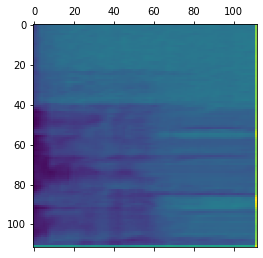

In [91]:
plt.matshow(first_layer_activation[0, :, :, 4], cmap='viridis')

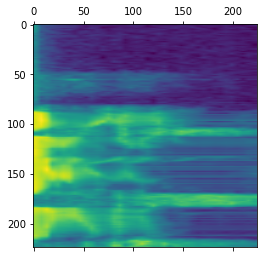

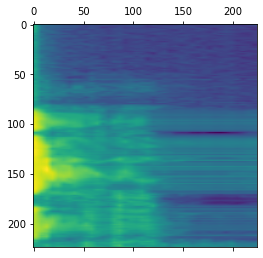

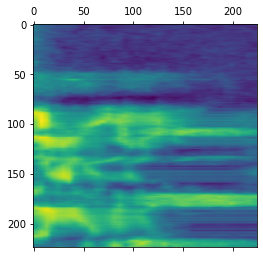

In [95]:
for i in range(img_tensor.shape[-1]):
    plt.matshow(img_tensor[0, :, :, i], aspect='auto', cmap='viridis')

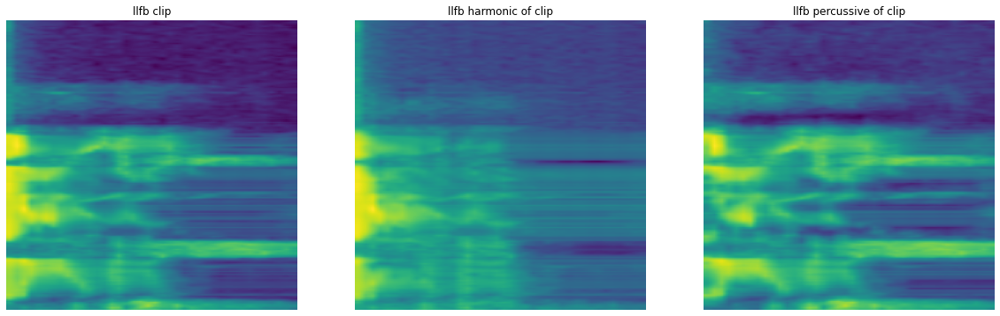

In [97]:
plt.figure(figsize=(20,20))

plt.subplot(1,3,1)
plt.axis("off")
plt.title("Input llfb clip")
plt.imshow(img_tensor[0, :, :, 0])

plt.subplot(1,3,2)
plt.axis("off")
plt.title("Input llfb harmonic of clip")
plt.imshow(img_tensor[0, :, :, 1])

plt.subplot(1,3,3)
plt.axis("off")
plt.title("Input llfb percussive of clip")
plt.imshow(img_tensor[0, :, :, 2])

plt.show()

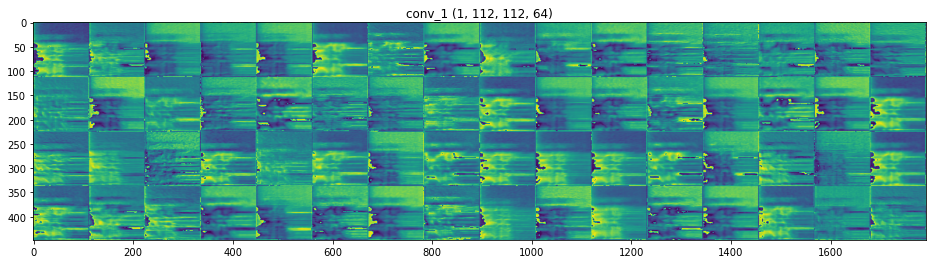

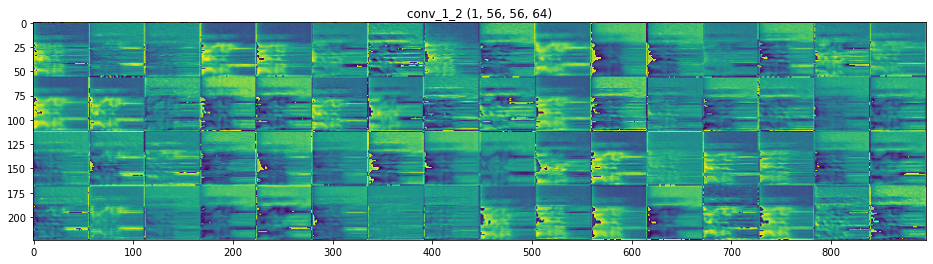

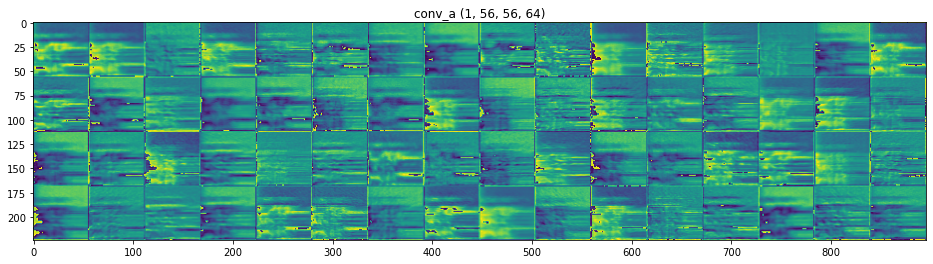

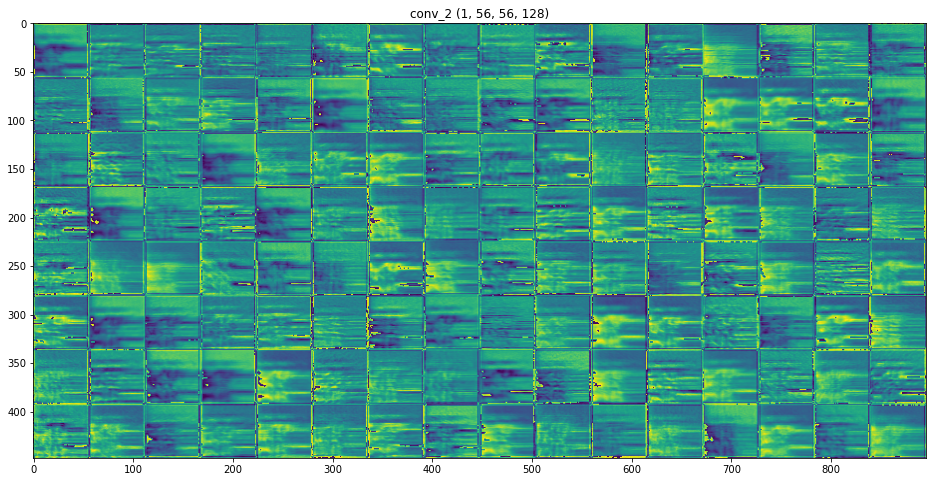

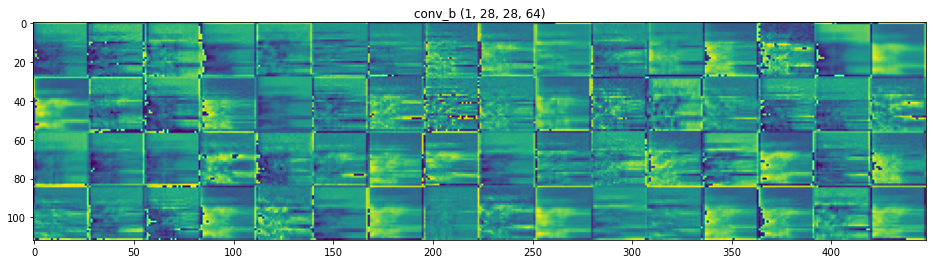

...

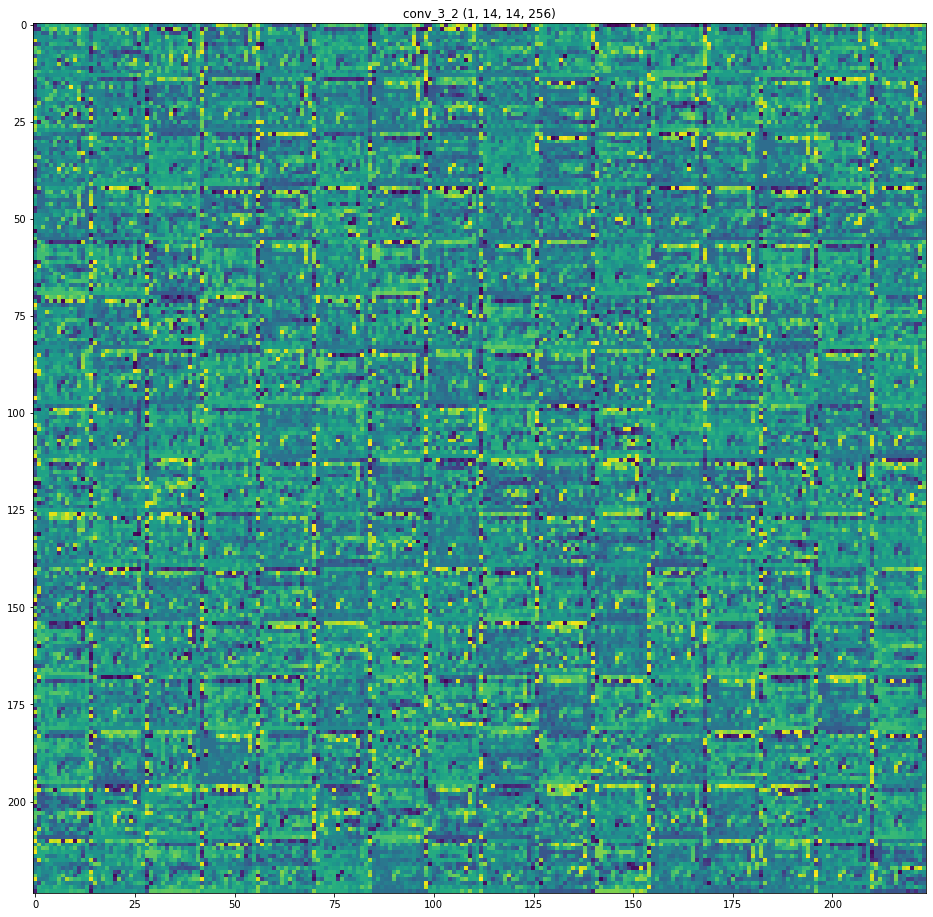

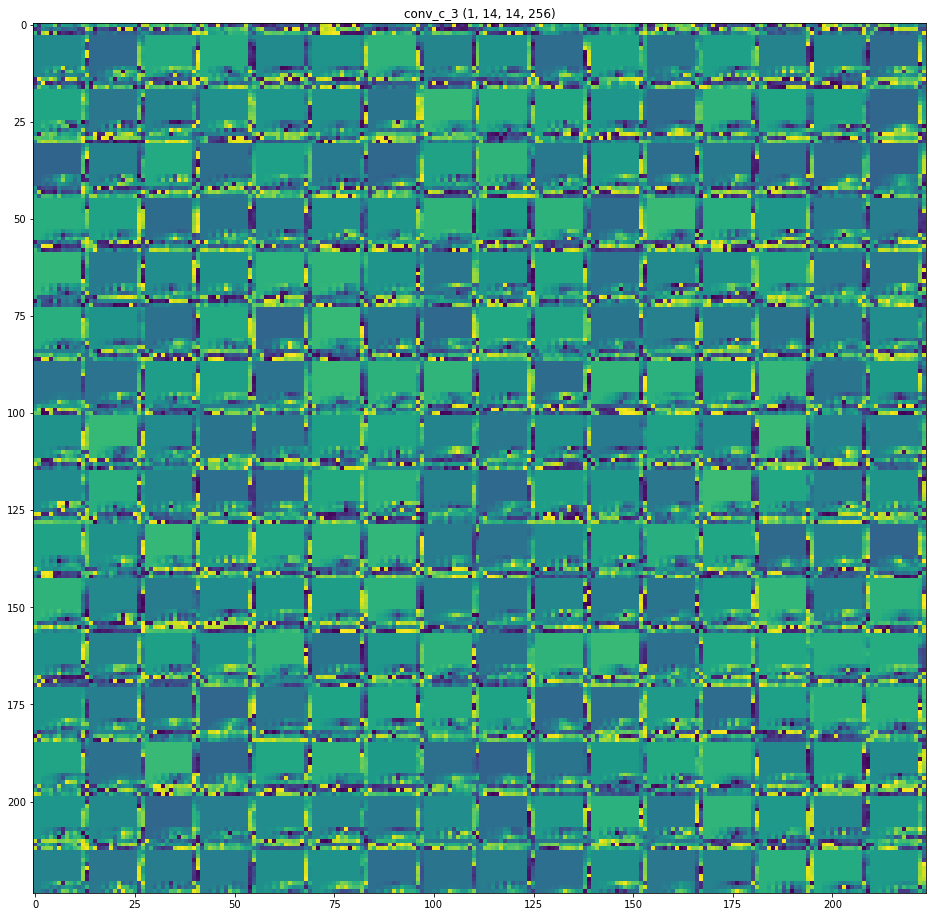

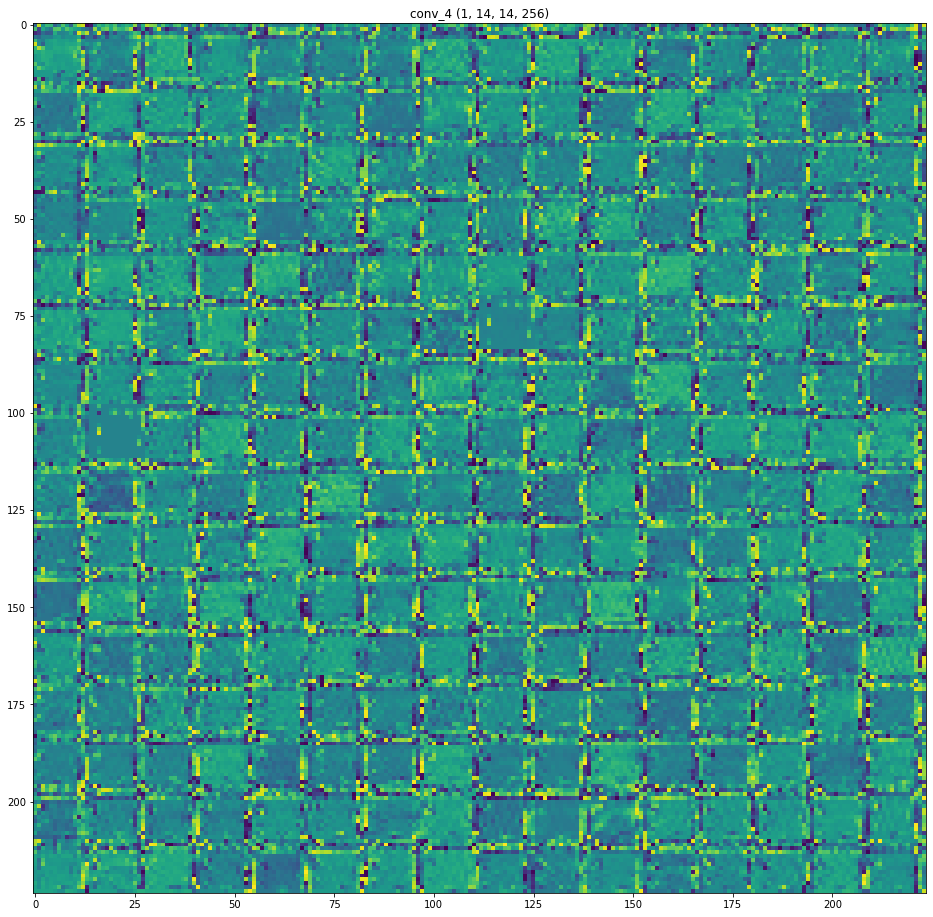

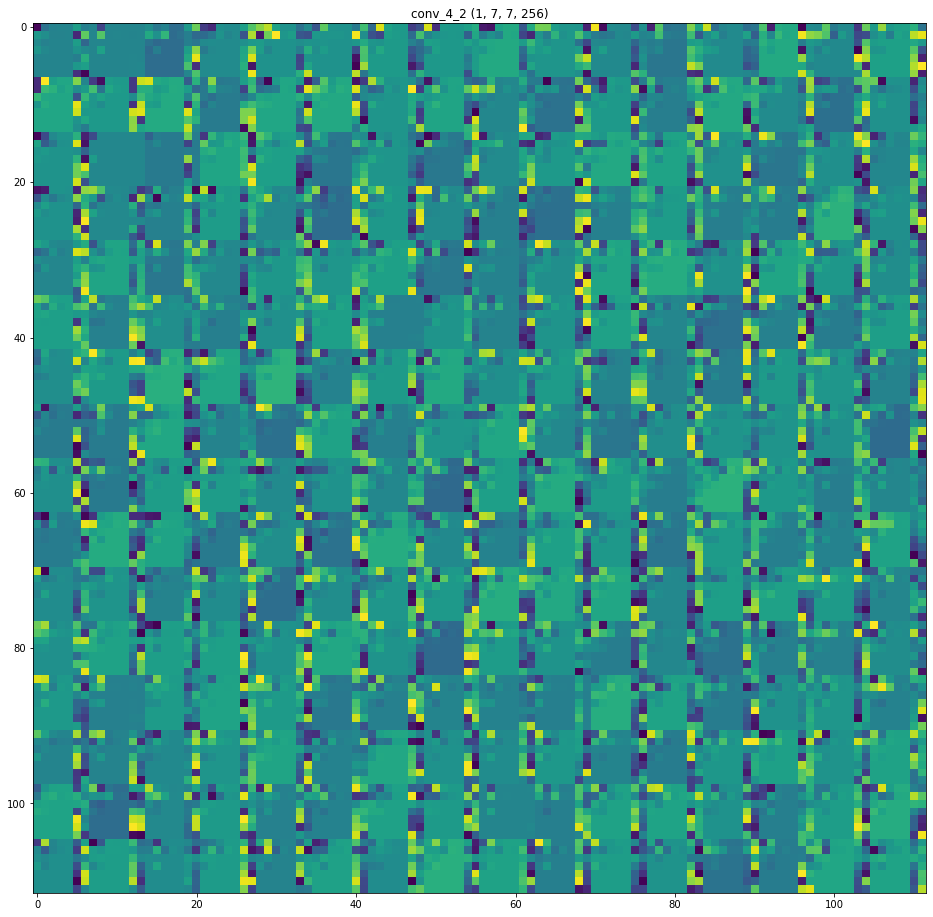

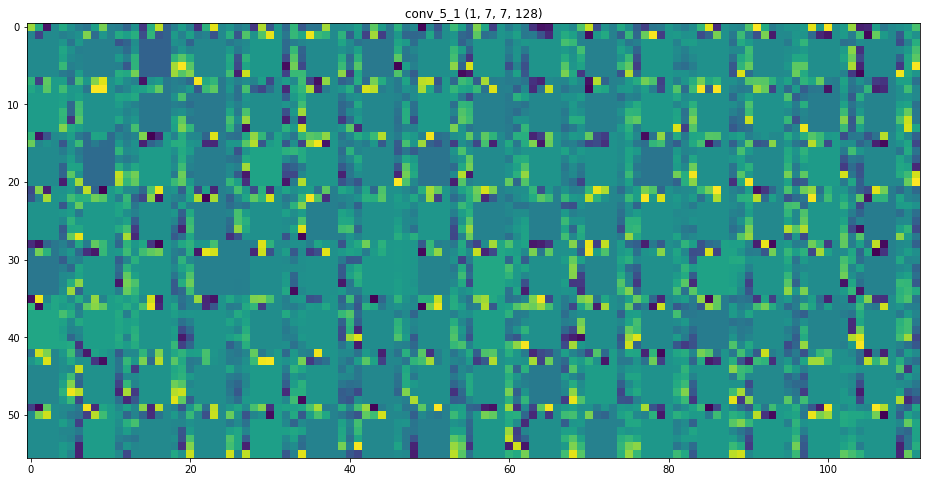

In [94]:
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations): # Displays the feature maps
    n_features = layer_activation.shape[-1] # Number of features in the feature map
    size = layer_activation.shape[1] #The feature map has shape (1, size, size, n_features).
    n_cols = n_features // images_per_row # Tiles the activation channels in this matrix
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols): # Tiles each filter into a big horizontal grid
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :,col * images_per_row + row]
            channel_image = np.array(channel_image).astype('uint8')
            display_grid[col * size : (col + 1) * size, # Displays the grid
                         row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name + " " + str(layer_activation.shape))
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

### Spoof data

In [80]:
img_tensor = x_train_anomaly[:1] #x_train_normal[:1]
activations = activation_model.predict(img_tensor) # Returns a list of five Numpy arrays: one array per layer activation

In [81]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 112, 112, 64)


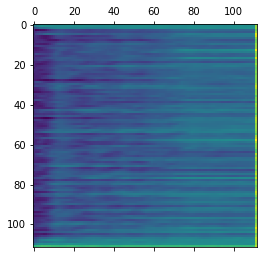

In [83]:
plt.matshow(first_layer_activation[0, :, :, 4], cmap='viridis')

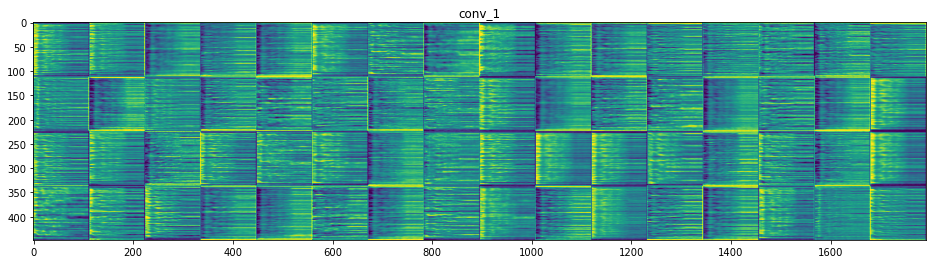

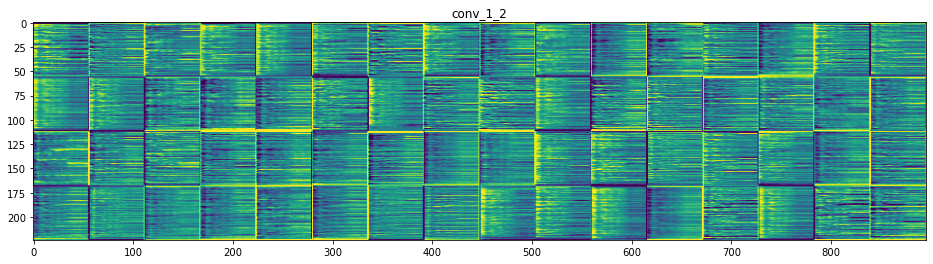

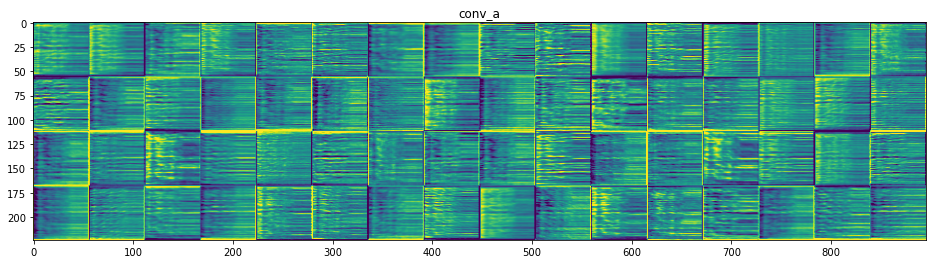

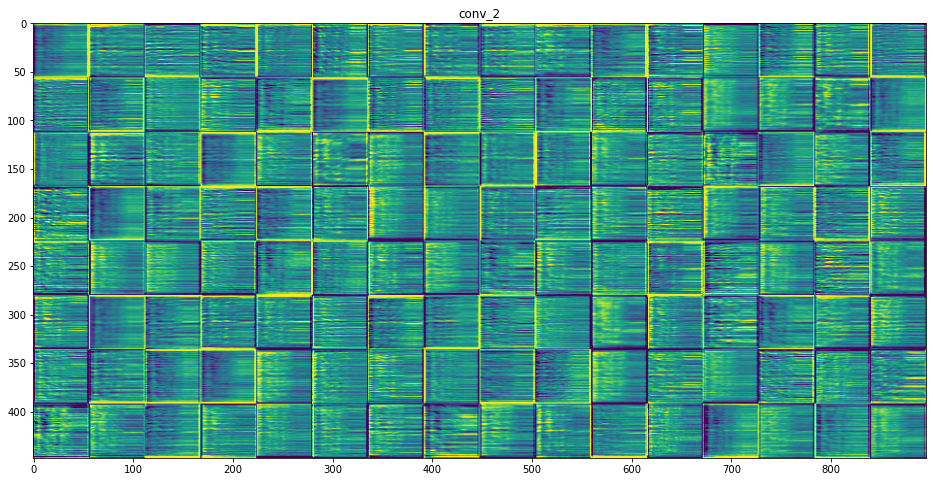

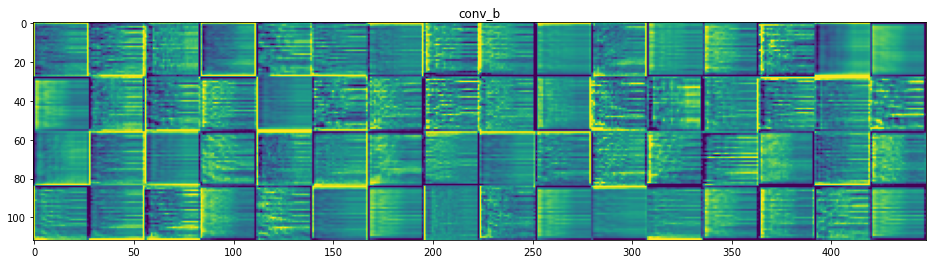

...

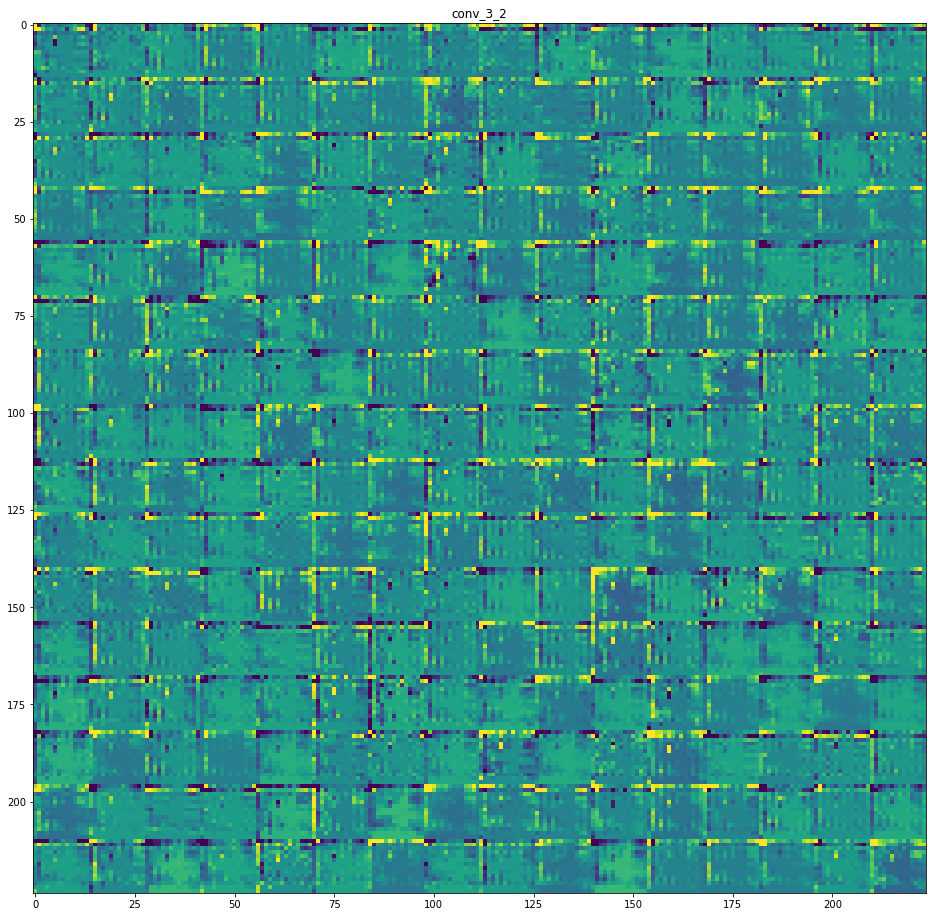

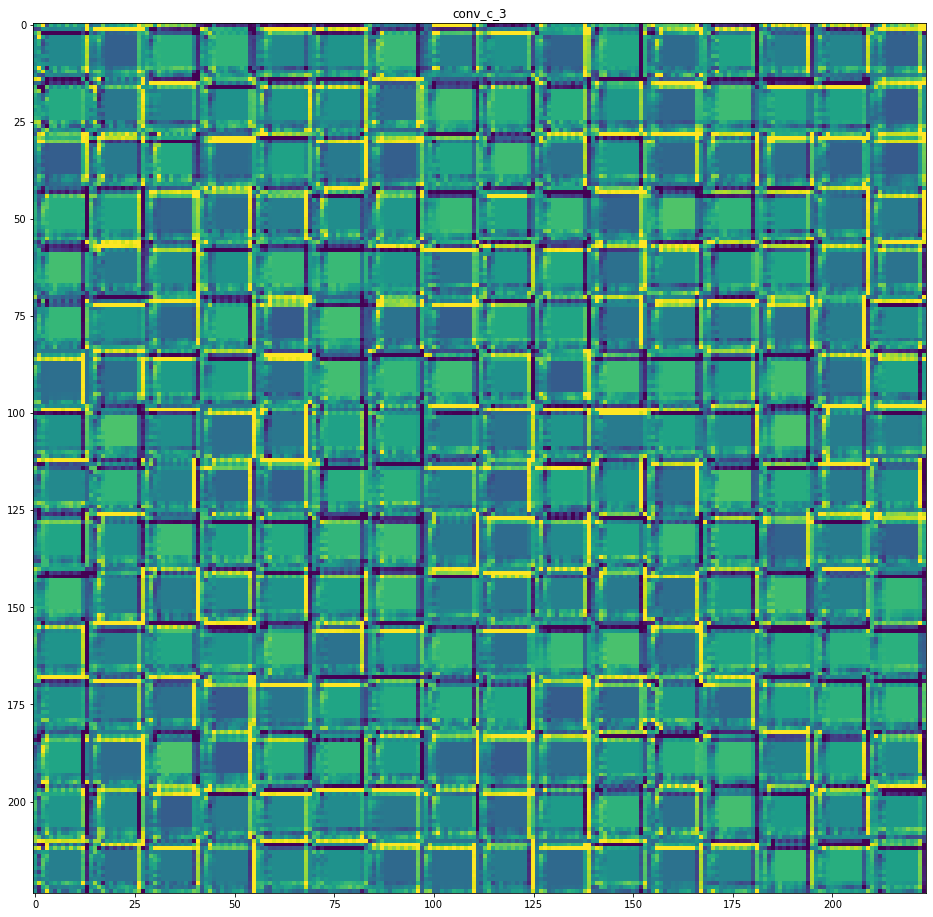

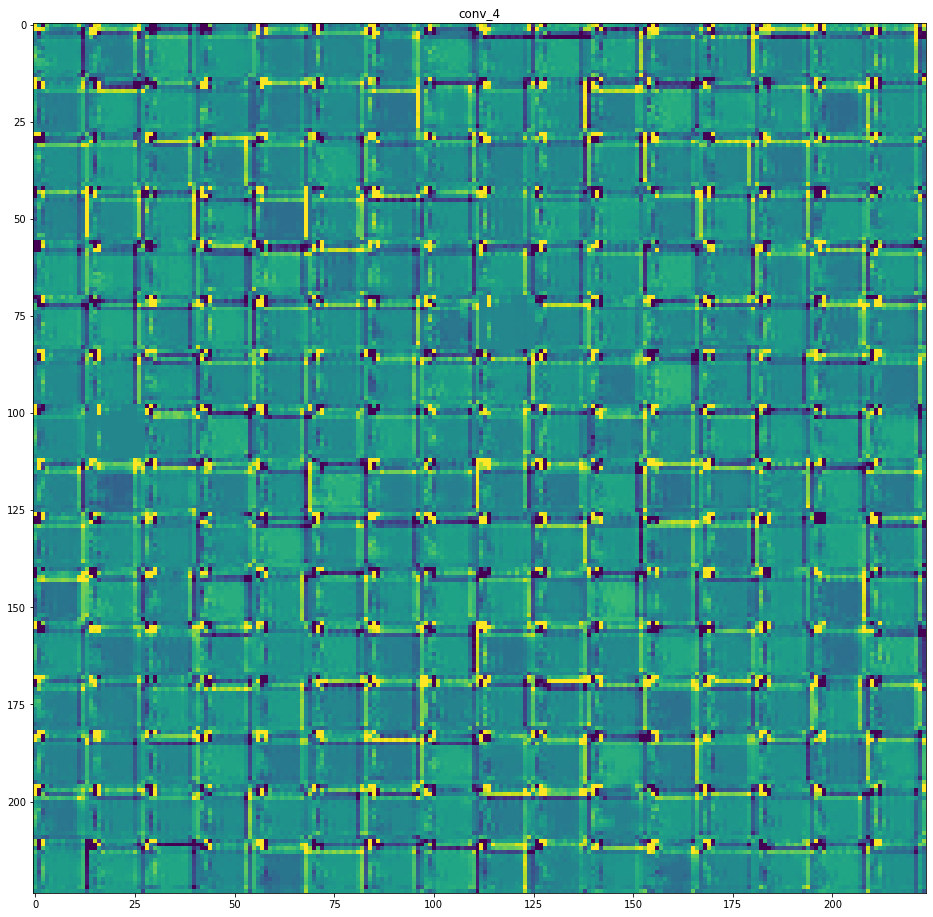

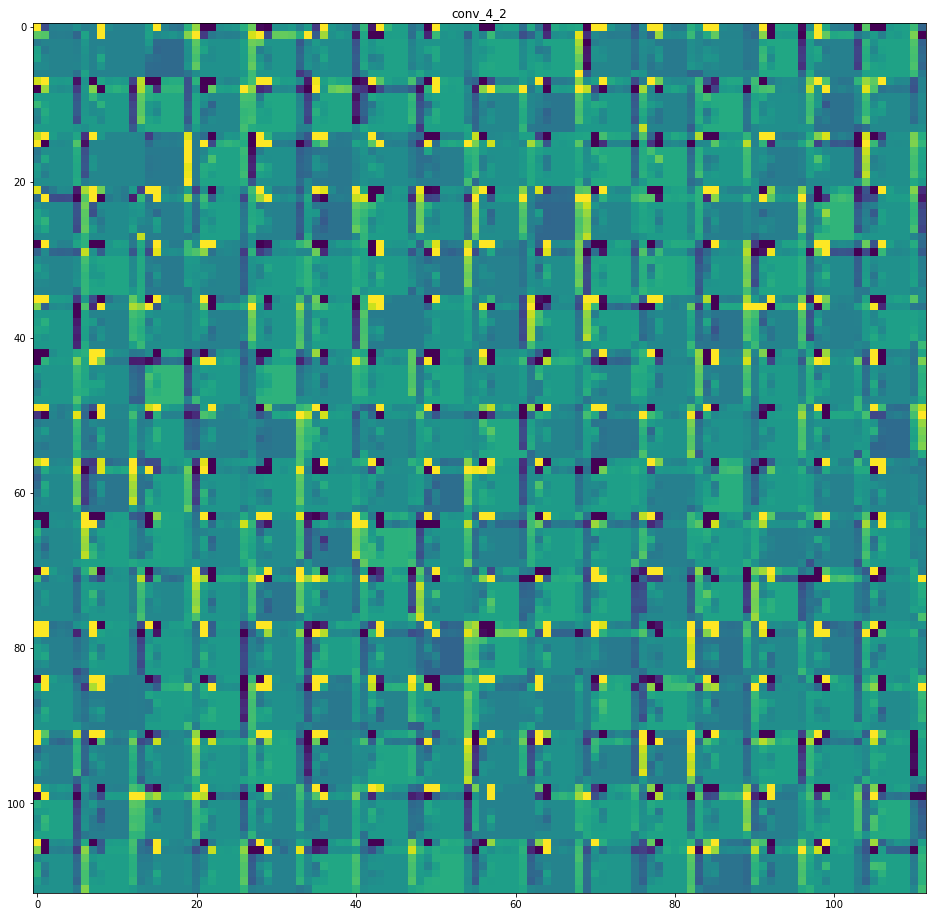

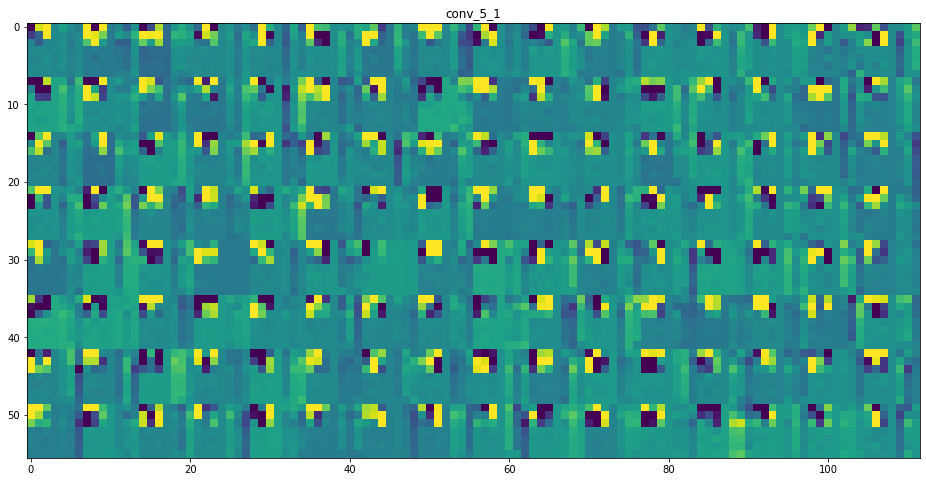

In [84]:
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations): # Displays the feature maps
    n_features = layer_activation.shape[-1] # Number of features in the feature map
    size = layer_activation.shape[1] #The feature map has shape (1, size, size, n_features).
    n_cols = n_features // images_per_row # Tiles the activation channels in this matrix
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols): # Tiles each filter into a big horizontal grid
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            channel_image -= channel_image.mean() # Post-processes the feature to make it visually palatable
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, # Displays the grid
                         row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

In [108]:
os.path.join(folder_train_bonafide, random.choice(os.listdir(folder_train_bonafide)))

'./data/train/bonafide/LA_T_5103637.flac'

In [ ]:
#All augmentations
import tarfile, shutil
import zipfile
import sys, os, urllib.request, tarfile, glob
import numpy as np
import cv2
import librosa
import librosa.core
import librosa.feature
import librosa.display 
import matplotlib.pyplot as plt
import random
from utils import *
from data_utils import *
from train_utils import *
import os
import pandas as pd
import soundfile as sf 
import tensorflow as tf
print(tf.version.VERSION)

folder_train_bonafide = './data/train/bonafide'
folder_train_spoofed = './data/train/spoof'
folder_eval_bonafide = './data/eval/bonafide'
folder_eval_spoofed = './data/eval/spoof'

#All augmentations
import os
import soundfile as sf
sample_rate = 16000
downstream_task = True
def resize_spectrogram(x):
    result = cv2.resize(x, (224, 224))
    return result

list_files = []
list_names = []
list_images = []

if downstream_task:
    
    target = "./data/train/bonafide/LA_T_8173514.flac" #os.path.join(folder_train_bonafide, random.choice(os.listdir(folder_train_bonafide)))
    print(target)
    target = file_load(target)[0]
    list_names.append("original audio")
    list_files.append(target)
    
    img0 = to_img2(target)
    img0 = resize_spectrogram(img0)
    list_images.append(img0)

    img1 = draw_line(img0)

    img2 = add_whitenoise(target, return_audio=True)
    list_files.append(img2)
    list_names.append("add_whitenoise")
    img2 = to_sp(img2)
    img2 = resize_spectrogram(img2)
    list_images.append(img2)

    img3 = add_pinknoise(target, return_audio=True)
    list_files.append(img3)
    list_names.append("add_pinknoise")
    img3 = to_sp(img3)
    img3 = resize_spectrogram(img3)
    list_images.append(img3)

    img4 = average_Hz(img0)
    
    img5 = pitch_shift_audio(target, sample_rate, return_audio=True)
    list_files.append(img5)
    list_names.append("pitch_shift_audio")
    img5 = to_sp(img5)
    img5 = resize_spectrogram(img5)
    list_images.append(img5)

    img6 = time_stretch_audio(target, return_audio=True)
    list_files.append(img6)
    list_names.append("time_stretch_audio")
    img6 = to_sp(img6)
    img6 = resize_spectrogram(img6)
    list_images.append(img6)
    
    img7 = LPC_synthesis_audio1(target, sample_rate, return_audio=True)
    list_files.append(img7)
    list_names.append("LPC_synthesis_audio1")
    img7 = to_sp(img7)
    img7 = resize_spectrogram(img7)
    list_images.append(img7)

    img8 = spectral_distorsion_model_audio(target, return_audio=True)
    list_files.append(img8)
    list_names.append("spectral_distorsion_model_audio")
    img8 = to_sp(img8)
    img8 = resize_spectrogram(img8)
    list_images.append(img8)
    
    img9 = LPC_synthesis_audio2(target, return_audio=True)
    list_files.append(img9)
    list_names.append("LPC_synthesis_audio2")
    img9 = to_sp(img9)
    img9 = resize_spectrogram(img9)
    list_images.append(img9)

    img10 = limiter_audio(target, sample_rate, return_audio=True)
    list_files.append(img10)
    list_names.append("limiter_audio")
    img10 = to_sp(img10)
    img10 = resize_spectrogram(img10)
    list_images.append(img10)
    
    img11 = arctan_compressor_audio(target, sample_rate, return_audio=True)
    list_files.append(img11)
    list_names.append("arctan_compressor_audio")
    img11 = to_sp(img11)
    img11 = resize_spectrogram(img11)
    list_images.append(img11)

    img12 = smooth_spectrum_audio(target, return_audio=True)
    list_files.append(img12)
    list_names.append("smooth_spectrum_audio")
    img12 = to_sp(img12)
    img12 = resize_spectrogram(img12)
    list_images.append(img12)
    
    img13 =specAugment(target, sample_rate=sample_rate, type_augment=4, return_audio=True)
    list_files.append(img13)
    list_names.append("specAugment")
    img13 = to_sp(img13)
    img13 = resize_spectrogram(img13)
    list_images.append(img13)
    
    img14 = smooth_convolve_audio(target, return_audio=True)
    list_files.append(img14)
    list_names.append("smooth_convolve_audio")
    img14 = to_sp(img14)
    img14 = resize_spectrogram(img14)
    list_images.append(img14)
    
    img15 = phase_vocoder_audio(target, return_audio=True)
    list_files.append(img15)
    list_names.append("phase_vocoder_audio")
    img15 = to_sp(img15)
    img15 = resize_spectrogram(img15)
    list_images.append(img15)

    img16 = speed_tune_audio(target, sample_rate, return_audio=True)
    list_files.append(img16)
    list_names.append("speed_tune_audio")
    img16 = to_sp(img16)
    img16 = resize_spectrogram(img16)
    list_images.append(img16)
    
    img17 = Griffin_Lim_vocoder(target, return_audio=True)
    list_files.append(img17)
    list_names.append("Griffin_Lim_vocoder")
    img17 = to_sp(img17)
    img17 = resize_spectrogram(img17)
    list_images.append(img17)

    img18 = subspace_audio(target, return_audio=True)
    list_files.append(img18)
    list_names.append("subspace_audio")
    img18 = to_sp(img18)
    img18 = resize_spectrogram(img18)
    list_images.append(img18)
    
    img19 = iterative_wiener_audio(target, return_audio=True)
    list_files.append(img19)
    list_names.append("iterative_wiener_audio")
    img19 = to_sp(img19)
    img19 = resize_spectrogram(img19)
    list_images.append(img19)

    img20 = spectral_subtraction_audio(target, return_audio=True)
    list_files.append(img20)
    list_names.append("spectral_subtraction_audio")
    img20 = to_sp(img20)
    img20 = resize_spectrogram(img20)
    list_images.append(img20)
    
    target2 = os.path.join(folder_train_bonafide, random.choice(os.listdir(folder_train_bonafide)))
    target2, _ = sf.read(target2)
    img21 = mix_audios(target, target2, return_audio=True)
    list_files.append(img21)
    list_names.append("mix_audios")
    img21 = to_sp(img21)
    img21 = resize_spectrogram(img21)
    list_images.append(img21)
    
    img22 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img22)
    list_names.append("apply_sequential_transforms")
    img22 = to_sp(img22)
    img22 = resize_spectrogram(img22)
    list_images.append(img22)
    
    img23 = butterworth_sound_filter(target, sample_rate, return_audio=True)
    list_files.append(img23)
    list_names.append("butterworth_sound_filter")
    img23 = to_sp(img23)
    img23 = resize_spectrogram(img23)
    list_images.append(img23)
                             
    img24 = checkerboard_patterns(target, sample_rate, return_audio=True)
    list_files.append(img24)
    list_names.append("checkerboard_patterns")
    img24 = to_sp(img24)
    img24 = resize_spectrogram(img24)
    list_images.append(img24)
    
    img25 = mel_to_stft_griffinLim(target, sample_rate, return_audio=True)
    list_files.append(img25)
    list_names.append("mel_to_stft_griffinLim")
    img25 = to_sp(img25)
    img25 = resize_spectrogram(img25)
    list_images.append(img25)
    
    img26 = specAugment(target, sample_rate=sample_rate, type_augment=3, return_audio=True)
    list_files.append(img26)
    list_names.append("sparse_warp")
    img26 = to_sp(img26)
    img26 = resize_spectrogram(img26)
    list_images.append(img26)
    
    img27 = specAugment(target, sample_rate=sample_rate, type_augment=2, return_audio=True)
    list_files.append(img27)
    list_names.append("frequency_masking")
    img27 = to_sp(img27)
    img27 = resize_spectrogram(img27)
    list_images.append(img27)
    
    img28 = specAugment(target, sample_rate=sample_rate, type_augment=1, return_audio=True)
    list_files.append(img28)
    list_names.append("time_masking")
    img28 = to_sp(img28)
    img28 = resize_spectrogram(img28)
    list_images.append(img28)
    
    img29 = reverberance_audio(target, sample_rate=sample_rate, return_audio=True)
    list_files.append(img29)
    list_names.append("reverberance_audio")
    img29 = to_sp(img29)
    img29 = resize_spectrogram(img29)
    list_images.append(img29)
    
    img30 = specAugment(target, sample_rate=sample_rate, type_augment=4, return_audio=True)
    list_files.append(img30)
    list_names.append("specAugment")
    img30 = to_sp(img30)
    img30 = resize_spectrogram(img30)
    list_images.append(img30)
    
    img31 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img31)
    list_names.append("apply_sequential_transforms")
    img31 = to_sp(img31)
    img31 = resize_spectrogram(img31)
    list_images.append(img31)
    
    img32 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img32)
    list_names.append("apply_sequential_transforms")
    img32 = to_sp(img32)
    img32 = resize_spectrogram(img32)
    list_images.append(img32)
    
    img33 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img33)
    list_names.append("apply_sequential_transforms")
    img33 = to_sp(img33)
    img33 = resize_spectrogram(img33)
    list_images.append(img33)
    
    img34 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img34)
    list_names.append("apply_sequential_transforms")
    img34 = to_sp(img34)
    img34 = resize_spectrogram(img34)
    list_images.append(img34)
    

    plt.figure(figsize=(20,20))
    plt.subplot(7,5,1)
    plt.axis("off")
    plt.title("Original bonafide audio")
    plt.imshow(img0)

    plt.subplot(7,5,2)
    plt.axis("off")
    plt.title("slight line")
    plt.imshow(img1)

    plt.subplot(7,5,3)
    plt.axis("off")
    plt.title("add white noise")
    plt.imshow(img2)

    plt.subplot(7,5,4)
    plt.axis("off")
    plt.title("add pink noise")
    plt.imshow(img3)

    plt.subplot(7,5,5)
    plt.axis("off")
    plt.title("average Hz")
    plt.imshow(img4)
    
    plt.subplot(7,5,6)
    plt.axis("off")
    plt.title("pitch_shift")
    plt.imshow(img5)

    plt.subplot(7,5,7)
    plt.axis("off")
    plt.title("time_stretch")
    plt.imshow(img6)

    plt.subplot(7,5,8)
    plt.axis("off")
    plt.title("LPC_synthesis1")
    plt.imshow(img7)

    plt.subplot(7,5,9)
    plt.axis("off")
    plt.title("spectral_distorsion_model")
    plt.imshow(img8)

    plt.subplot(7,5,10)
    plt.axis("off")
    plt.title("LPC_synthesis2")
    plt.imshow(img9)
    
    plt.subplot(7,5,11)
    plt.axis("off")
    plt.title("limiter_audio")
    plt.imshow(img10)

    plt.subplot(7,5,12)
    plt.axis("off")
    plt.title("arctan_compressor")
    plt.imshow(img11)

    plt.subplot(7,5,13)
    plt.axis("off")
    plt.title("smooth_spectrum")
    plt.imshow(img12)

    plt.subplot(7,5,14)
    plt.axis("off")
    plt.title("spec_augment")
    plt.imshow(img13)

    plt.subplot(7,5,15)
    plt.axis("off")
    plt.title("smooth_convolve")
    plt.imshow(img14)
    
    plt.subplot(7,5,16)
    plt.axis("off")
    plt.title("phase_vocoder")
    plt.imshow(img15)

    plt.subplot(7,5,17)
    plt.axis("off")
    plt.title("speed_tune")
    plt.imshow(img16)

    plt.subplot(7,5,18)
    plt.axis("off")
    plt.title("Griffin_Lim_vocoder")
    plt.imshow(img17)

    plt.subplot(7,5,19)
    plt.axis("off")
    plt.title("subspace")
    plt.imshow(img18)

    plt.subplot(7,5,20)
    plt.axis("off")
    plt.title("iterative_wiener")
    plt.imshow(img19)
    
    plt.subplot(7,5,21)
    plt.axis("off")
    plt.title("spectral_subtraction")
    plt.imshow(img20)

    plt.subplot(7,5,22)
    plt.axis("off")
    plt.title("mix_audios")
    plt.imshow(img21)
    
    plt.subplot(7,5,23)
    plt.axis("off")
    plt.title("sequential_transforms")
    plt.imshow(img22)
    
    plt.subplot(7,5,24)
    plt.axis("off")
    plt.title("butterworth_filter")
    plt.imshow(img23)

    plt.subplot(7,5,25)
    plt.axis("off")
    plt.title("checkerboard_patterns")
    plt.imshow(img24)
    
    plt.subplot(7,5,26)
    plt.axis("off")
    plt.title("mel_to_stft_griffinLim")
    plt.imshow(img25)
    
    plt.subplot(7,5,27)
    plt.axis("off")
    plt.title("sparse_warp")
    plt.imshow(img26)
    
    plt.subplot(7,5,28)
    plt.axis("off")
    plt.title("frequency_masking")
    plt.imshow(img27)
    
    plt.subplot(7,5,29)
    plt.axis("off")
    plt.title("time_masking")
    plt.imshow(img28)
    
    plt.subplot(7,5,30)
    plt.axis("off")
    plt.title("reverberance")
    plt.imshow(img29)
    
    plt.subplot(7,5,31)
    plt.axis("off")
    plt.title("spec_augment")
    plt.imshow(img30)
    
    plt.subplot(7,5,32)
    plt.axis("off")
    plt.title("random sequential_transform")
    plt.imshow(img31)
    
    plt.subplot(7,5,33)
    plt.axis("off")
    plt.title("random sequential_transform")
    plt.imshow(img32)
    
    plt.subplot(7,5,34)
    plt.axis("off")
    plt.title("random sequential_transform")
    plt.imshow(img33)
    
    plt.subplot(7,5,35)
    plt.axis("off")
    plt.title("random sequential_transform")
    plt.imshow(img34)
    
    
    
    #plt.savefig('Spoof_Augmentations_investigation.png')
    #plt.savefig('Spoof_Augmentations_investigation.pdf')
    
    plt.show()

In [55]:
list_files = np.array(list_files)
list_files = to_img(list_files, features=features_type)

list_files = (list_files-min_)/(max_-min_)

list_files = (list_files*255-mean)/sigma

if features_type not in ['fbanks_delta_doubledelta', 'HPSS_power', 'HPSS_stft', 'HPSS_llfb', 'HPSS_decompose_audio', 'HPSS_llfb_doubledelta']:
    list_files = np.expand_dims(list_files, axis=-1)
print("#list_files.shape: ", list_files.shape)

/tmp/ipykernel_90836/71538982.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  list_files = np.array(list_files)


#list_files.shape:  (33, 224, 224, 3)


In [57]:
def print_file_activations(input_audio):
    img_tensor = input_audio #x_train_normal[:1]
    activations = activation_model.predict(img_tensor) # Returns a list of five Numpy arrays: one array per layer activation
    
    first_layer_activation = activations[0]
    print(first_layer_activation.shape)
    
    print("***** Input features *****")
    plt.figure(figsize=(20,20))

    plt.subplot(1,3,1)
    plt.axis("off")
    plt.title("Input llfb clip")
    plt.imshow(img_tensor[0, :, :, 0])

    plt.subplot(1,3,2)
    plt.axis("off")
    plt.title("Input llfb harmonic of clip")
    plt.imshow(img_tensor[0, :, :, 1])

    plt.subplot(1,3,3)
    plt.axis("off")
    plt.title("Input llfb percussive of clip")
    plt.imshow(img_tensor[0, :, :, 2])

    plt.show()
    
    print("***** Successive Layers Activations *****")

    images_per_row = 16

    for layer_name, layer_activation in zip(layer_names, activations): # Displays the feature maps
        n_features = layer_activation.shape[-1] # Number of features in the feature map
        size = layer_activation.shape[1] #The feature map has shape (1, size, size, n_features).
        n_cols = n_features // images_per_row # Tiles the activation channels in this matrix
        display_grid = np.zeros((size * n_cols, images_per_row * size))
        for col in range(n_cols): # Tiles each filter into a big horizontal grid
            for row in range(images_per_row):
                channel_image = layer_activation[0, :, :,col * images_per_row + row]
                channel_image = np.array(channel_image).astype('uint8')
                display_grid[col * size : (col + 1) * size, # Displays the grid
                             row * size : (row + 1) * size] = channel_image
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name + " " + str(layer_activation.shape))
        plt.grid(False)
        plt.imshow(display_grid) #, aspect='auto', cmap='viridis')

In [198]:
print(len(list_names))

33


In [199]:
print(list_names)

['original audio', 'add_whitenoise', 'add_pinknoise', 'pitch_shift_audio', 'time_stretch_audio', 'LPC_synthesis_audio1', 'spectral_distorsion_model_audio', 'LPC_synthesis_audio2', 'limiter_audio', 'arctan_compressor_audio', 'smooth_spectrum_audio', 'specAugment', 'smooth_convolve_audio', 'phase_vocoder_audio', 'speed_tune_audio', 'Griffin_Lim_vocoder', 'subspace_audio', 'iterative_wiener_audio', 'spectral_subtraction_audio', 'mix_audios', 'apply_sequential_transforms', 'butterworth_sound_filter', 'checkerboard_patterns', 'mel_to_stft_griffinLim', 'sparse_warp', 'frequency_masking', 'time_masking', 'reverberance_audio', 'specAugment', 'apply_sequential_transforms', 'apply_sequential_transforms', 'apply_sequential_transforms', 'apply_sequential_transforms']


In [200]:
y_total = np.zeros(len(list_names), dtype=int)
y_total[1:] = 1
y_dev_total_categ = keras.utils.to_categorical(y_total)
print(y_dev_total_categ)

[[1. 0.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]]


In [201]:
# N.B: Please take note that performance is low on these augmented samples because model was not trained with augmented data (only clean data). This is only to test our model's behavior
# Evaluate the model on the dev data using `evaluate`
print("Evaluate on dev data")
dev_results = model.evaluate([list_files, y_dev_total_categ], y_dev_total_categ)#, steps=STEPS_PER_EPOCH_DEV)#batch_size=32)
print("dev loss, dev acc:", dev_results)

Evaluate on dev data
2/2 [==============================] - 0s 26ms/step - loss: 23.8480 - accuracy: 0.3333
dev loss, dev acc: [23.84804916381836, 0.3333333432674408]


In [202]:
print("Generate predictions")
dev_predictions = model.predict([list_files, y_dev_total_categ])#, steps=STEPS_PER_EPOCH_DEV)
print("predictions shape:", dev_predictions.shape)
print(dev_predictions)

Generate predictions
predictions shape: (33, 2)
[[1.0000000e+00 8.0055400e-18]
 [1.0000000e+00 1.6553998e-17]
 [1.0000000e+00 8.9281003e-18]
 [3.4949477e-18 1.0000000e+00]
 [1.0000000e+00 9.4528596e-18]
 [1.0000000e+00 4.9688746e-11]
 [1.0000000e+00 7.7179657e-18]
 [1.0000000e+00 8.0136679e-18]
 [1.0000000e+00 4.1728490e-10]
 [1.0000000e+00 1.0667299e-08]
 [1.7487642e-17 1.0000000e+00]
 [2.4848491e-18 1.0000000e+00]
 [1.0000000e+00 2.8116150e-17]
 [1.0000000e+00 7.8602581e-18]
 [1.0176587e-17 1.0000000e+00]
 [1.0000000e+00 8.5635982e-18]
 [6.1076388e-14 1.0000000e+00]
 [2.4556656e-18 1.0000000e+00]
 [1.0000000e+00 6.4969234e-18]
 [1.0000000e+00 7.2681085e-18]
 [1.0000000e+00 9.9504832e-18]
 [9.1325494e-16 1.0000000e+00]
 [1.0000000e+00 9.2129491e-18]
 [1.0000000e+00 1.0611040e-17]
 [1.0000000e+00 8.8467678e-18]
 [1.0000000e+00 1.1224692e-17]
 [5.4053508e-04 9.9945945e-01]
 [1.0000000e+00 9.1084637e-18]
 [1.0000000e+00 4.7754357e-13]
 [1.0000000e+00 6.7990880e-18]
 [1.0000000e+00 9.0061

In [203]:
mask_files = [(y[1]>y[0]) for y in dev_predictions]
mask_files[0] = dev_predictions[0][0] > dev_predictions[0][1]
mask_files

[True,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 True,
 True,
 False,
 False,
 True,
 False,
 True,
 True,
 False,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 True,
 True]

In [204]:
print(list_files.shape)

(33, 224, 224, 3)


In [205]:
mask_files_misclassified = [not elem for elem in mask_files]

In [206]:
list_files_misclassified = list_files[mask_files_misclassified,:,:,:]

In [207]:
list_names_misclassified = [x for x, y in zip(list_names, mask_files_misclassified) if y == True]
print(len(list_names_misclassified))

22


In [209]:
list_images_misclassified = [x for x, y in zip(list_images, mask_files_misclassified) if y == True]
print(np.array(list_images_misclassified).shape)

(22, 224, 224)


In [210]:
list_files = list_files[mask_files,:,:,:]

In [211]:
list_names = [x for x, y in zip(list_names, mask_files) if y == True]
print(len(list_names))

11


In [212]:
print(list_names)

['original audio', 'pitch_shift_audio', 'smooth_spectrum_audio', 'specAugment', 'speed_tune_audio', 'subspace_audio', 'iterative_wiener_audio', 'butterworth_sound_filter', 'time_masking', 'apply_sequential_transforms', 'apply_sequential_transforms']


In [213]:
print(list_files.shape)

(11, 224, 224, 3)


In [214]:
list_images = [x for x, y in zip(list_images, mask_files) if y == True]
print(np.array(list_images).shape)

(11, 224, 224)


## Display original bonafide audio versus other spoof augmentations of same bonafide audio

#Display correctly classified samples

******** original audio ********
**********************************
(1, 112, 112, 64)
***** Input features *****


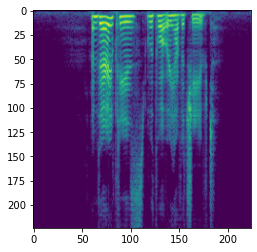

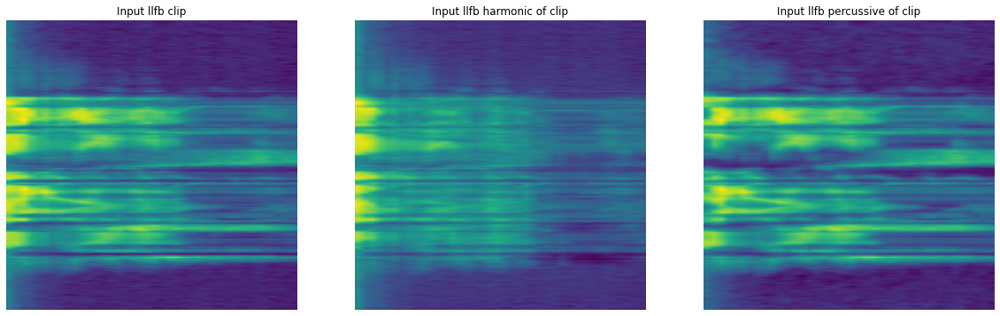

***** Successive Layers Activations *****


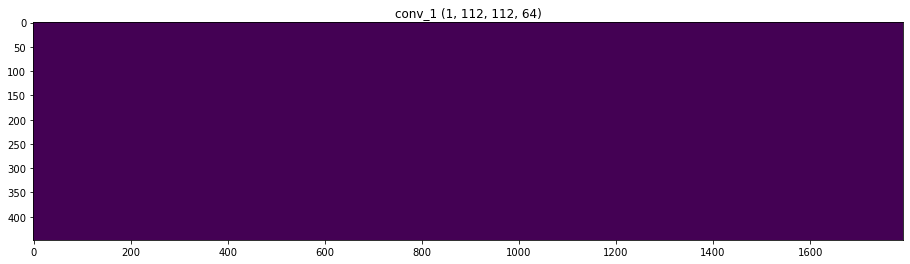

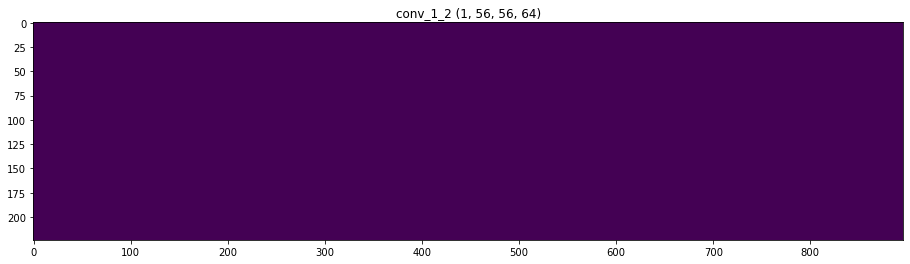

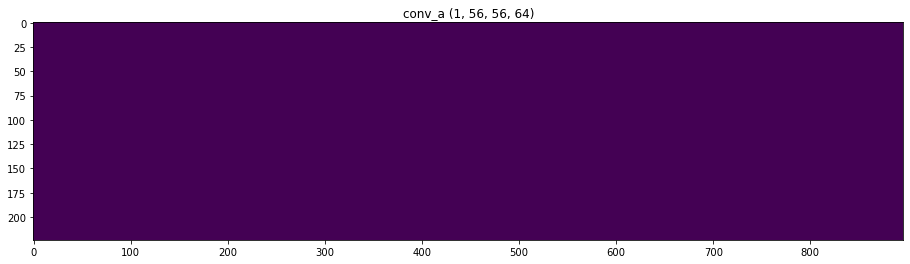

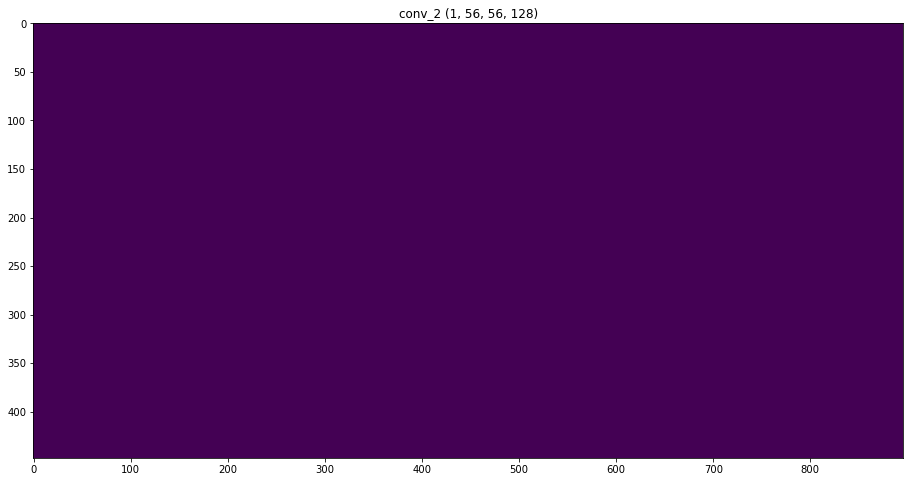

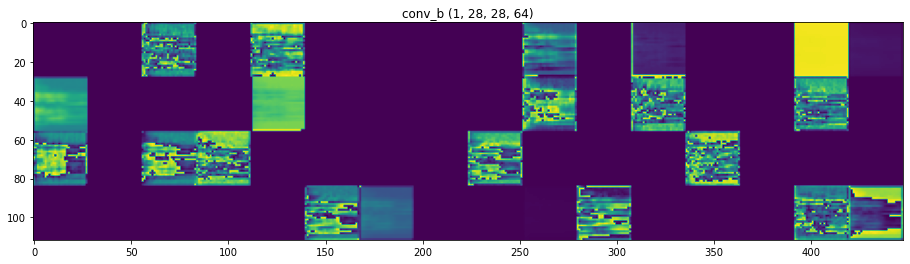

...

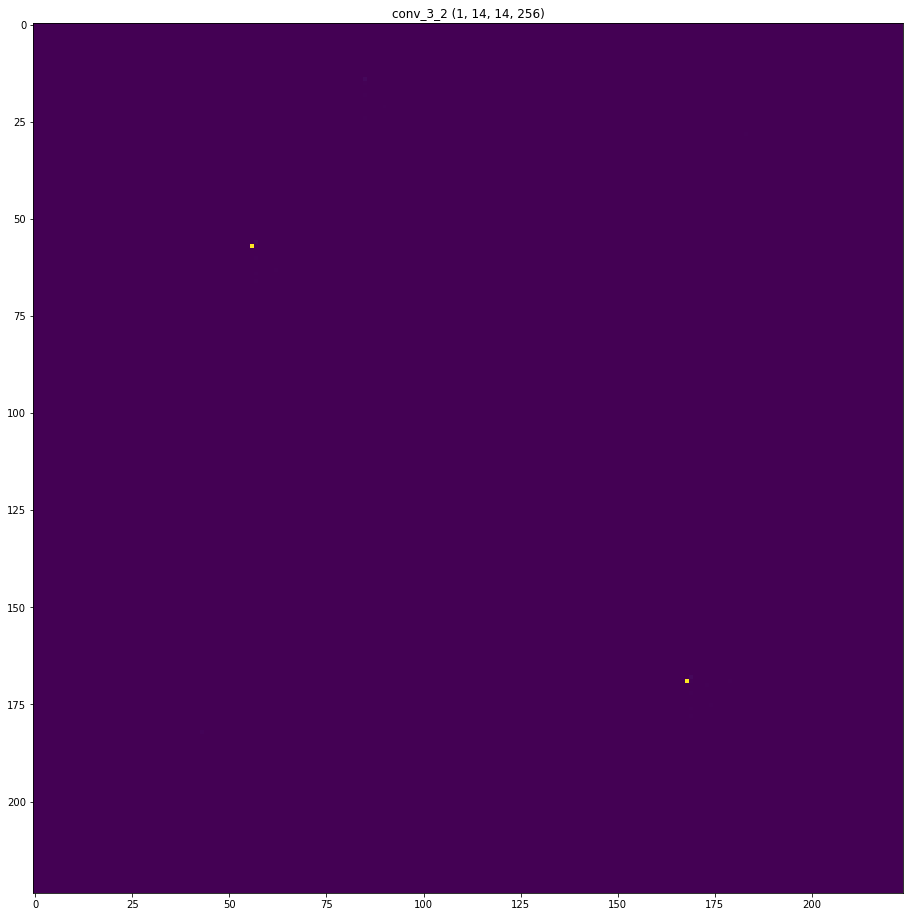

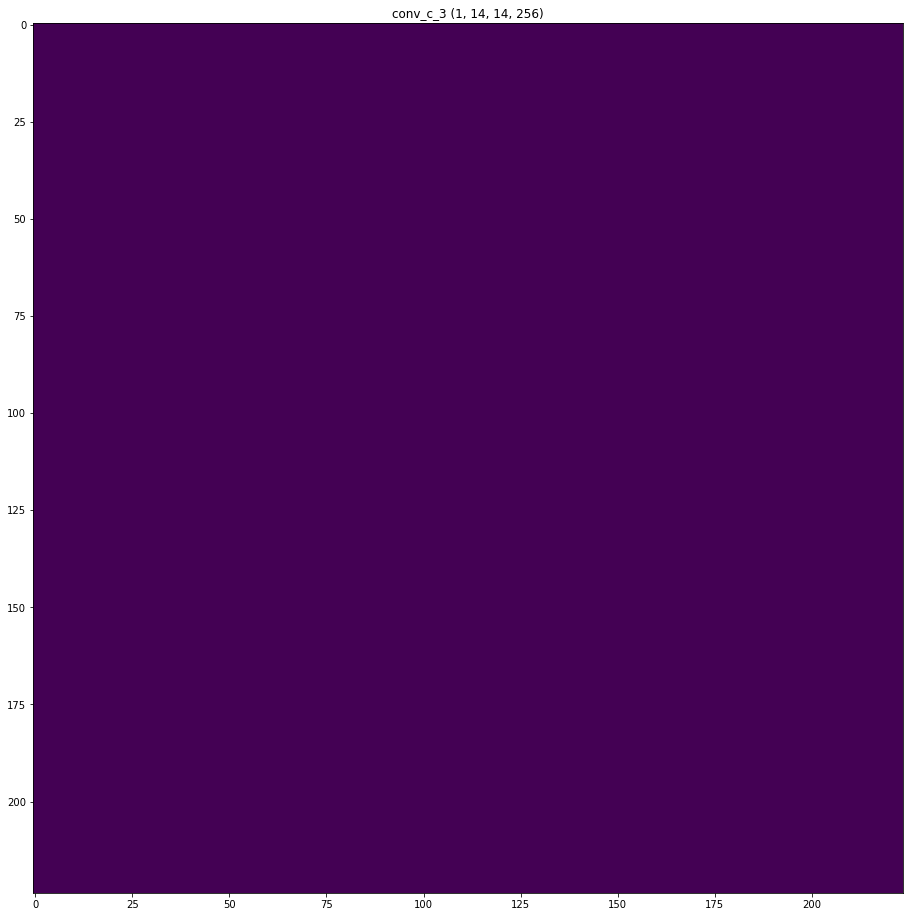

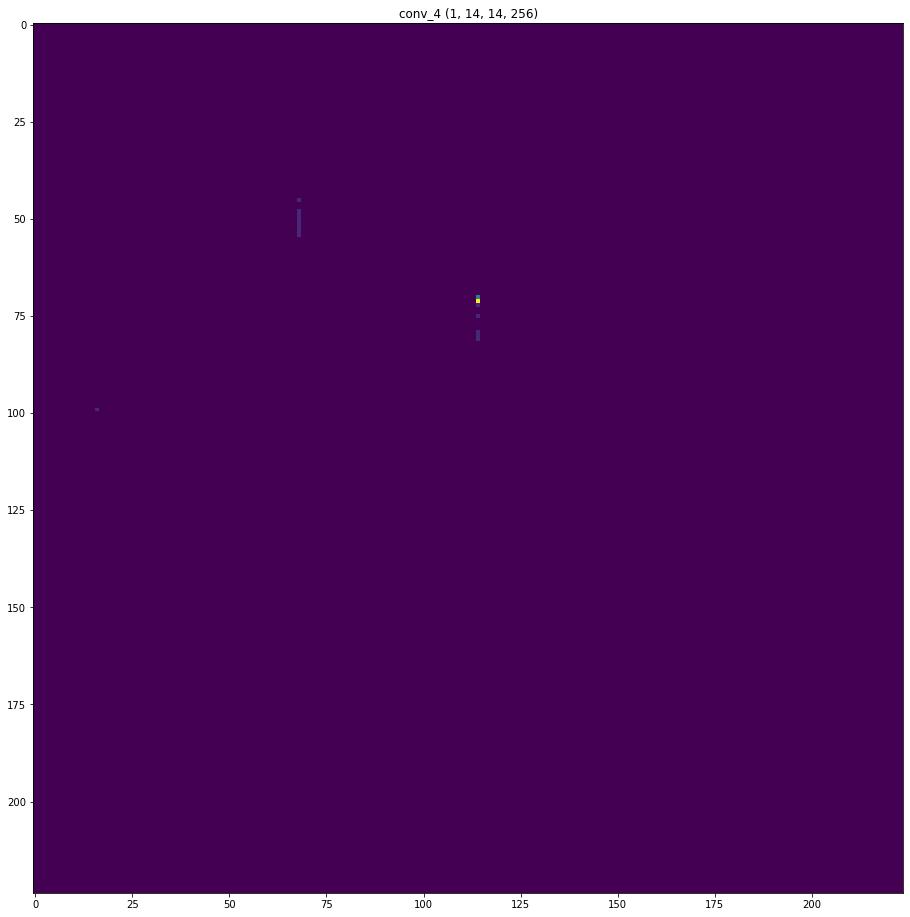

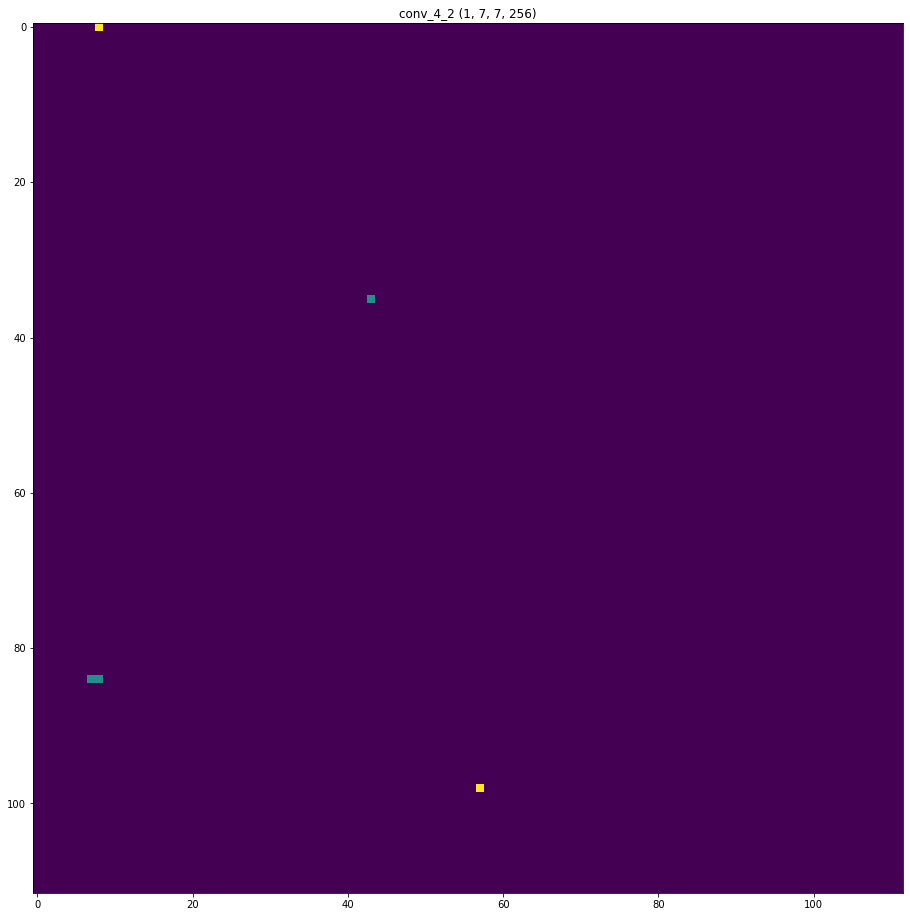

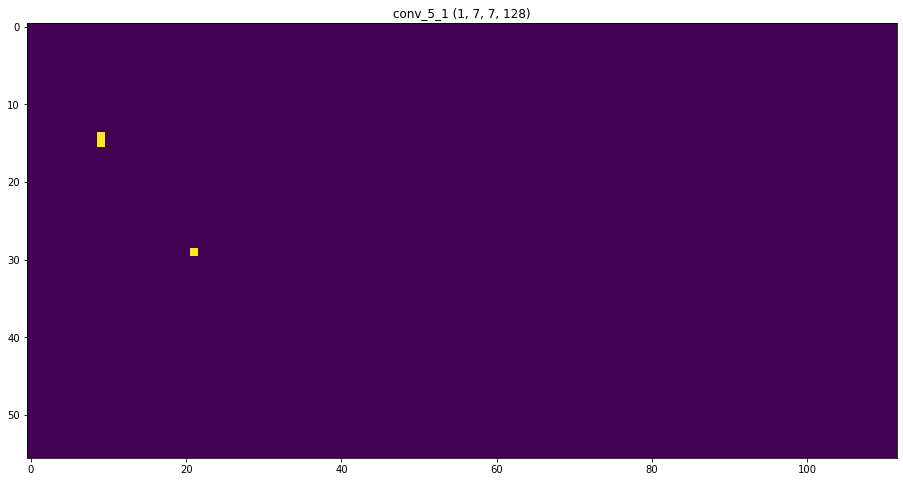

In [215]:
idx_file = 0
input_audio = list_files[[idx_file],:,:,:]
print("******** " + list_names[idx_file] + " ********")
plt.imshow(list_images[idx_file])
print("**********************************")
print_file_activations(input_audio)

******** specAugment ********
**********************************
(1, 112, 112, 64)
***** Input features *****


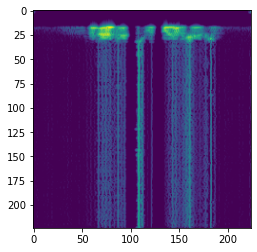

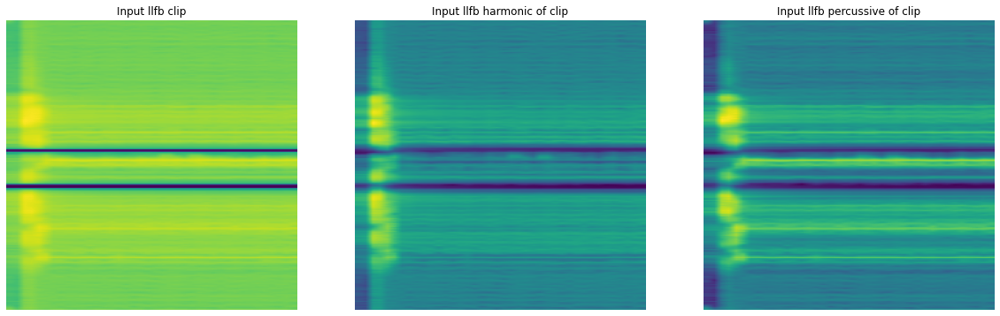

***** Successive Layers Activations *****


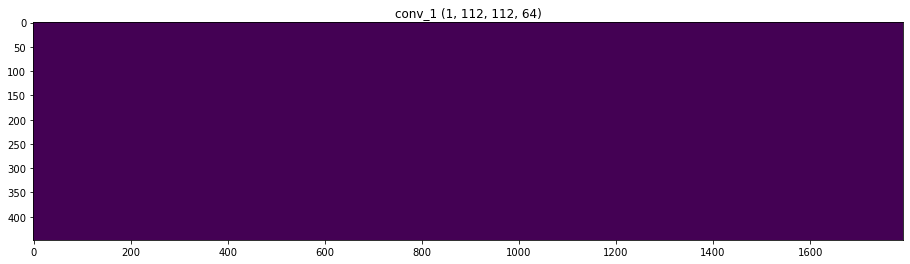

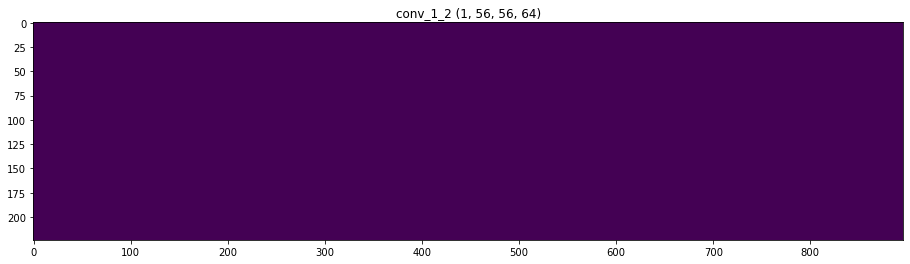

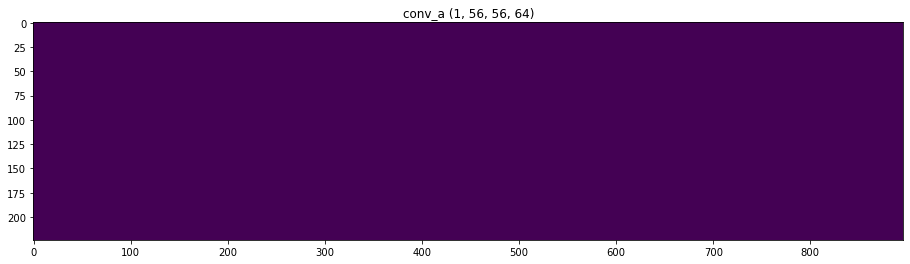

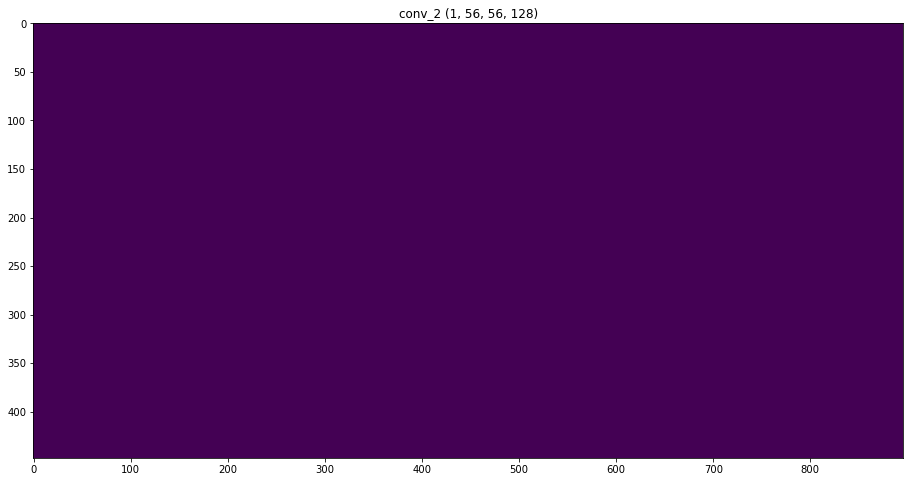

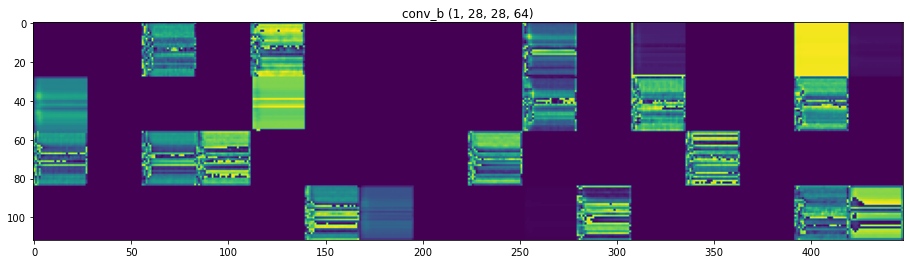

...

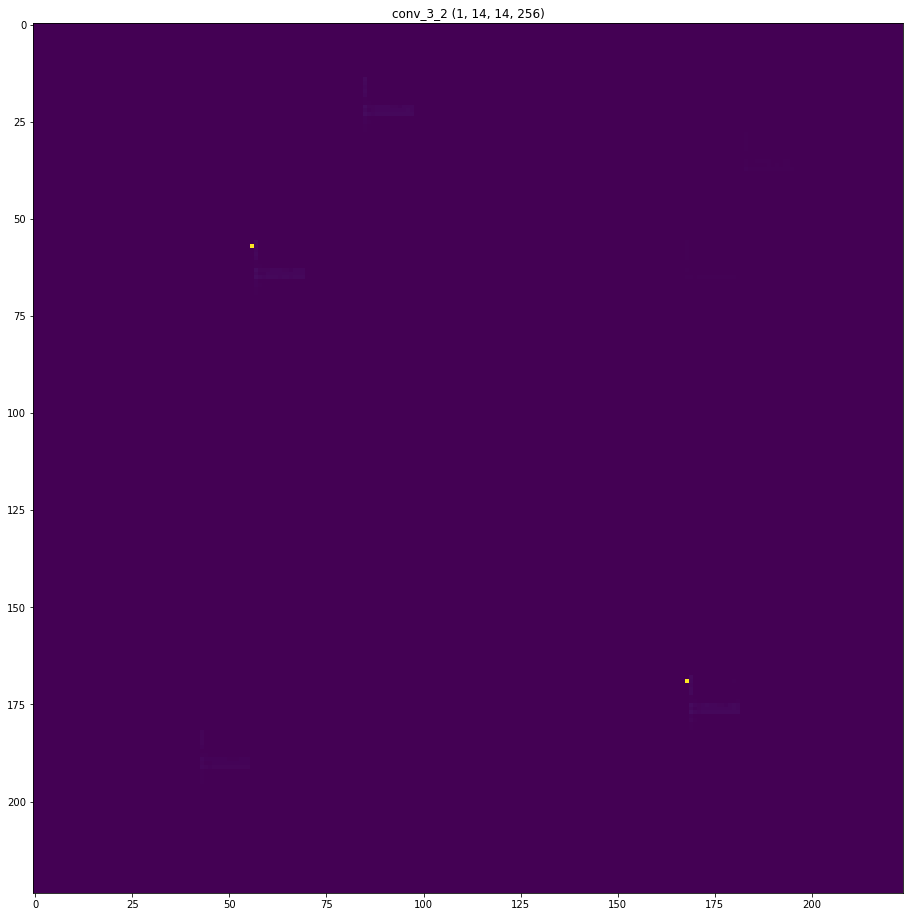

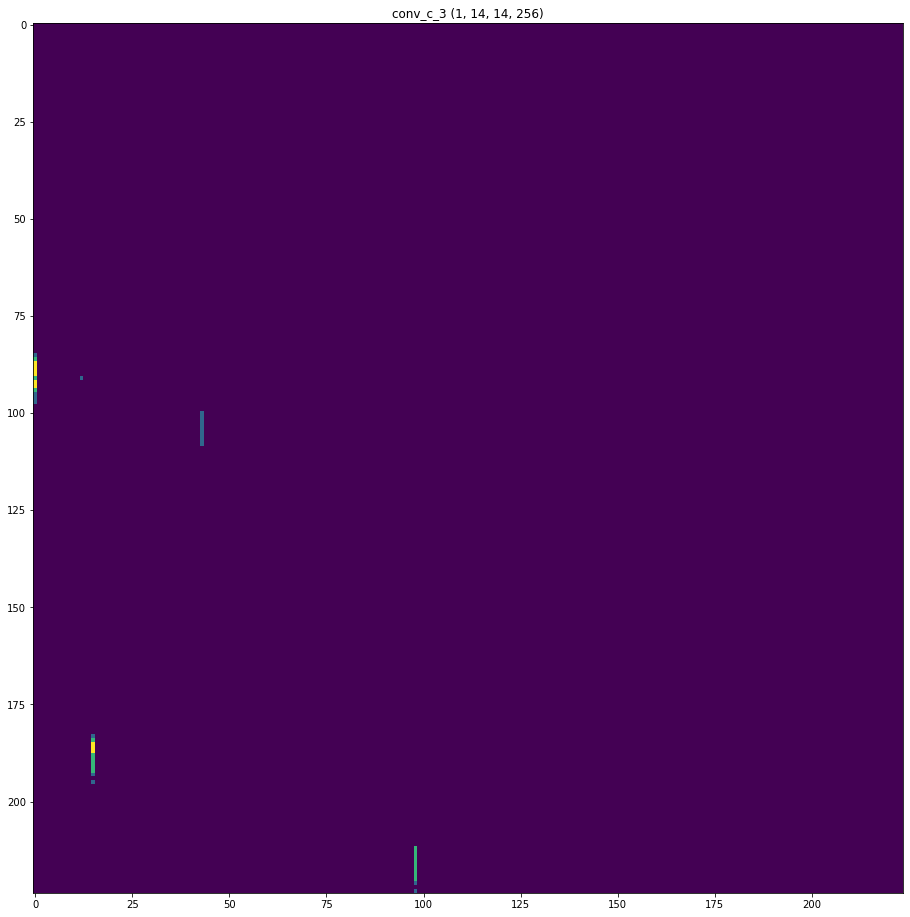

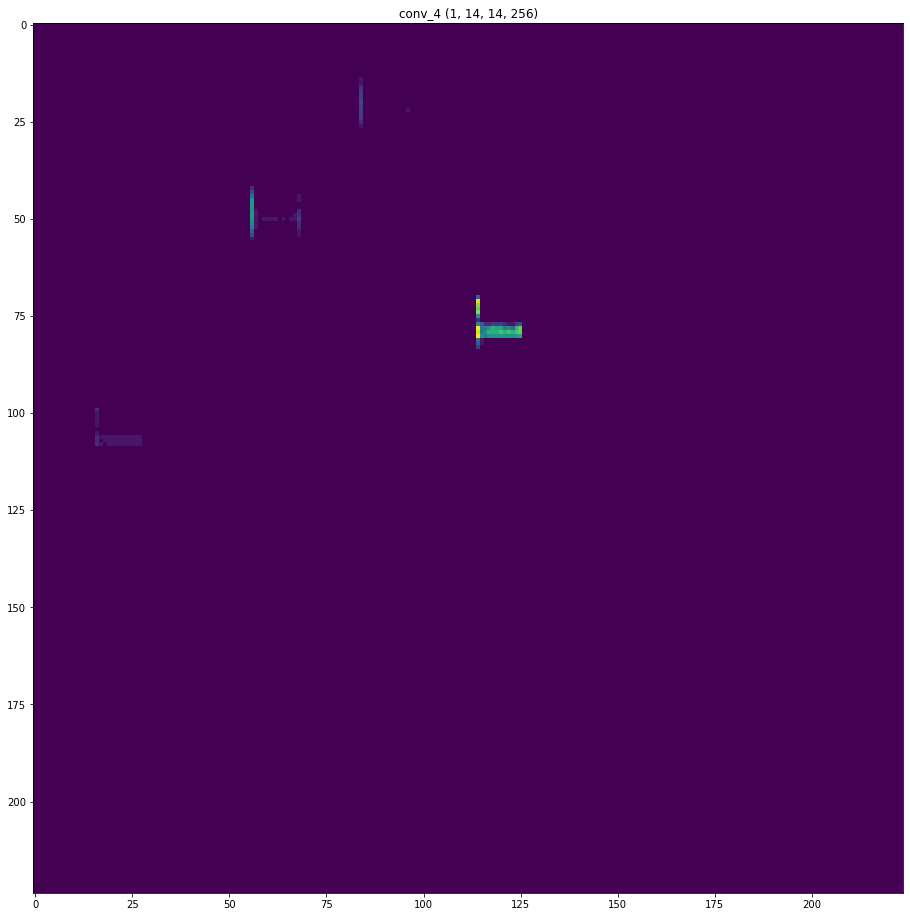

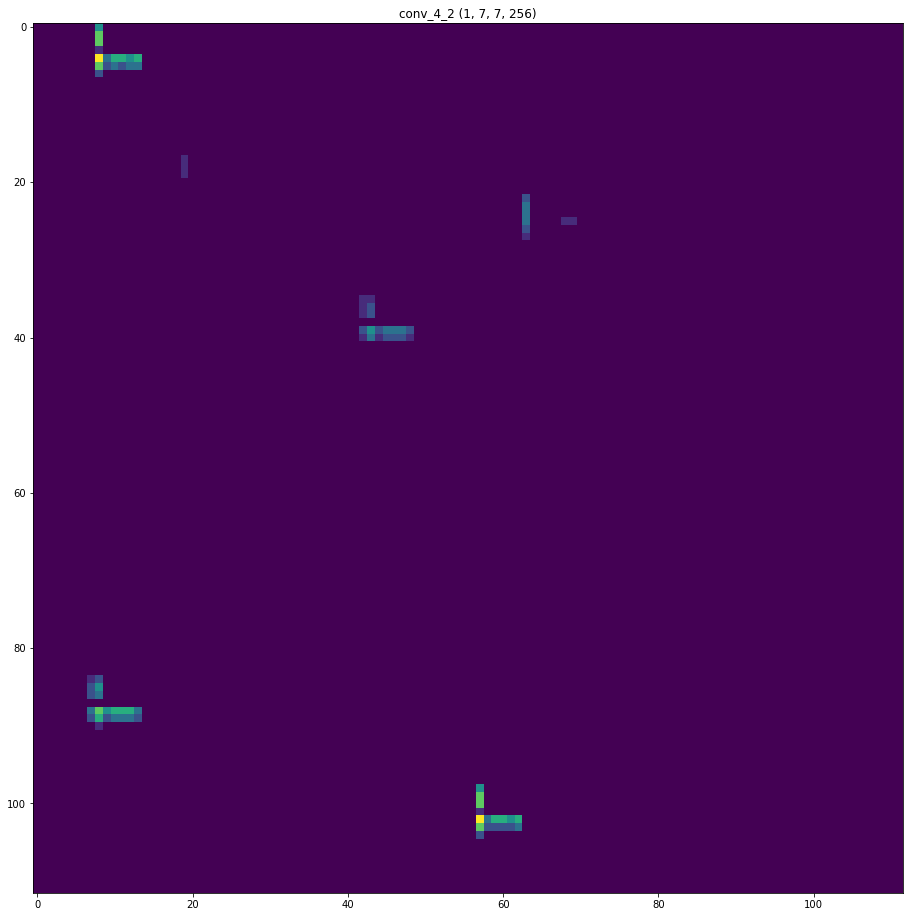

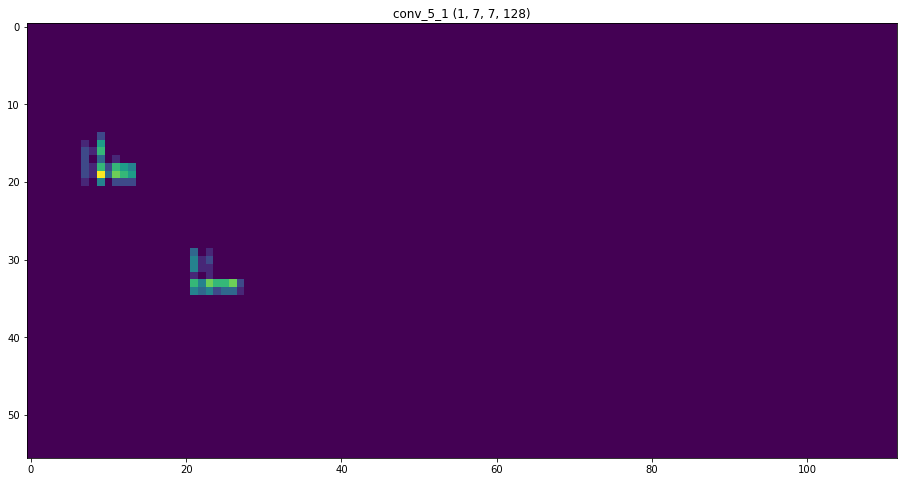

In [218]:
idx_file = 3
input_audio = list_files[[idx_file],:,:,:]
print("******** " + list_names[idx_file] + " ********")
plt.imshow(list_images[idx_file])
print("**********************************")
print_file_activations(input_audio)

### Misclassified samples

******** add_whitenoise ********
**********************************
(1, 112, 112, 64)
***** Input features *****


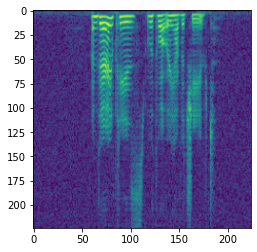

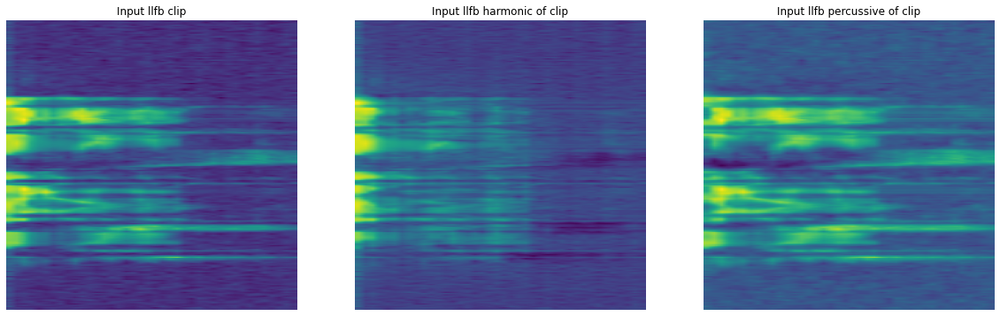

***** Successive Layers Activations *****


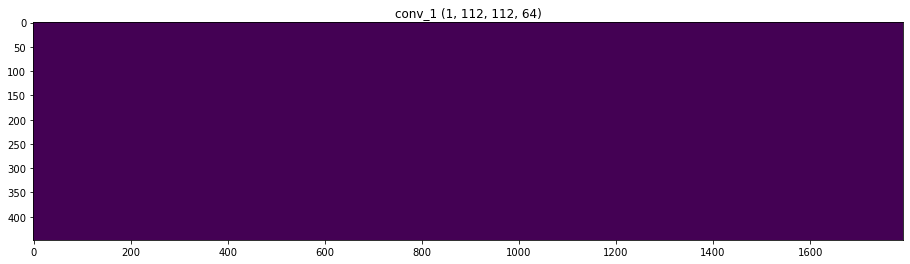

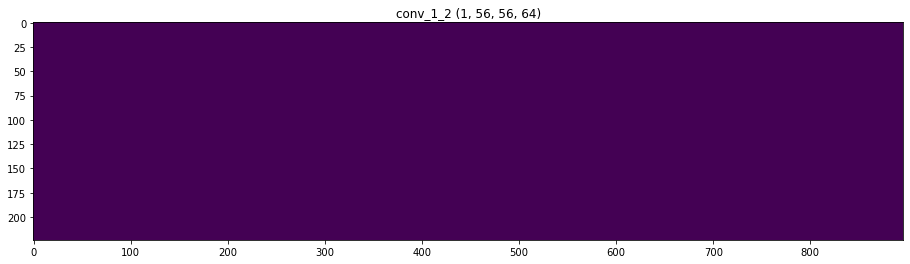

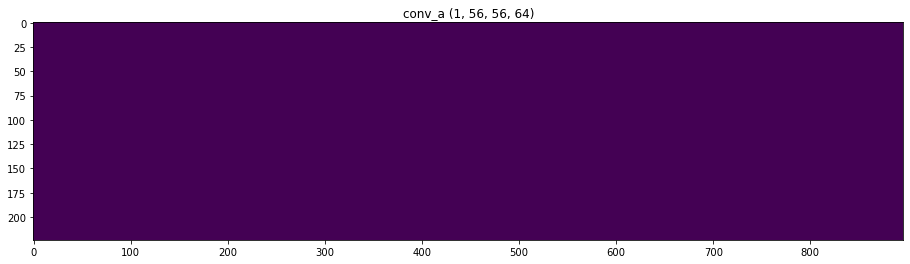

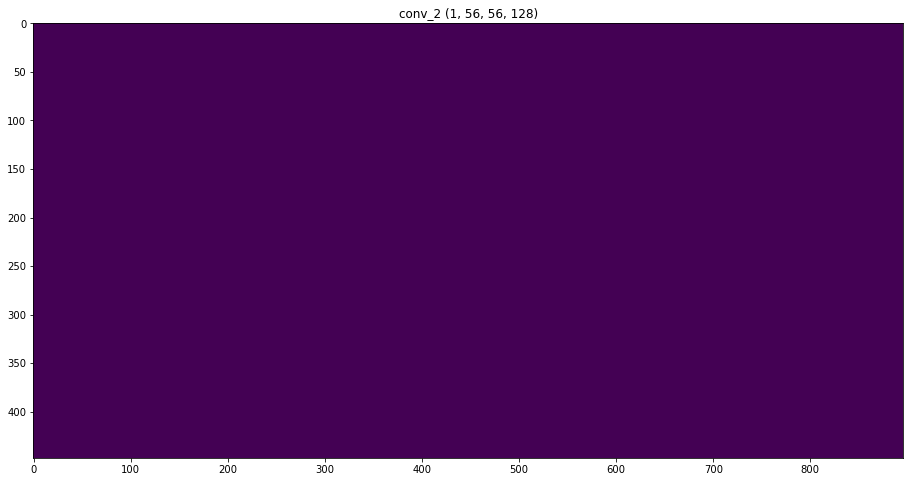

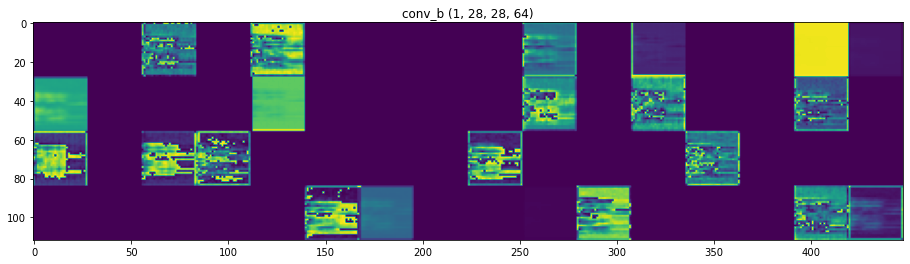

...

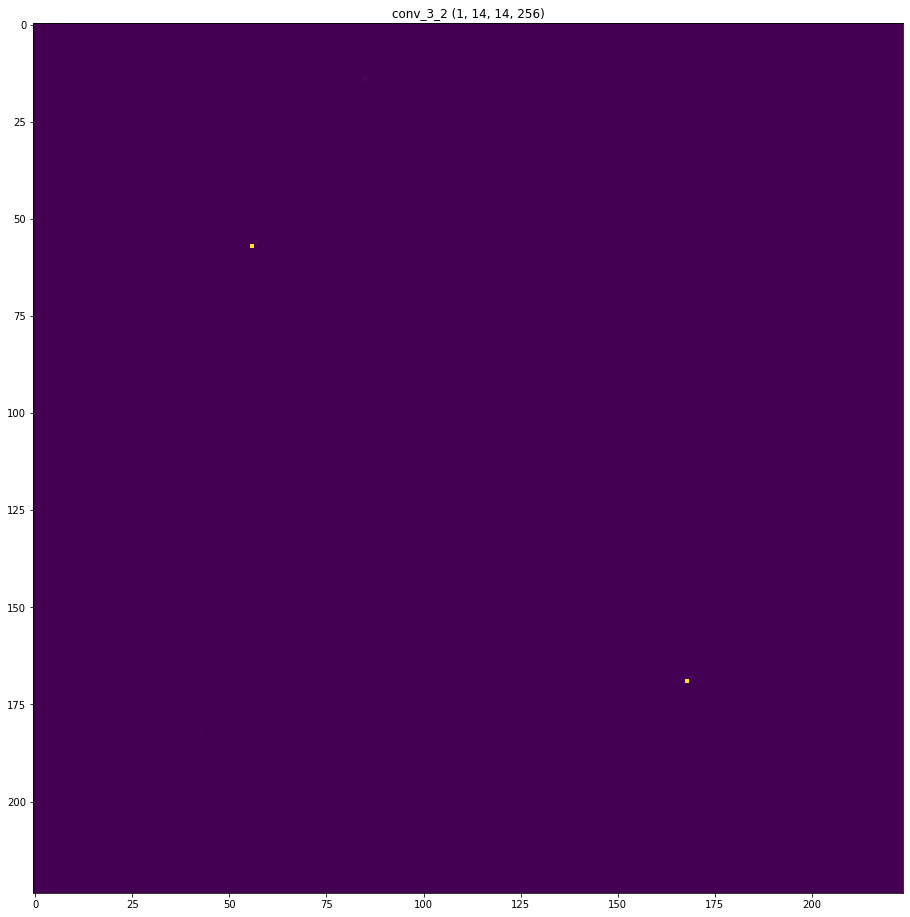

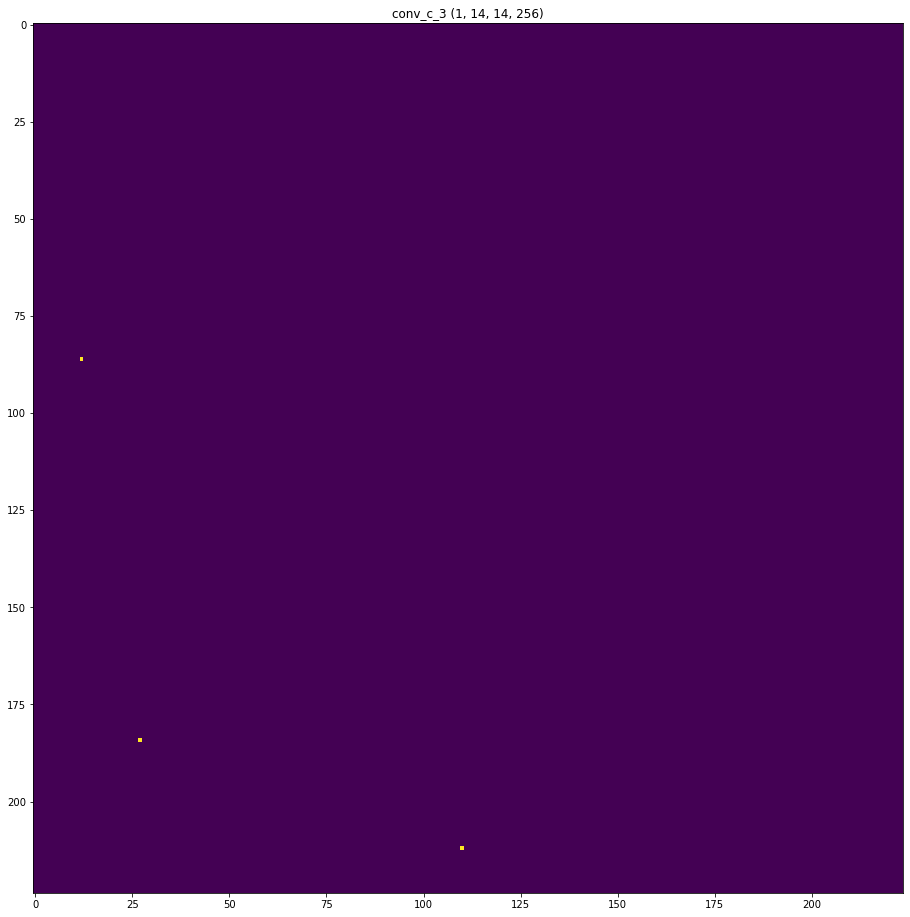

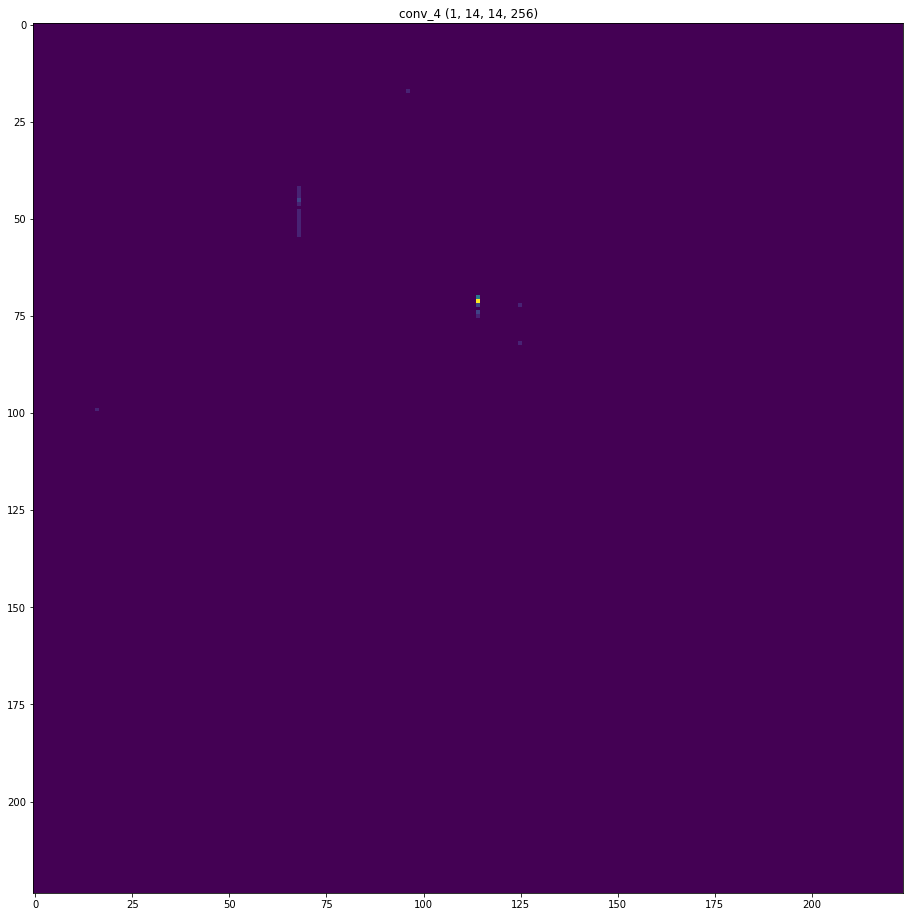

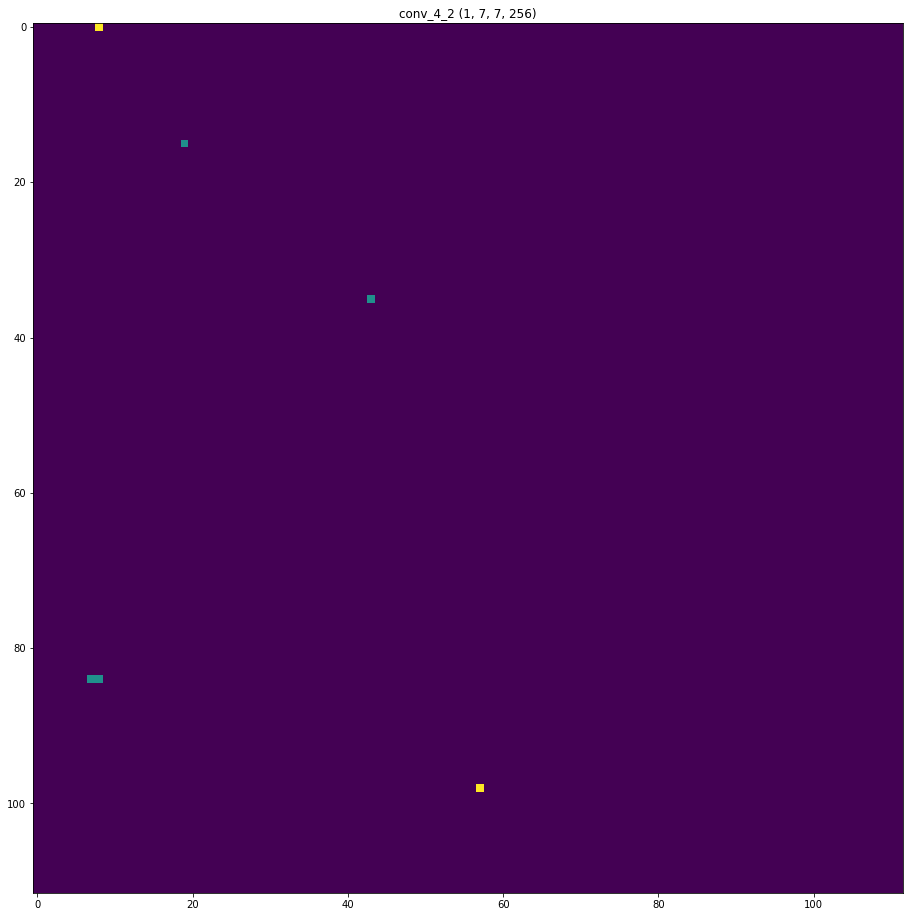

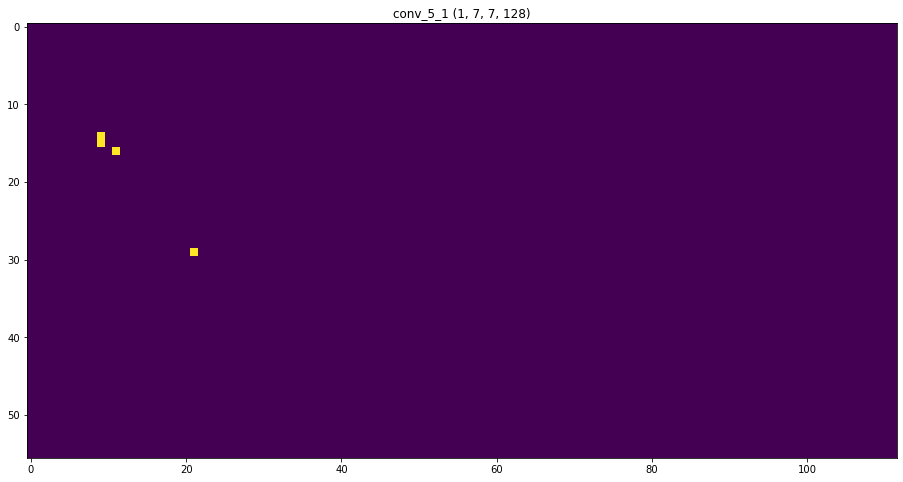

In [230]:
idx_file = 0
input_audio = list_files_misclassified[[idx_file],:,:,:]
print("******** " + list_names_misclassified[idx_file] + " ********")
plt.imshow(list_images_misclassified[idx_file])
print("**********************************")
print_file_activations(input_audio)

******** time_stretch_audio ********
**********************************
(1, 112, 112, 64)
***** Input features *****


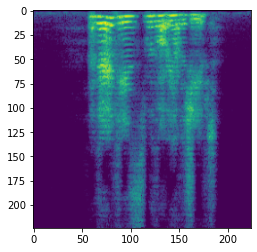

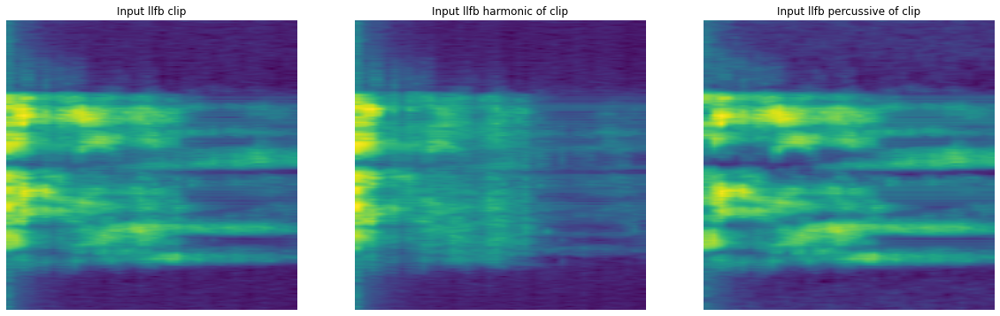

***** Successive Layers Activations *****


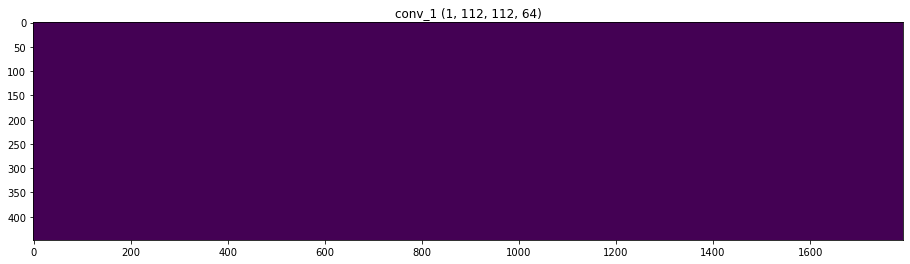

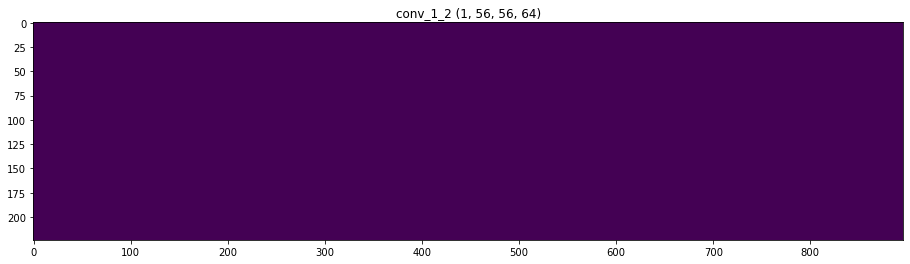

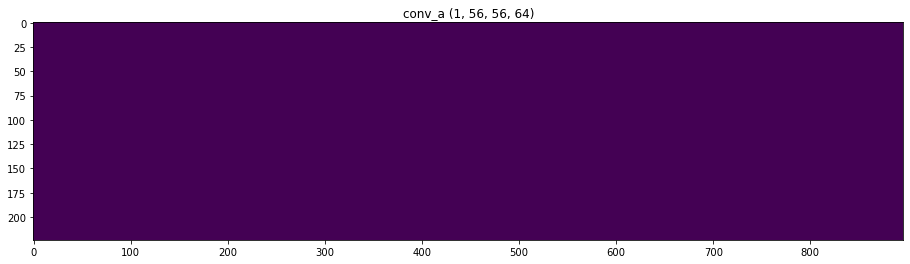

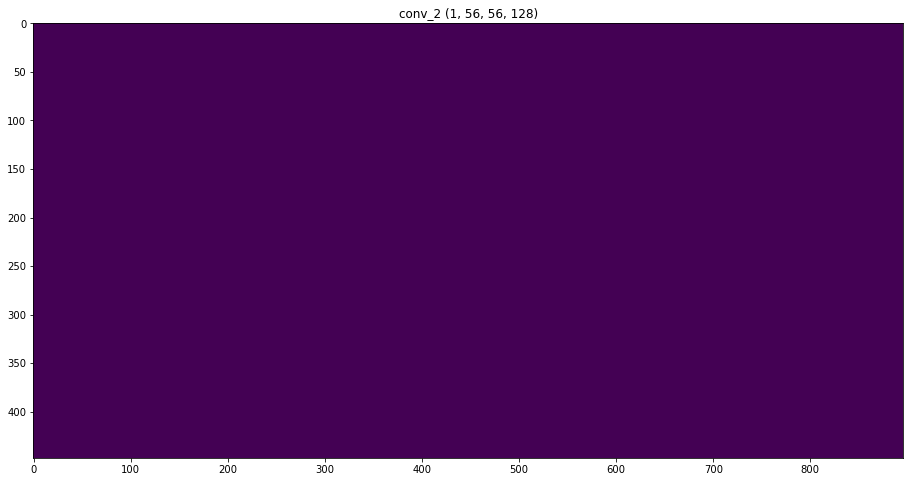

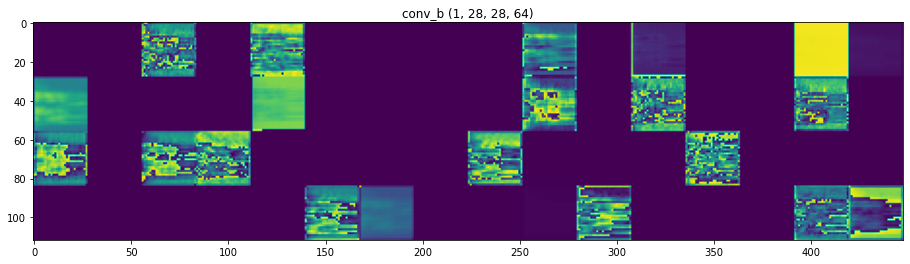

...

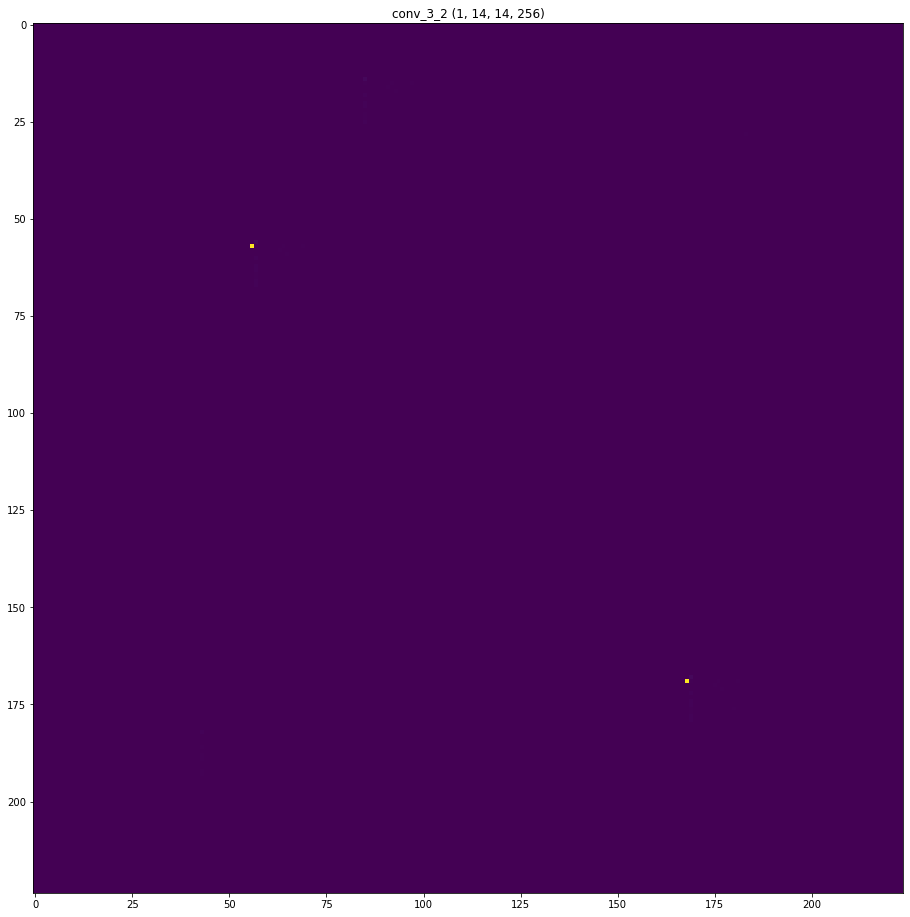

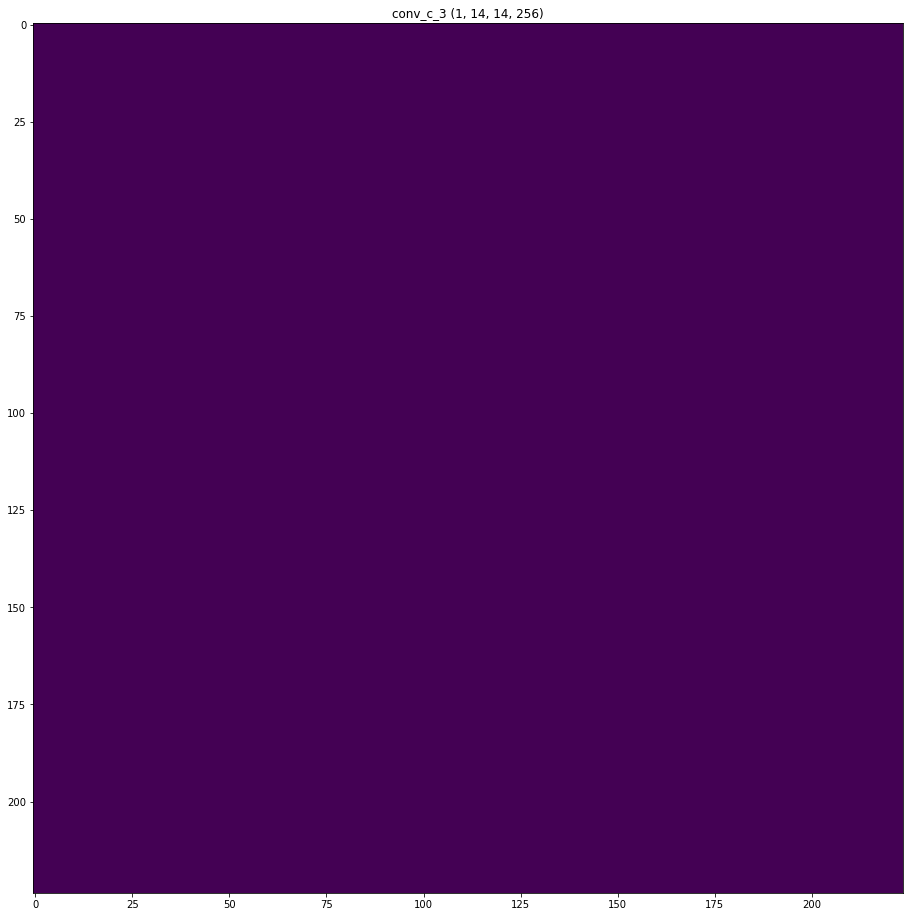

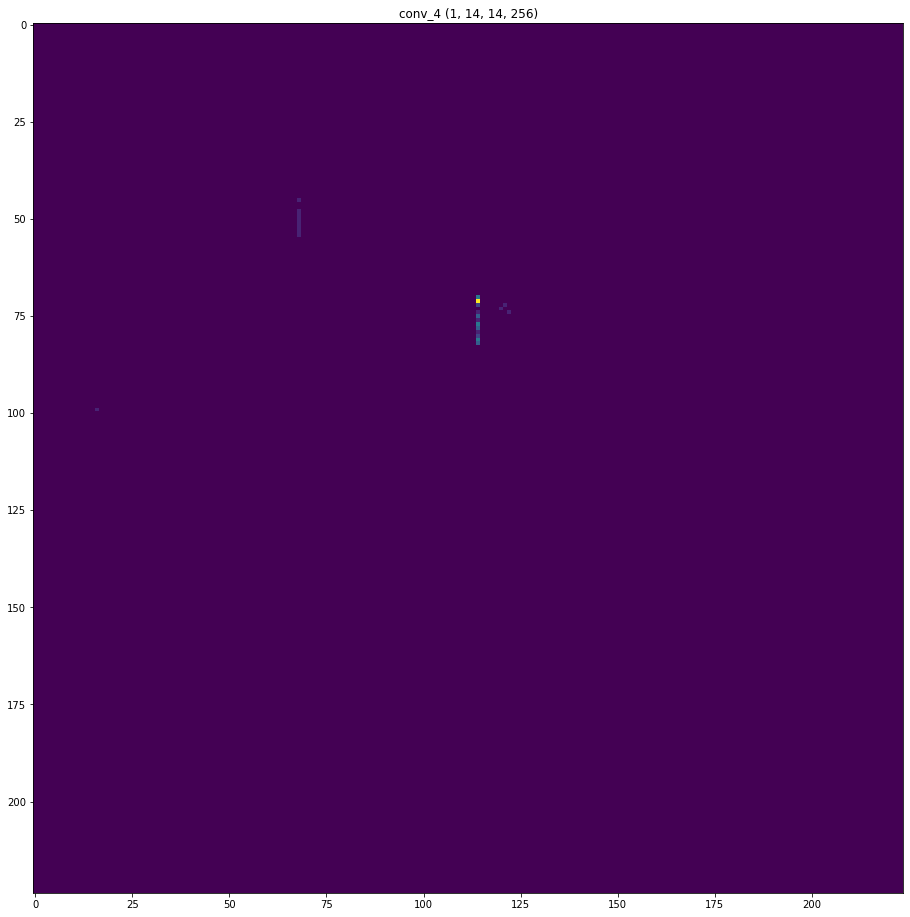

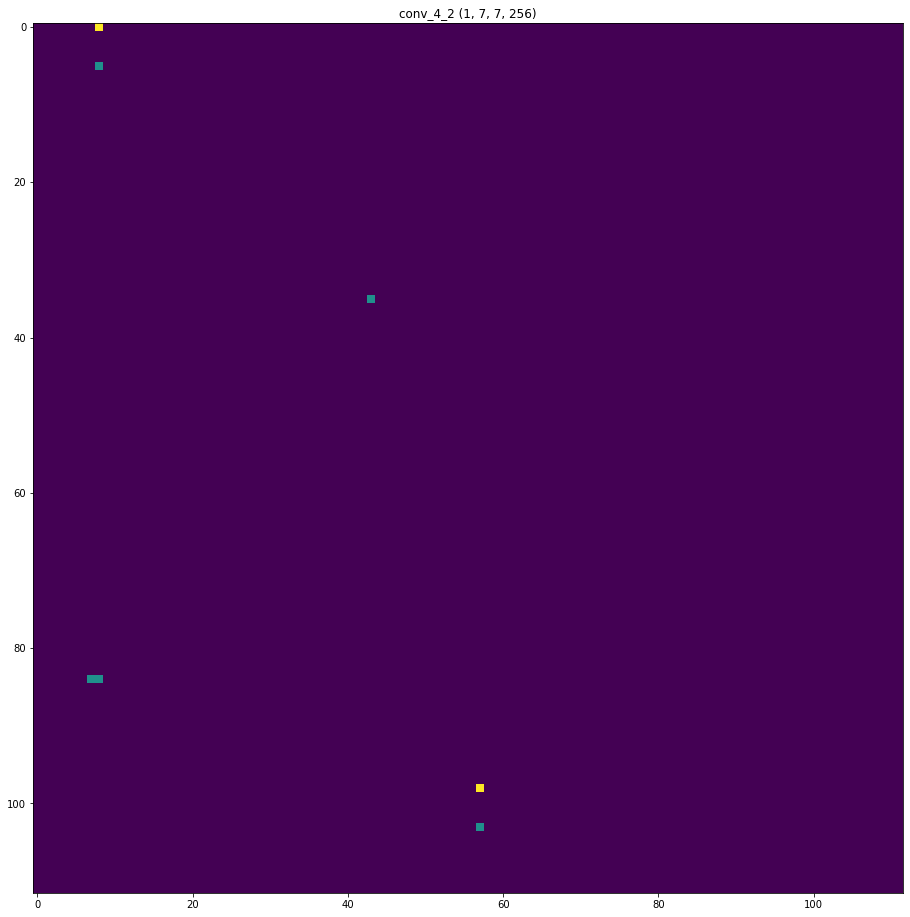

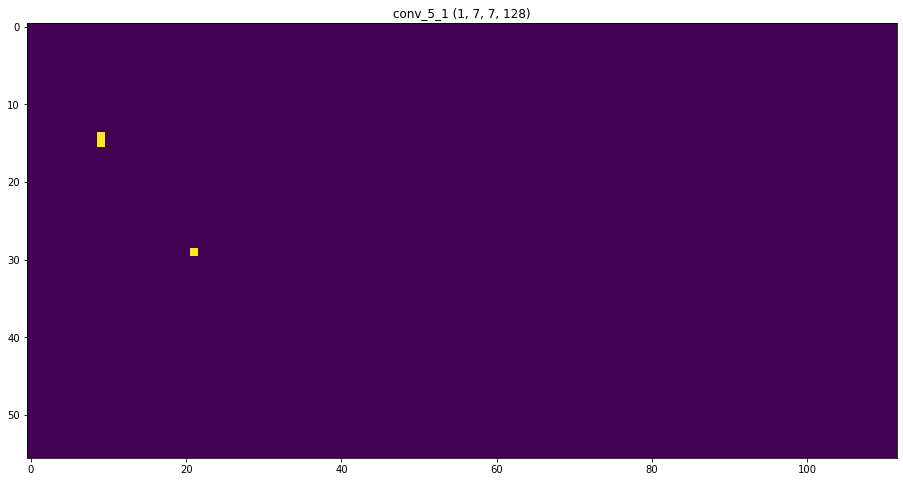

In [232]:
idx_file = 2
input_audio = list_files_misclassified[[idx_file],:,:,:]
print("******** " + list_names_misclassified[idx_file] + " ********")
plt.imshow(list_images_misclassified[idx_file])
print("**********************************")
print_file_activations(input_audio)

### Bonafide file 1

**********************************
(1, 112, 112, 64)
***** Input features *****


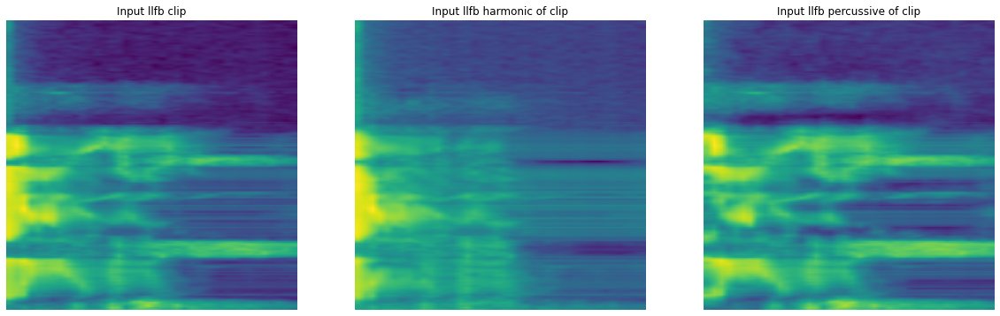

***** Successive Layers Activations *****


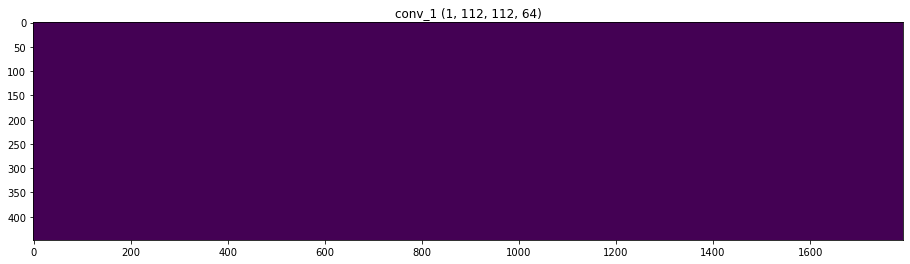

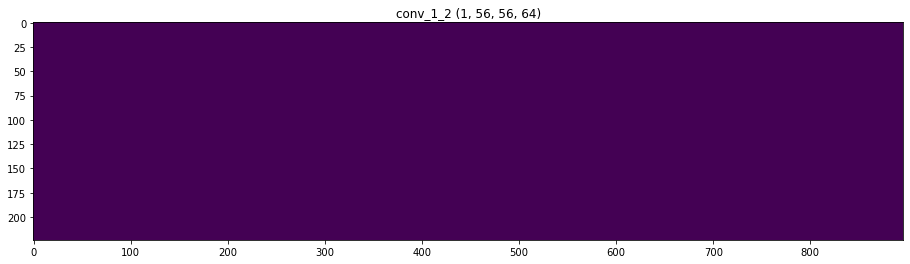

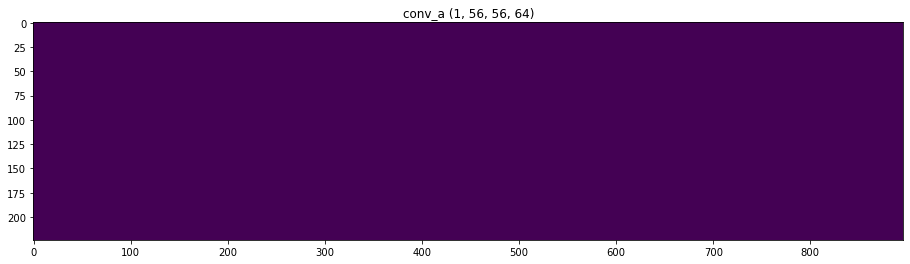

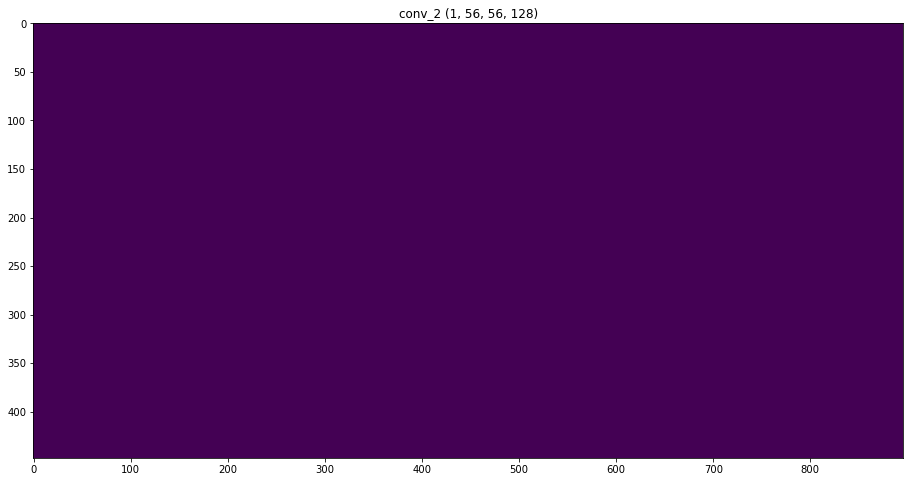

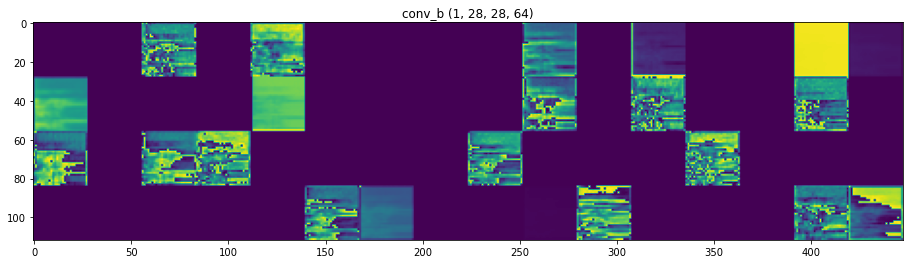

...

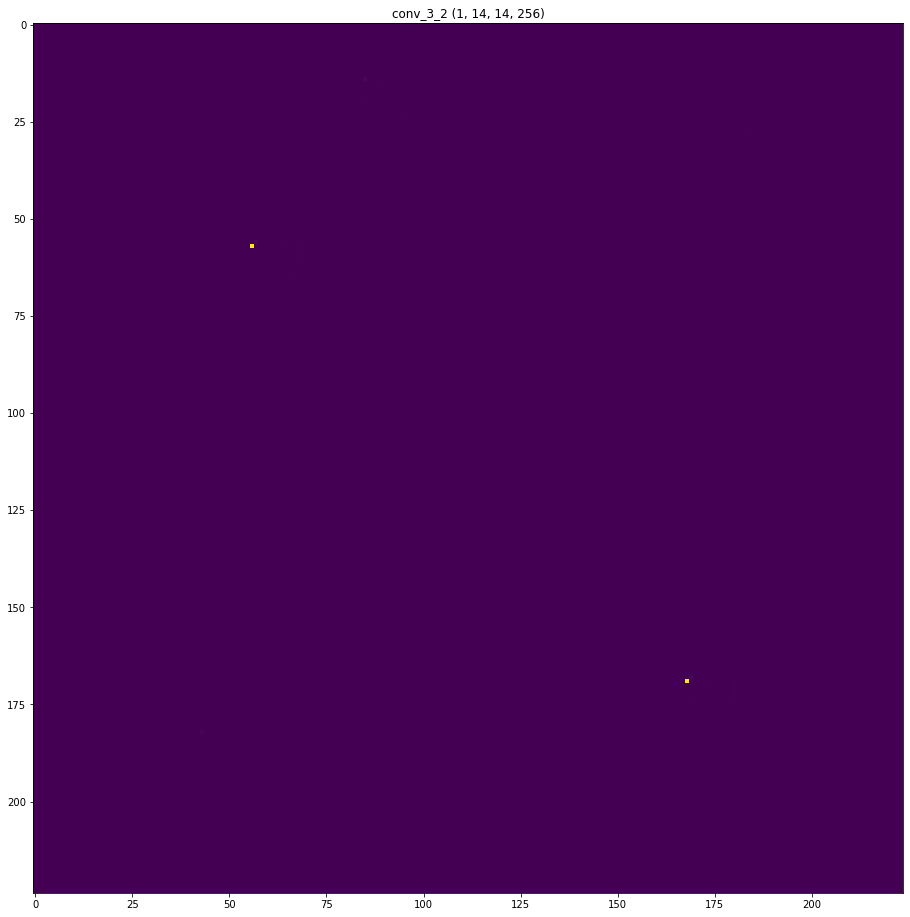

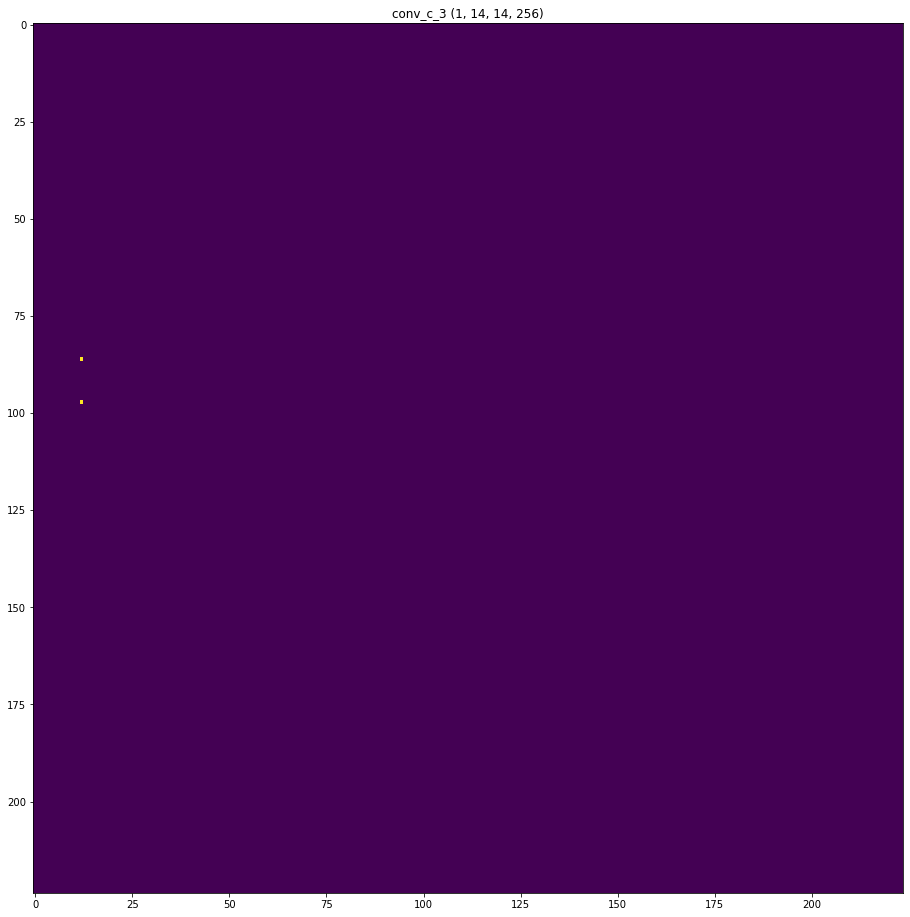

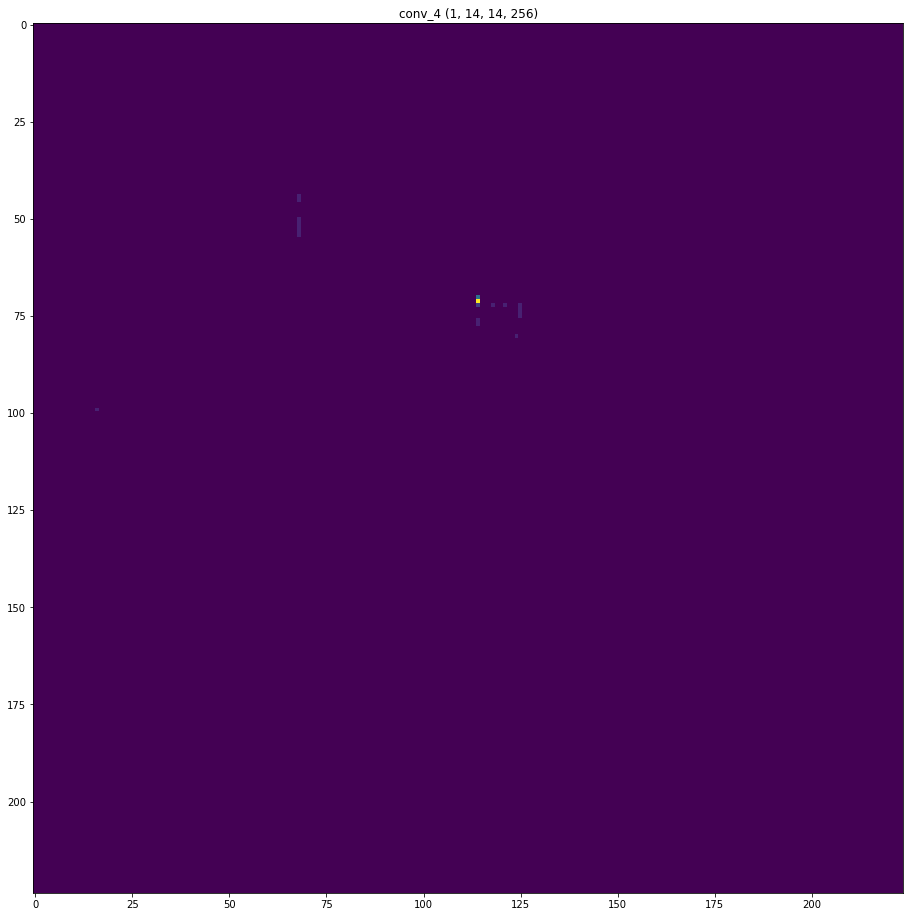

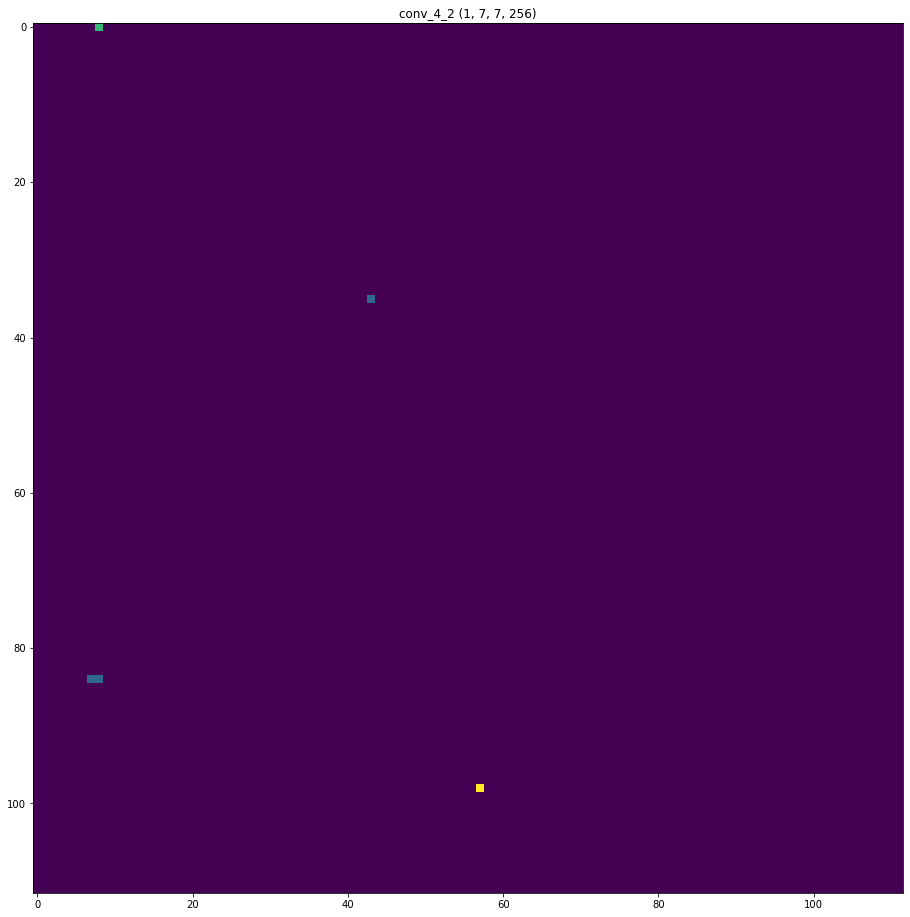

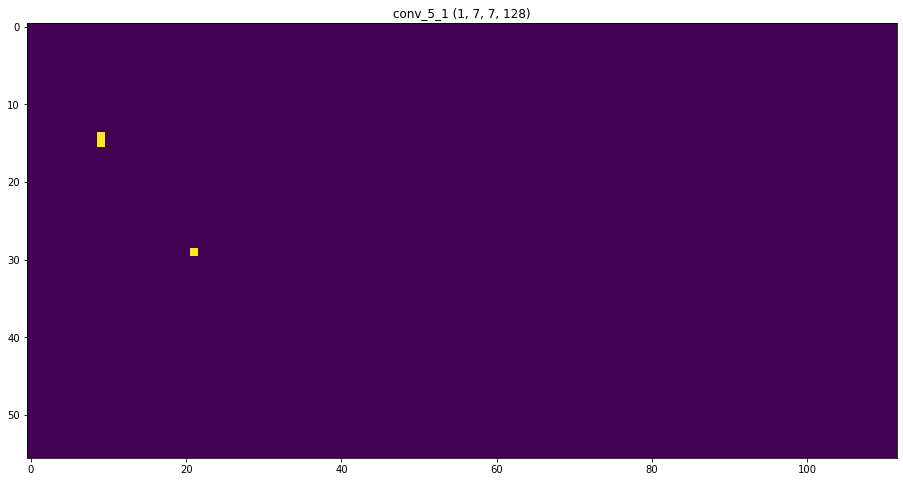

In [236]:
idx_file = 0
input_audio = x_train_normal[[idx_file],:,:,:]
print("**********************************")
print_file_activations(input_audio)

### Bonafide file 2

**********************************
(1, 112, 112, 64)
***** Input features *****


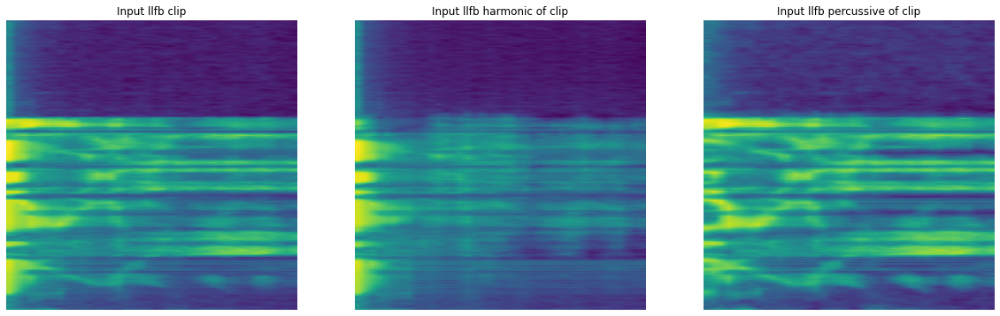

***** Successive Layers Activations *****


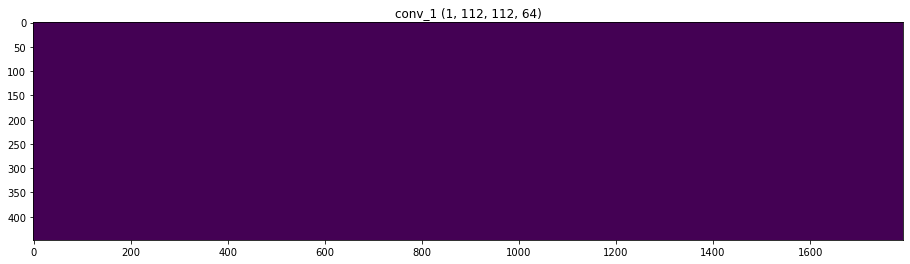

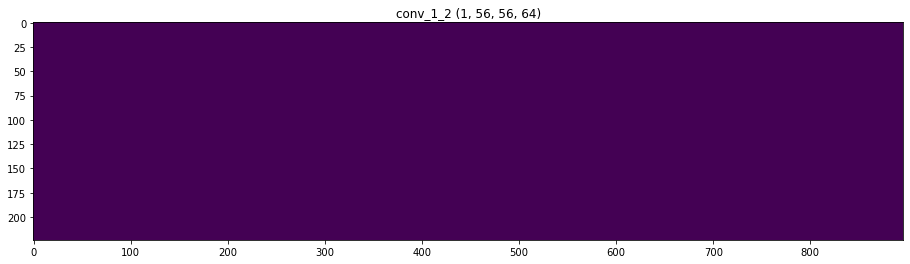

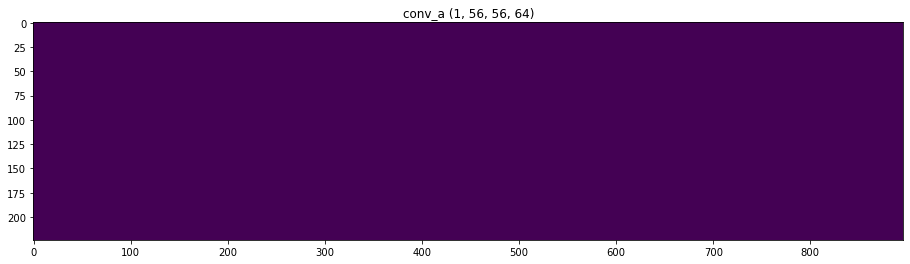

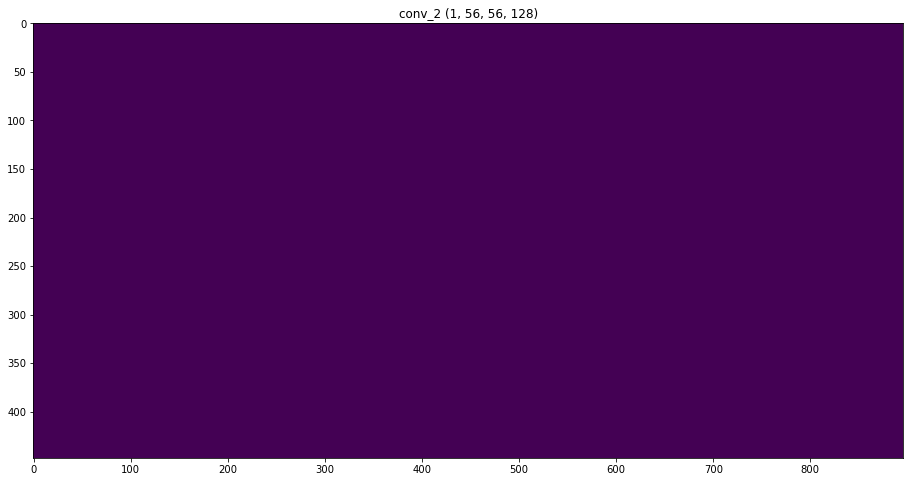

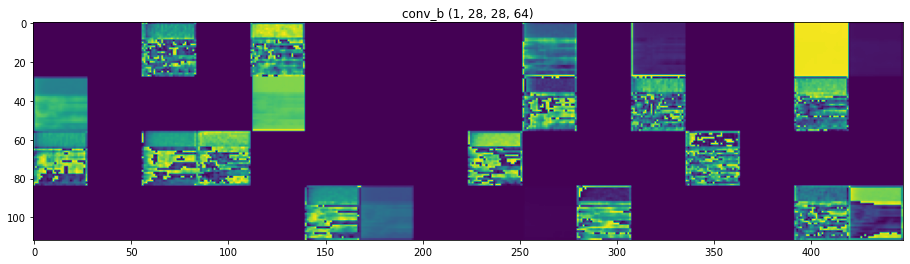

...

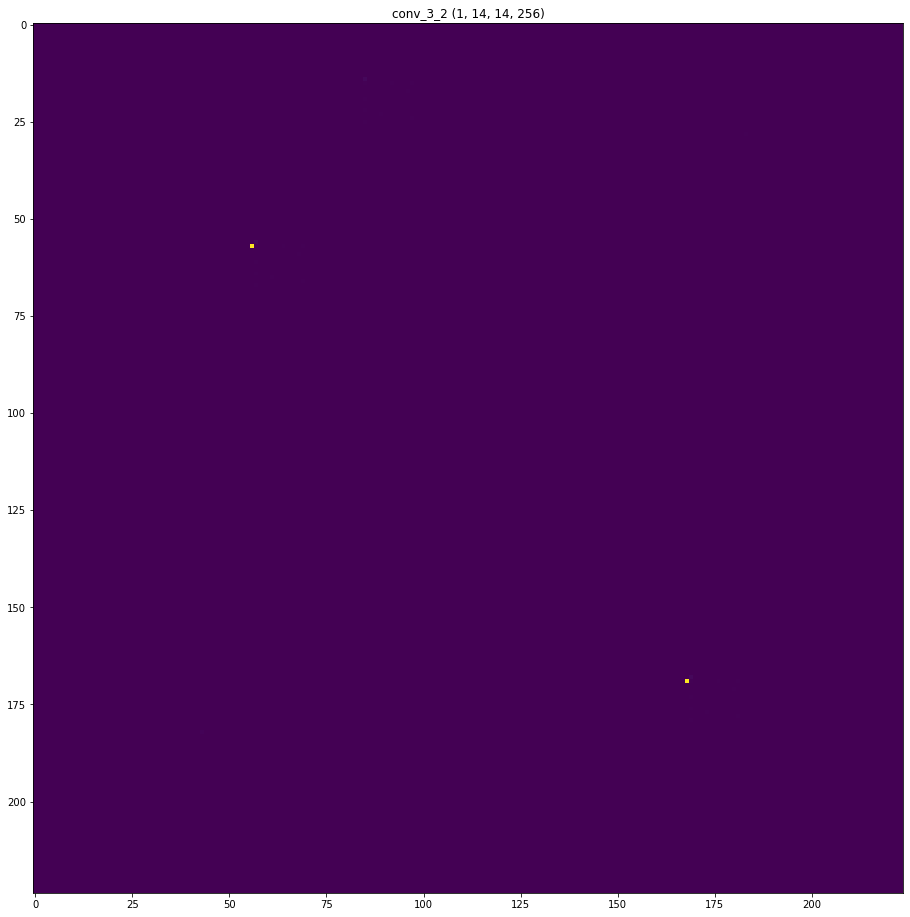

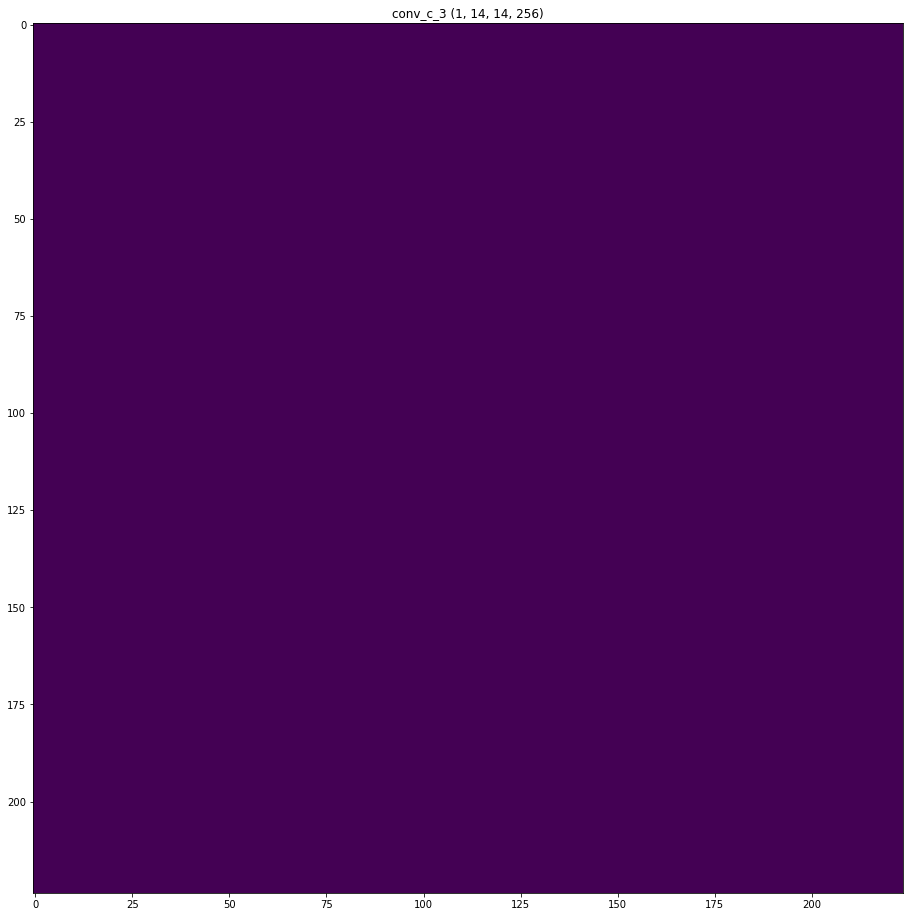

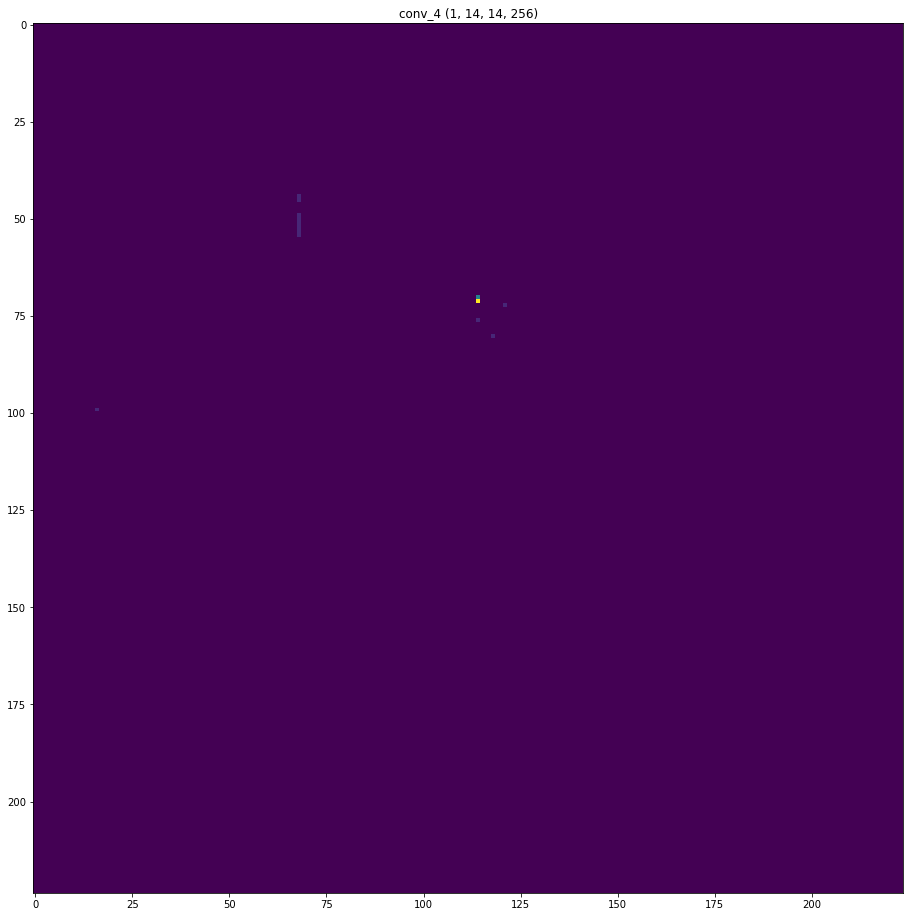

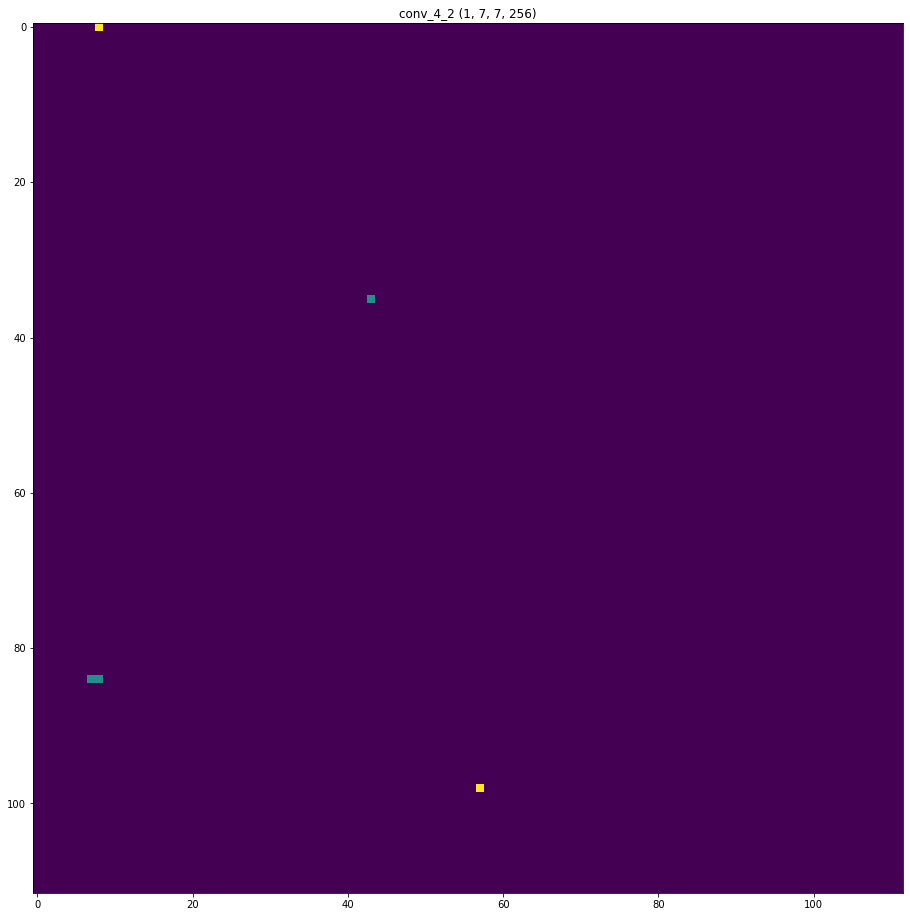

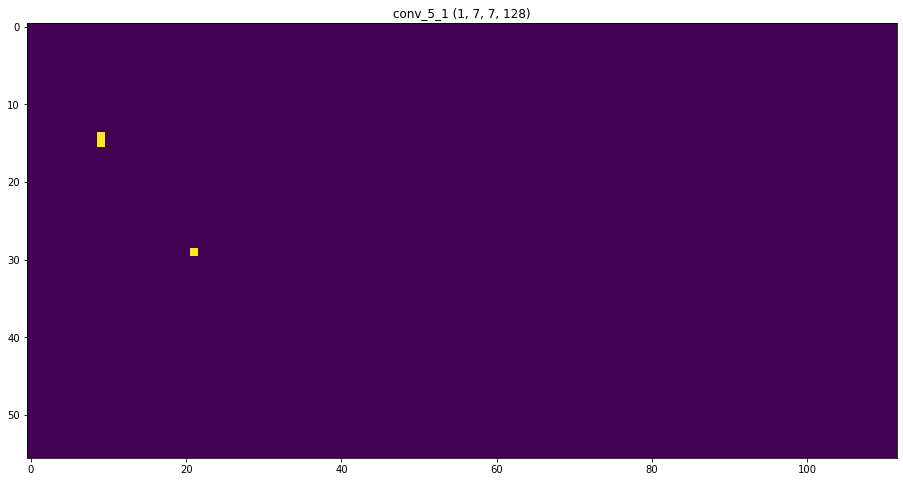

In [237]:
idx_file = 1
input_audio = x_train_normal[[idx_file],:,:,:]
print("**********************************")
print_file_activations(input_audio)

### spoof file 1

**********************************
(1, 112, 112, 64)
***** Input features *****


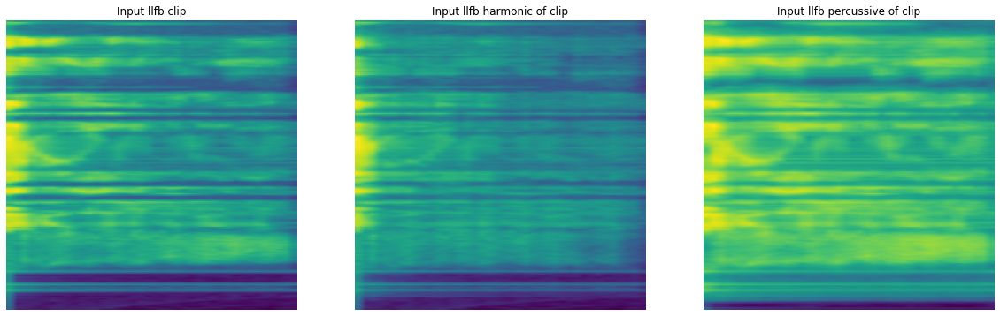

***** Successive Layers Activations *****


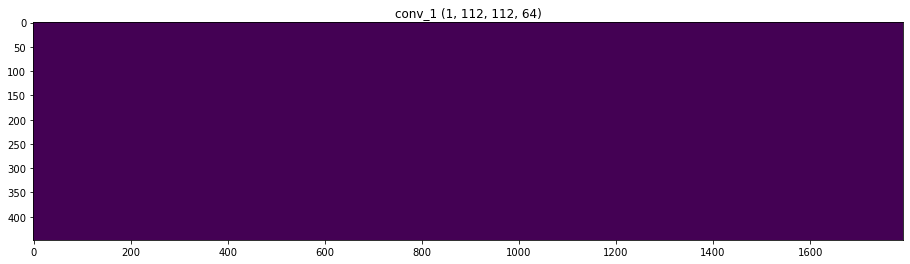

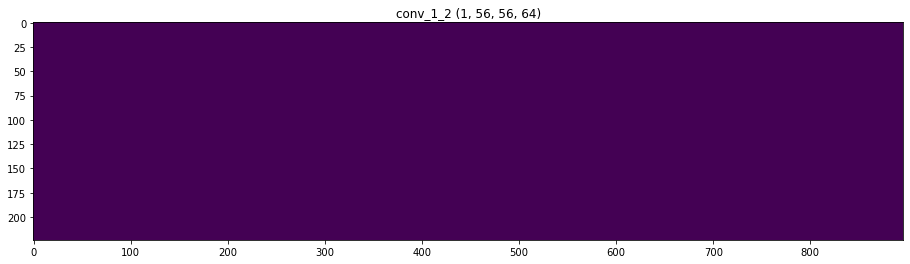

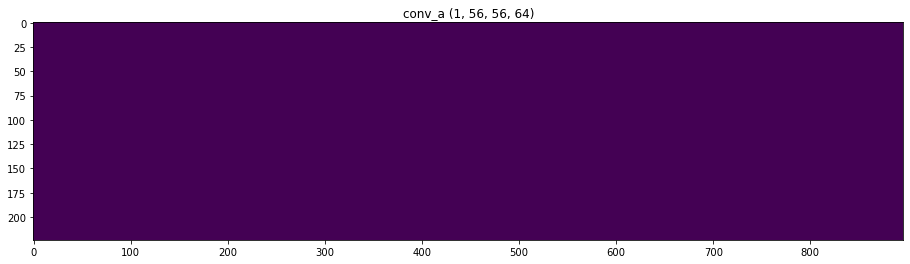

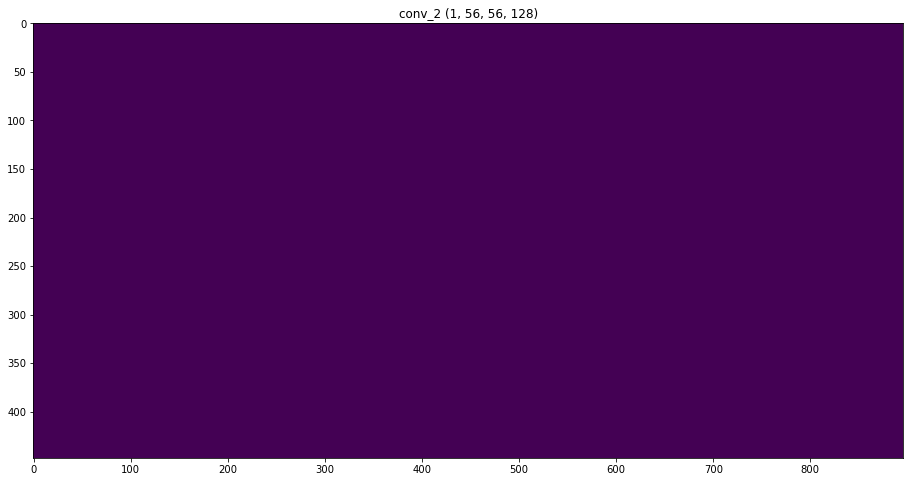

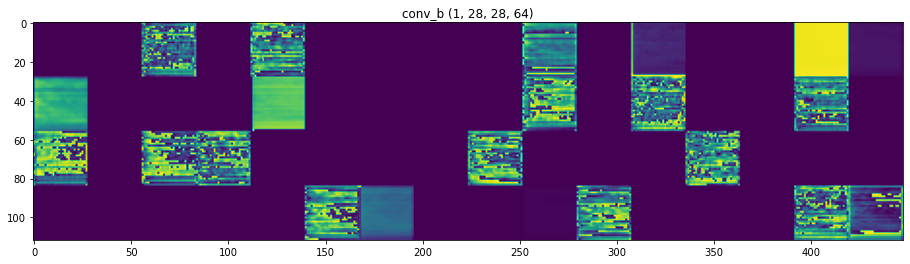

...

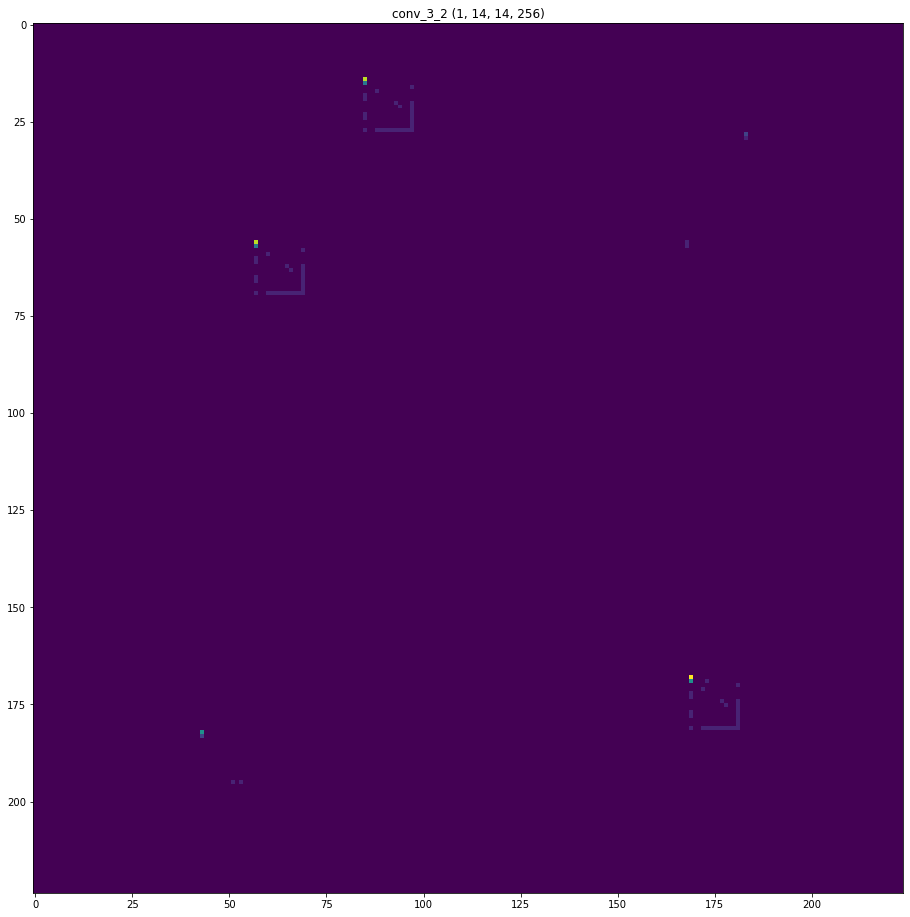

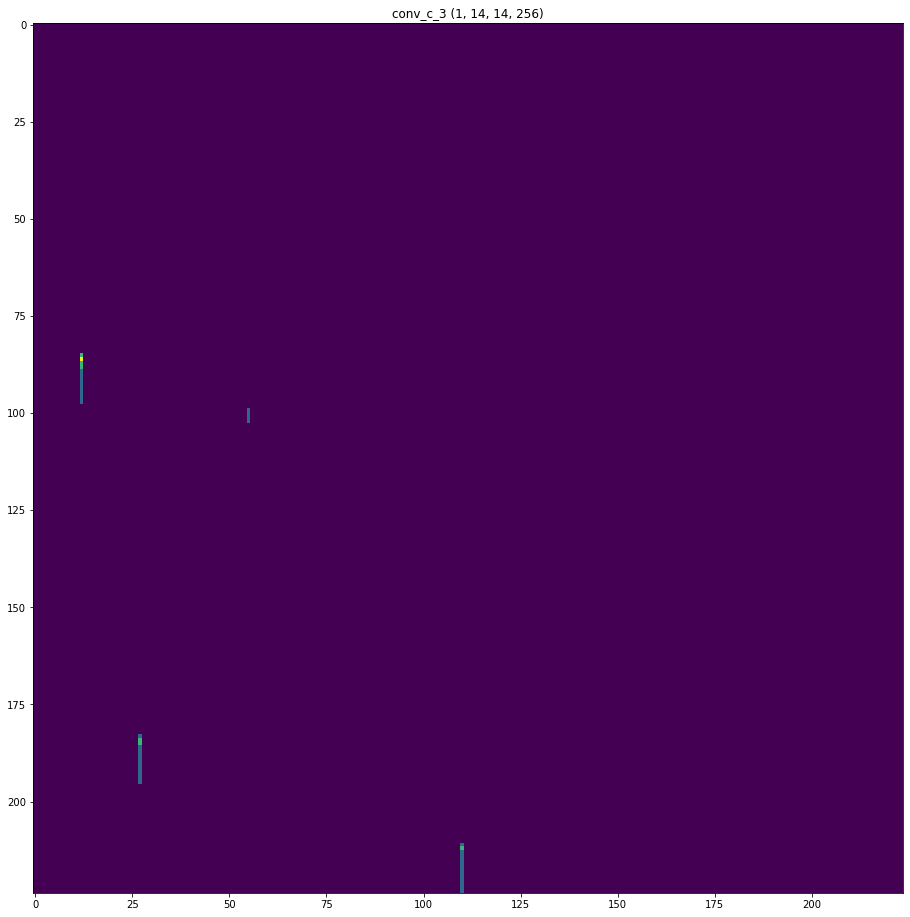

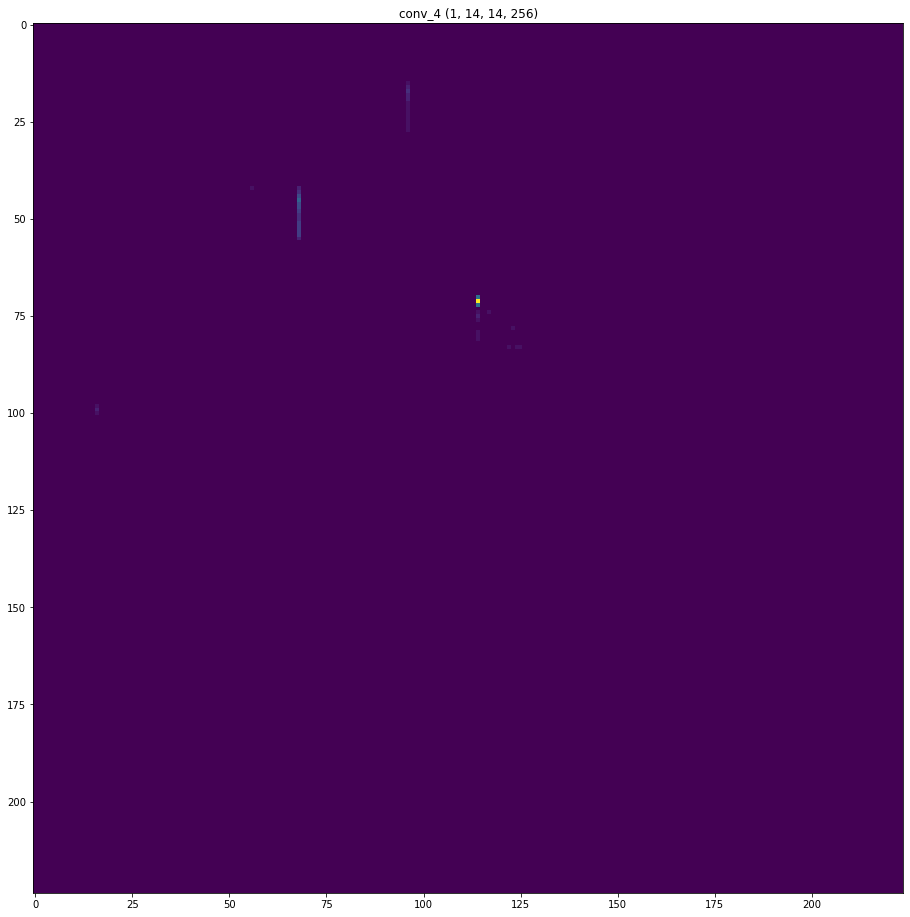

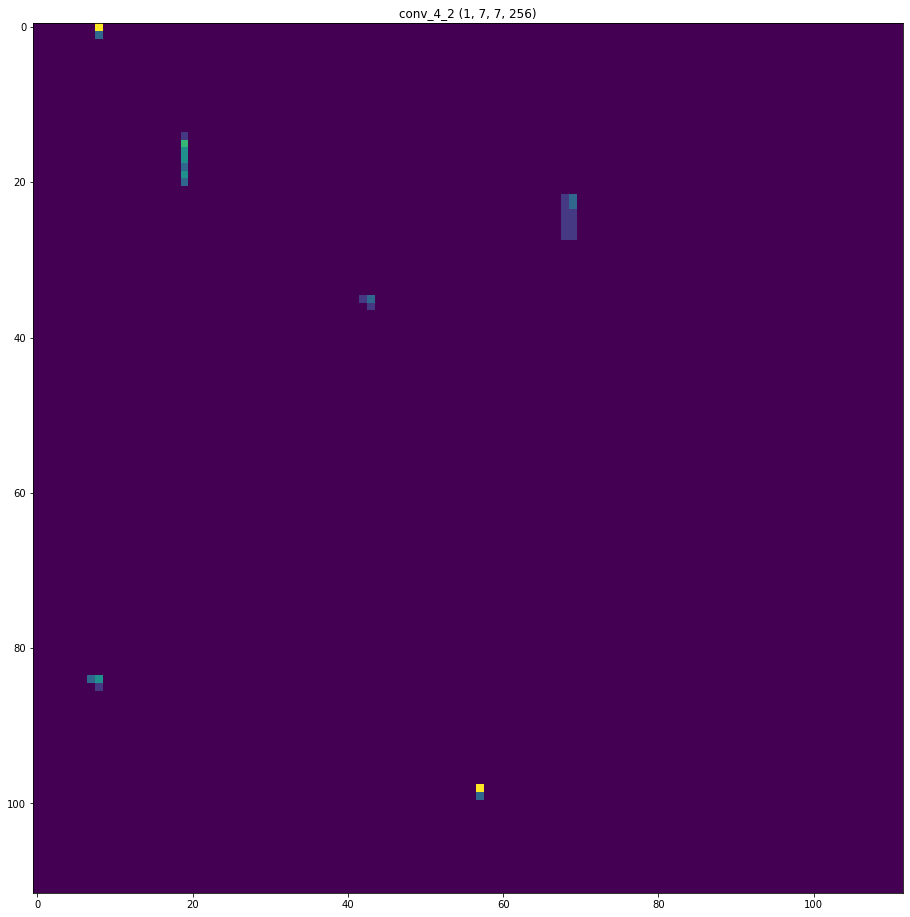

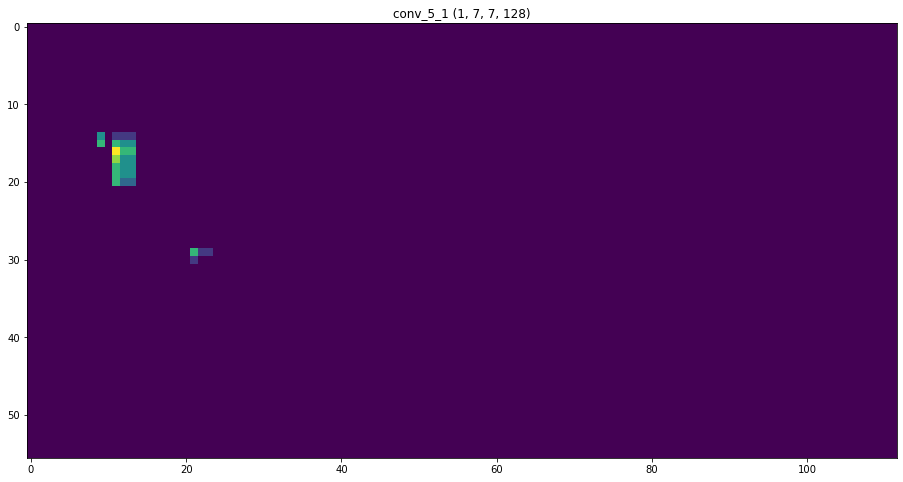

In [238]:
idx_file = 1
input_audio = x_train_anomaly[[idx_file],:,:,:]
print("**********************************")
print_file_activations(input_audio)

### spoof file 2

**********************************
(1, 112, 112, 64)
***** Input features *****


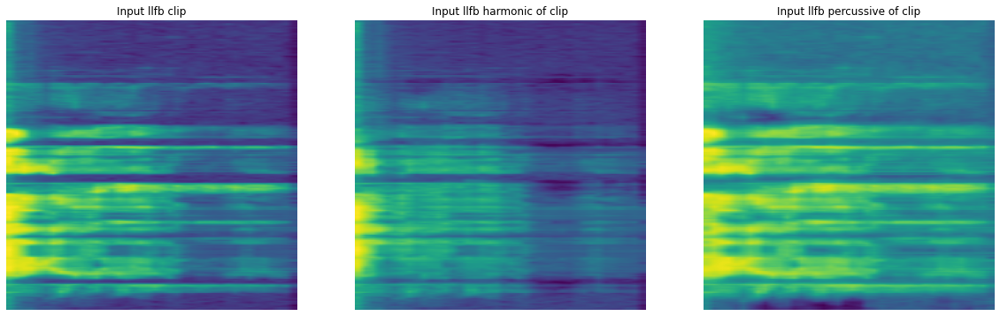

***** Successive Layers Activations *****


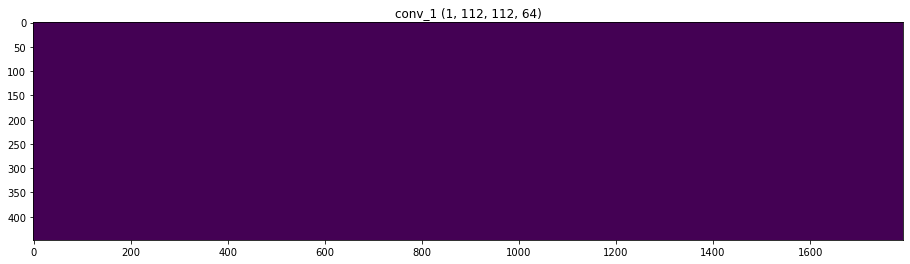

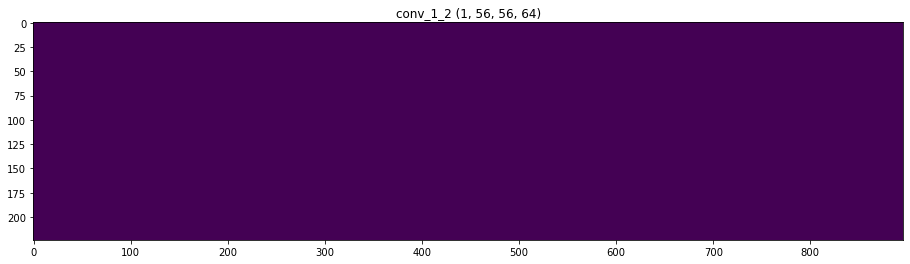

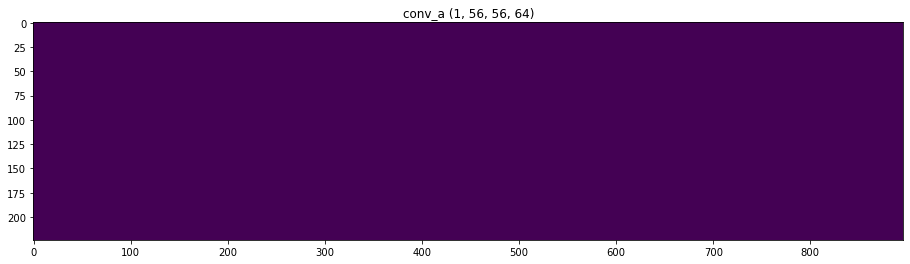

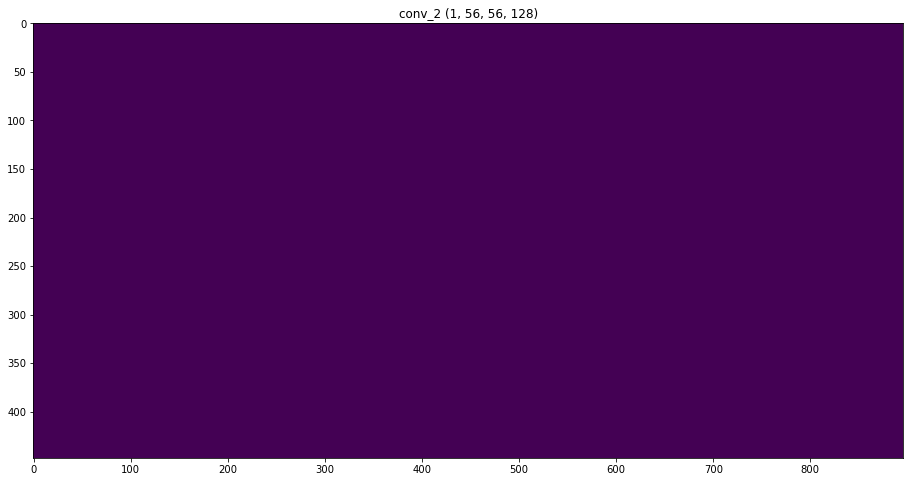

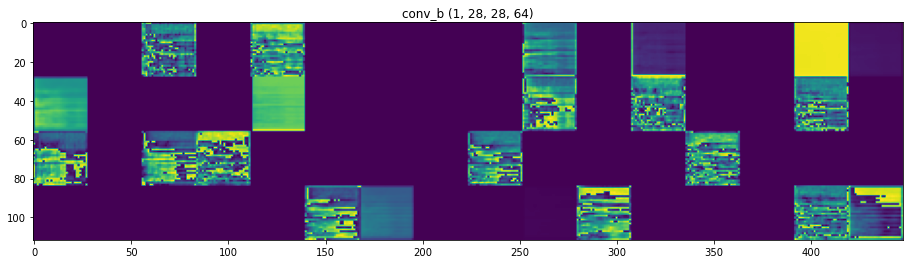

...

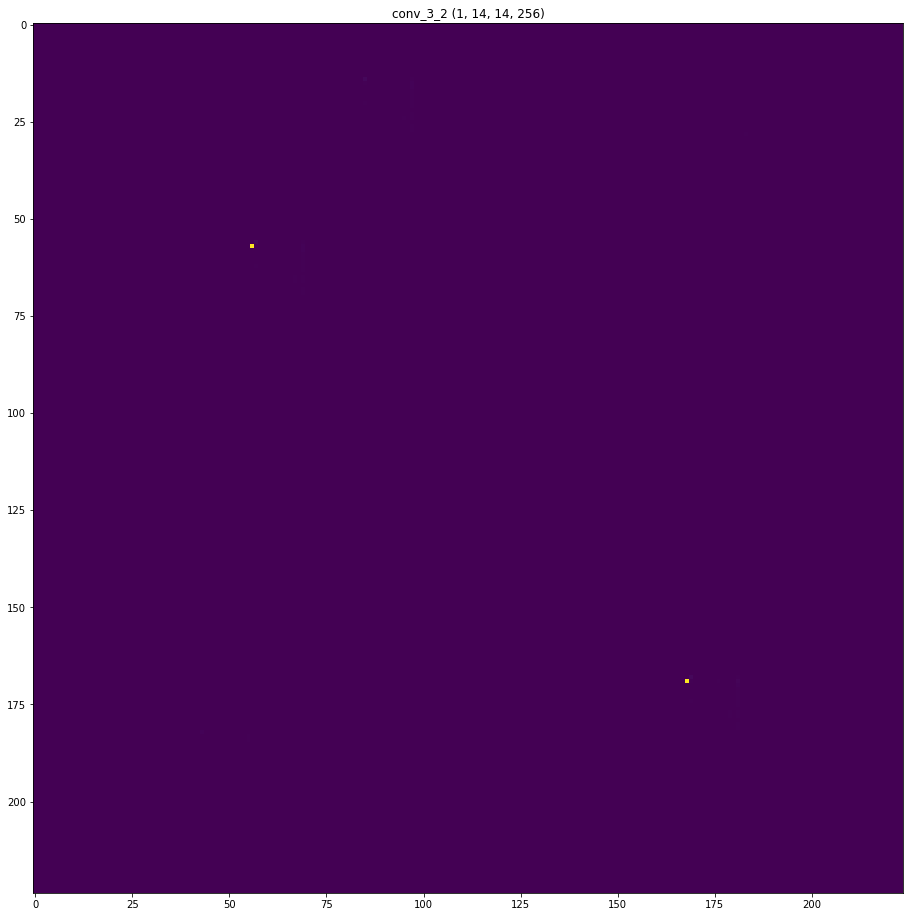

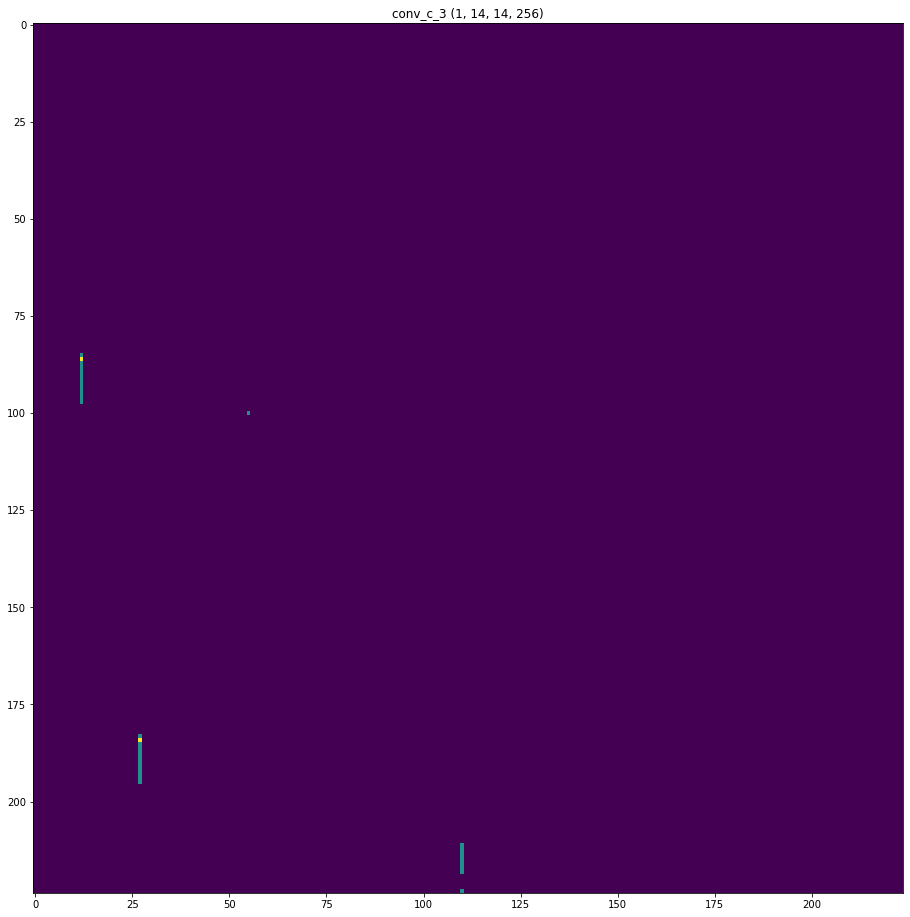

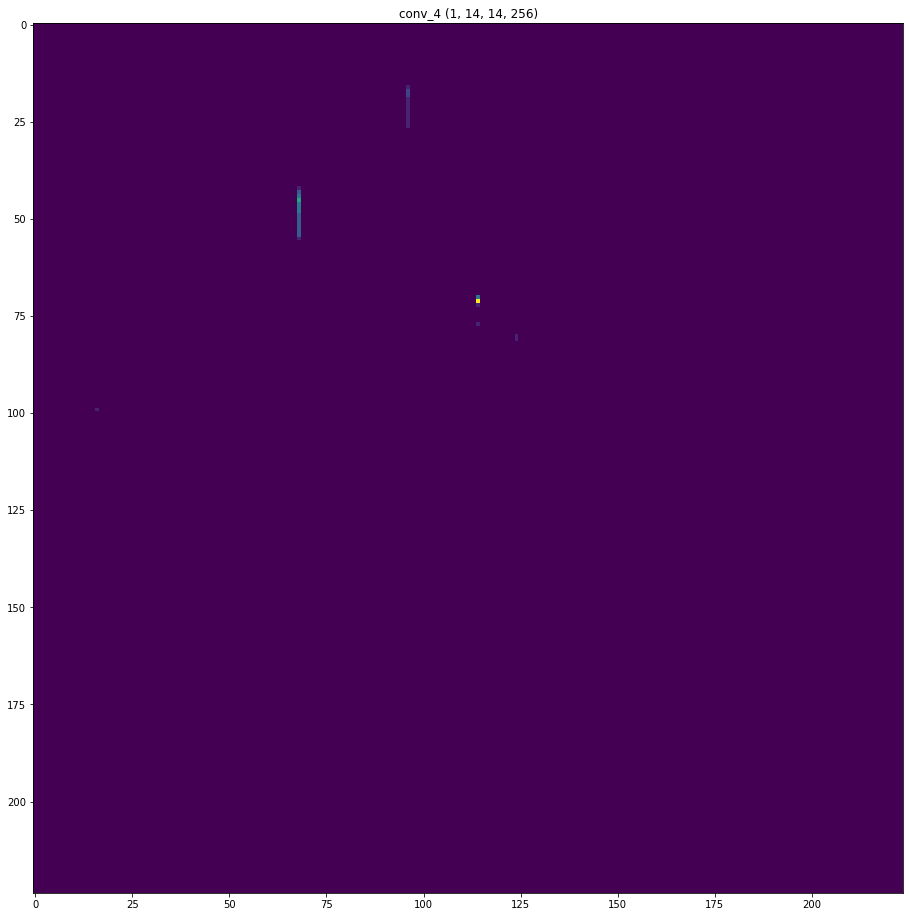

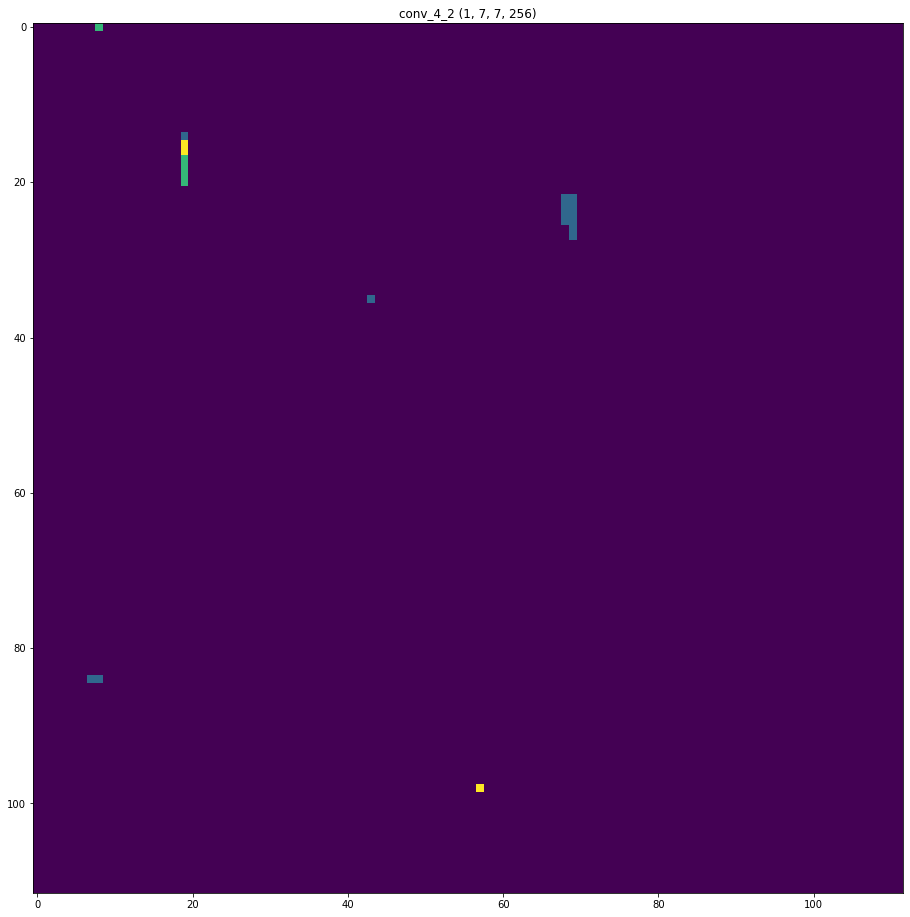

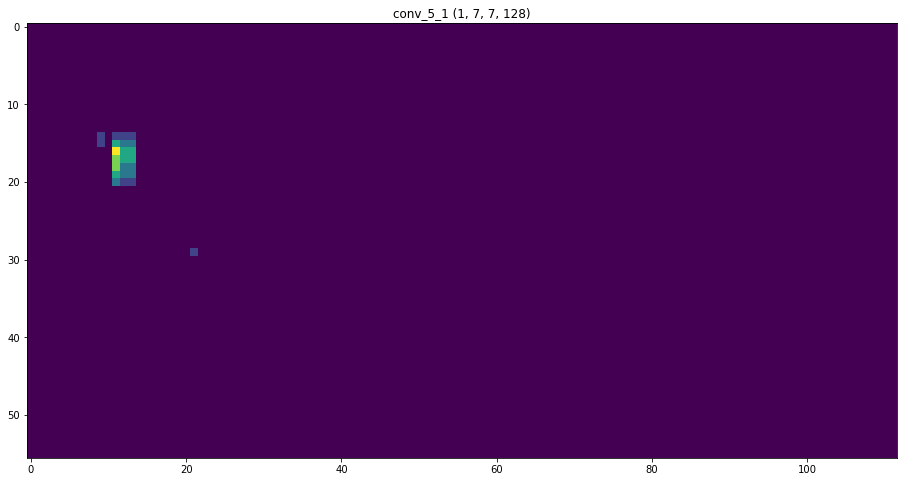

In [239]:
idx_file = 2
input_audio = x_train_anomaly[[idx_file],:,:,:]
print("**********************************")
print_file_activations(input_audio)

### Second test of spoofAugment (Another file)

In [109]:
os.path.join(folder_train_bonafide, random.choice(os.listdir(folder_train_bonafide)))

'./data/train/bonafide/LA_T_3331468.flac'

In [ ]:
#All augmentations
import tarfile, shutil
import zipfile
import sys, os, urllib.request, tarfile, glob
import numpy as np
import cv2
import librosa
import librosa.core
import librosa.feature
import librosa.display 
import matplotlib.pyplot as plt
import random
from utils import *
from data_utils import *
from train_utils import *
import os
import pandas as pd
import soundfile as sf 
import tensorflow as tf
print(tf.version.VERSION)

folder_train_bonafide = './data/train/bonafide'
folder_train_spoofed = './data/train/spoof'
folder_eval_bonafide = './data/eval/bonafide'
folder_eval_spoofed = './data/eval/spoof'

#All augmentations
import os
import soundfile as sf
sample_rate = 16000
downstream_task = True
def resize_spectrogram(x):
    result = cv2.resize(x, (224, 224))
    return result

list_files = []
list_names = []
list_images = []

if downstream_task:

    target = "./data/train/bonafide/LA_T_3331468.flac" #"./data/train/bonafide/LA_T_8173514.flac" #os.path.join(folder_train_bonafide, random.choice(os.listdir(folder_train_bonafide)))
    print(target)
    target = file_load(target)[0]
    list_names.append("original audio")
    list_files.append(target)
    
    img0 = to_img2(target)
    img0 = resize_spectrogram(img0)
    list_images.append(img0)

    img1 = draw_line(img0)

    img2 = add_whitenoise(target, return_audio=True)
    list_files.append(img2)
    list_names.append("add_whitenoise")
    img2 = to_sp(img2)
    img2 = resize_spectrogram(img2)
    list_images.append(img2)

    img3 = add_pinknoise(target, return_audio=True)
    list_files.append(img3)
    list_names.append("add_pinknoise")
    img3 = to_sp(img3)
    img3 = resize_spectrogram(img3)
    list_images.append(img3)

    img4 = average_Hz(img0)
    
    img5 = pitch_shift_audio(target, sample_rate, return_audio=True)
    list_files.append(img5)
    list_names.append("pitch_shift_audio")
    img5 = to_sp(img5)
    img5 = resize_spectrogram(img5)
    list_images.append(img5)

    img6 = time_stretch_audio(target, return_audio=True)
    list_files.append(img6)
    list_names.append("time_stretch_audio")
    img6 = to_sp(img6)
    img6 = resize_spectrogram(img6)
    list_images.append(img6)
    
    img7 = LPC_synthesis_audio1(target, sample_rate, return_audio=True)
    list_files.append(img7)
    list_names.append("LPC_synthesis_audio1")
    img7 = to_sp(img7)
    img7 = resize_spectrogram(img7)
    list_images.append(img7)

    img8 = spectral_distorsion_model_audio(target, return_audio=True)
    list_files.append(img8)
    list_names.append("spectral_distorsion_model_audio")
    img8 = to_sp(img8)
    img8 = resize_spectrogram(img8)
    list_images.append(img8)
    
    img9 = LPC_synthesis_audio2(target, return_audio=True)
    list_files.append(img9)
    list_names.append("LPC_synthesis_audio2")
    img9 = to_sp(img9)
    img9 = resize_spectrogram(img9)
    list_images.append(img9)

    img10 = limiter_audio(target, sample_rate, return_audio=True)
    list_files.append(img10)
    list_names.append("limiter_audio")
    img10 = to_sp(img10)
    img10 = resize_spectrogram(img10)
    list_images.append(img10)
    
    img11 = arctan_compressor_audio(target, sample_rate, return_audio=True)
    list_files.append(img11)
    list_names.append("arctan_compressor_audio")
    img11 = to_sp(img11)
    img11 = resize_spectrogram(img11)
    list_images.append(img11)

    img12 = smooth_spectrum_audio(target, return_audio=True)
    list_files.append(img12)
    list_names.append("smooth_spectrum_audio")
    img12 = to_sp(img12)
    img12 = resize_spectrogram(img12)
    list_images.append(img12)
    
    img13 =specAugment(target, sample_rate=sample_rate, type_augment=4, return_audio=True)
    list_files.append(img13)
    list_names.append("specAugment")
    img13 = to_sp(img13)
    img13 = resize_spectrogram(img13)
    list_images.append(img13)
    
    img14 = smooth_convolve_audio(target, return_audio=True)
    list_files.append(img14)
    list_names.append("smooth_convolve_audio")
    img14 = to_sp(img14)
    img14 = resize_spectrogram(img14)
    list_images.append(img14)
    
    img15 = phase_vocoder_audio(target, return_audio=True)
    list_files.append(img15)
    list_names.append("phase_vocoder_audio")
    img15 = to_sp(img15)
    img15 = resize_spectrogram(img15)
    list_images.append(img15)

    img16 = speed_tune_audio(target, sample_rate, return_audio=True)
    list_files.append(img16)
    list_names.append("speed_tune_audio")
    img16 = to_sp(img16)
    img16 = resize_spectrogram(img16)
    list_images.append(img16)
    
    img17 = Griffin_Lim_vocoder(target, return_audio=True)
    list_files.append(img17)
    list_names.append("Griffin_Lim_vocoder")
    img17 = to_sp(img17)
    img17 = resize_spectrogram(img17)
    list_images.append(img17)

    img18 = subspace_audio(target, return_audio=True)
    list_files.append(img18)
    list_names.append("subspace_audio")
    img18 = to_sp(img18)
    img18 = resize_spectrogram(img18)
    list_images.append(img18)
    
    img19 = iterative_wiener_audio(target, return_audio=True)
    list_files.append(img19)
    list_names.append("iterative_wiener_audio")
    img19 = to_sp(img19)
    img19 = resize_spectrogram(img19)
    list_images.append(img19)

    img20 = spectral_subtraction_audio(target, return_audio=True)
    list_files.append(img20)
    list_names.append("spectral_subtraction_audio")
    img20 = to_sp(img20)
    img20 = resize_spectrogram(img20)
    list_images.append(img20)
    
    target2 = os.path.join(folder_train_bonafide, random.choice(os.listdir(folder_train_bonafide)))
    target2, _ = sf.read(target2)
    img21 = mix_audios(target, target2, return_audio=True)
    list_files.append(img21)
    list_names.append("mix_audios")
    img21 = to_sp(img21)
    img21 = resize_spectrogram(img21)
    list_images.append(img21)
    
    img22 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img22)
    list_names.append("apply_sequential_transforms")
    img22 = to_sp(img22)
    img22 = resize_spectrogram(img22)
    list_images.append(img22)
    
    img23 = butterworth_sound_filter(target, sample_rate, return_audio=True)
    list_files.append(img23)
    list_names.append("butterworth_sound_filter")
    img23 = to_sp(img23)
    img23 = resize_spectrogram(img23)
    list_images.append(img23)
                             
    img24 = checkerboard_patterns(target, sample_rate, return_audio=True)
    list_files.append(img24)
    list_names.append("checkerboard_patterns")
    img24 = to_sp(img24)
    img24 = resize_spectrogram(img24)
    list_images.append(img24)
    
    img25 = mel_to_stft_griffinLim(target, sample_rate, return_audio=True)
    list_files.append(img25)
    list_names.append("mel_to_stft_griffinLim")
    img25 = to_sp(img25)
    img25 = resize_spectrogram(img25)
    list_images.append(img25)
    
    img26 = specAugment(target, sample_rate=sample_rate, type_augment=3, return_audio=True)
    list_files.append(img26)
    list_names.append("sparse_warp")
    img26 = to_sp(img26)
    img26 = resize_spectrogram(img26)
    list_images.append(img26)
    
    img27 = specAugment(target, sample_rate=sample_rate, type_augment=2, return_audio=True)
    list_files.append(img27)
    list_names.append("frequency_masking")
    img27 = to_sp(img27)
    img27 = resize_spectrogram(img27)
    list_images.append(img27)
    
    img28 = specAugment(target, sample_rate=sample_rate, type_augment=1, return_audio=True)
    list_files.append(img28)
    list_names.append("time_masking")
    img28 = to_sp(img28)
    img28 = resize_spectrogram(img28)
    list_images.append(img28)
    
    img29 = reverberance_audio(target, sample_rate=sample_rate, return_audio=True)
    list_files.append(img29)
    list_names.append("reverberance_audio")
    img29 = to_sp(img29)
    img29 = resize_spectrogram(img29)
    list_images.append(img29)
    
    img30 = specAugment(target, sample_rate=sample_rate, type_augment=4, return_audio=True)
    list_files.append(img30)
    list_names.append("specAugment")
    img30 = to_sp(img30)
    img30 = resize_spectrogram(img30)
    list_images.append(img30)
    
    img31 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img31)
    list_names.append("apply_sequential_transforms")
    img31 = to_sp(img31)
    img31 = resize_spectrogram(img31)
    list_images.append(img31)
    
    img32 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img32)
    list_names.append("apply_sequential_transforms")
    img32 = to_sp(img32)
    img32 = resize_spectrogram(img32)
    list_images.append(img32)
    
    img33 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img33)
    list_names.append("apply_sequential_transforms")
    img33 = to_sp(img33)
    img33 = resize_spectrogram(img33)
    list_images.append(img33)
    
    img34 = apply_sequential_transforms(target, sample_rate, return_audio=True)
    list_files.append(img34)
    list_names.append("apply_sequential_transforms")
    img34 = to_sp(img34)
    img34 = resize_spectrogram(img34)
    list_images.append(img34)
    

    plt.figure(figsize=(20,20))
    plt.subplot(7,5,1)
    plt.axis("off")
    plt.title("Original bonafide audio")
    plt.imshow(img0)

    plt.subplot(7,5,2)
    plt.axis("off")
    plt.title("slight line")
    plt.imshow(img1)

    plt.subplot(7,5,3)
    plt.axis("off")
    plt.title("add white noise")
    plt.imshow(img2)

    plt.subplot(7,5,4)
    plt.axis("off")
    plt.title("add pink noise")
    plt.imshow(img3)

    plt.subplot(7,5,5)
    plt.axis("off")
    plt.title("average Hz")
    plt.imshow(img4)
    
    plt.subplot(7,5,6)
    plt.axis("off")
    plt.title("pitch_shift")
    plt.imshow(img5)

    plt.subplot(7,5,7)
    plt.axis("off")
    plt.title("time_stretch")
    plt.imshow(img6)

    plt.subplot(7,5,8)
    plt.axis("off")
    plt.title("LPC_synthesis1")
    plt.imshow(img7)

    plt.subplot(7,5,9)
    plt.axis("off")
    plt.title("spectral_distorsion_model")
    plt.imshow(img8)

    plt.subplot(7,5,10)
    plt.axis("off")
    plt.title("LPC_synthesis2")
    plt.imshow(img9)
    
    plt.subplot(7,5,11)
    plt.axis("off")
    plt.title("limiter_audio")
    plt.imshow(img10)

    plt.subplot(7,5,12)
    plt.axis("off")
    plt.title("arctan_compressor")
    plt.imshow(img11)

    plt.subplot(7,5,13)
    plt.axis("off")
    plt.title("smooth_spectrum")
    plt.imshow(img12)

    plt.subplot(7,5,14)
    plt.axis("off")
    plt.title("spec_augment")
    plt.imshow(img13)

    plt.subplot(7,5,15)
    plt.axis("off")
    plt.title("smooth_convolve")
    plt.imshow(img14)
    
    plt.subplot(7,5,16)
    plt.axis("off")
    plt.title("phase_vocoder")
    plt.imshow(img15)

    plt.subplot(7,5,17)
    plt.axis("off")
    plt.title("speed_tune")
    plt.imshow(img16)

    plt.subplot(7,5,18)
    plt.axis("off")
    plt.title("Griffin_Lim_vocoder")
    plt.imshow(img17)

    plt.subplot(7,5,19)
    plt.axis("off")
    plt.title("subspace")
    plt.imshow(img18)

    plt.subplot(7,5,20)
    plt.axis("off")
    plt.title("iterative_wiener")
    plt.imshow(img19)
    
    plt.subplot(7,5,21)
    plt.axis("off")
    plt.title("spectral_subtraction")
    plt.imshow(img20)

    plt.subplot(7,5,22)
    plt.axis("off")
    plt.title("mix_audios")
    plt.imshow(img21)
    
    plt.subplot(7,5,23)
    plt.axis("off")
    plt.title("sequential_transforms")
    plt.imshow(img22)
    
    plt.subplot(7,5,24)
    plt.axis("off")
    plt.title("butterworth_filter")
    plt.imshow(img23)

    plt.subplot(7,5,25)
    plt.axis("off")
    plt.title("checkerboard_patterns")
    plt.imshow(img24)
    
    plt.subplot(7,5,26)
    plt.axis("off")
    plt.title("mel_to_stft_griffinLim")
    plt.imshow(img25)
    
    plt.subplot(7,5,27)
    plt.axis("off")
    plt.title("sparse_warp")
    plt.imshow(img26)
    
    plt.subplot(7,5,28)
    plt.axis("off")
    plt.title("frequency_masking")
    plt.imshow(img27)
    
    plt.subplot(7,5,29)
    plt.axis("off")
    plt.title("time_masking")
    plt.imshow(img28)
    
    plt.subplot(7,5,30)
    plt.axis("off")
    plt.title("reverberance")
    plt.imshow(img29)
    
    plt.subplot(7,5,31)
    plt.axis("off")
    plt.title("spec_augment")
    plt.imshow(img30)
    
    plt.subplot(7,5,32)
    plt.axis("off")
    plt.title("random sequential_transform")
    plt.imshow(img31)
    
    plt.subplot(7,5,33)
    plt.axis("off")
    plt.title("random sequential_transform")
    plt.imshow(img32)
    
    plt.subplot(7,5,34)
    plt.axis("off")
    plt.title("random sequential_transform")
    plt.imshow(img33)
    
    plt.subplot(7,5,35)
    plt.axis("off")
    plt.title("random sequential_transform")
    plt.imshow(img34)
    
    
    
    #plt.savefig('Spoof_Augmentations_investigation.png')
    #plt.savefig('Spoof_Augmentations_investigation.pdf')
    plt.show()

In [111]:
list_files = np.array(list_files)
list_files = to_img(list_files, features=features_type)

list_files = (list_files-min_)/(max_-min_)

list_files = (list_files*255-mean)/sigma

if features_type not in ['fbanks_delta_doubledelta', 'HPSS_power', 'HPSS_stft', 'HPSS_llfb', 'HPSS_decompose_audio', 'HPSS_llfb_doubledelta']:
    list_files = np.expand_dims(list_files, axis=-1)
print("#list_files.shape: ", list_files.shape)

/tmp/ipykernel_90836/71538982.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  list_files = np.array(list_files)


#list_files.shape:  (33, 224, 224, 3)


In [113]:
print(len(list_names))

33


In [114]:
print(list_names)

['original audio', 'add_whitenoise', 'add_pinknoise', 'pitch_shift_audio', 'time_stretch_audio', 'LPC_synthesis_audio1', 'spectral_distorsion_model_audio', 'LPC_synthesis_audio2', 'limiter_audio', 'arctan_compressor_audio', 'smooth_spectrum_audio', 'specAugment', 'smooth_convolve_audio', 'phase_vocoder_audio', 'speed_tune_audio', 'Griffin_Lim_vocoder', 'subspace_audio', 'iterative_wiener_audio', 'spectral_subtraction_audio', 'mix_audios', 'apply_sequential_transforms', 'butterworth_sound_filter', 'checkerboard_patterns', 'mel_to_stft_griffinLim', 'sparse_warp', 'frequency_masking', 'time_masking', 'reverberance_audio', 'specAugment', 'apply_sequential_transforms', 'apply_sequential_transforms', 'apply_sequential_transforms', 'apply_sequential_transforms']


In [115]:
y_total = np.zeros(len(list_names), dtype=int)
y_total[1:] = 1
y_dev_total_categ = keras.utils.to_categorical(y_total)
print(y_dev_total_categ)

[[1. 0.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]
 [0. 1.]]


In [116]:
# Evaluate the model on the dev data using `evaluate`
print("Evaluate on dev data")
dev_results = model.evaluate([list_files, y_dev_total_categ], y_dev_total_categ)#, steps=STEPS_PER_EPOCH_DEV)#batch_size=32)
print("dev loss, dev acc:", dev_results)

Evaluate on dev data
2/2 [==============================] - 0s 26ms/step - loss: 18.7174 - accuracy: 0.4242
dev loss, dev acc: [18.71735954284668, 0.42424243688583374]


In [117]:
print("Generate predictions")
dev_predictions = model.predict([list_files, y_dev_total_categ])#, steps=STEPS_PER_EPOCH_DEV)
print("predictions shape:", dev_predictions.shape)
print(dev_predictions)

Generate predictions
predictions shape: (33, 2)
[[1.00000000e+00 9.01643825e-18]
 [1.00000000e+00 1.66688838e-17]
 [1.00000000e+00 1.09738363e-17]
 [7.19522560e-18 1.00000000e+00]
 [1.00000000e+00 1.54707491e-17]
 [1.00000000e+00 9.36694611e-10]
 [1.00000000e+00 8.53131833e-18]
 [1.00000000e+00 8.95467102e-18]
 [9.99998212e-01 1.79992958e-06]
 [9.87533450e-01 1.24664782e-02]
 [7.29855948e-18 1.00000000e+00]
 [1.76961333e-18 1.00000000e+00]
 [6.65409602e-16 1.00000000e+00]
 [1.00000000e+00 1.22672556e-17]
 [6.62145816e-12 1.00000000e+00]
 [1.00000000e+00 9.80578693e-18]
 [6.69685864e-14 1.00000000e+00]
 [4.79323620e-18 1.00000000e+00]
 [1.00000000e+00 8.31191115e-18]
 [9.93144512e-01 6.85554324e-03]
 [1.15178233e-17 1.00000000e+00]
 [1.06429442e-17 1.00000000e+00]
 [1.00000000e+00 8.69593389e-18]
 [1.00000000e+00 8.11407105e-18]
 [1.07115874e-07 9.99999881e-01]
 [1.00000000e+00 1.33082615e-17]
 [3.53620241e-16 1.00000000e+00]
 [1.00000000e+00 9.31081611e-18]
 [9.89121814e-18 1.00000000e

In [118]:
mask_files = [(y[1]>y[0]) for y in dev_predictions]
mask_files[0] = dev_predictions[0][0] > dev_predictions[0][1]
mask_files

[True,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 True,
 True,
 True,
 False,
 True,
 False,
 True,
 True,
 False,
 False,
 True,
 True,
 False,
 False,
 True,
 False,
 True,
 False,
 True,
 False,
 False,
 False,
 True]

In [119]:
print(list_files.shape)

(33, 224, 224, 3)


In [120]:
mask_files_misclassified = [not elem for elem in mask_files]

In [121]:
list_files_misclassified = list_files[mask_files_misclassified,:,:,:]

In [122]:
list_names_misclassified = [x for x, y in zip(list_names, mask_files_misclassified) if y == True]
print(len(list_names_misclassified))

19


In [123]:
list_images_misclassified = [x for x, y in zip(list_images, mask_files_misclassified) if y == True]
print(np.array(list_images_misclassified).shape)

(19, 224, 224)


In [124]:
list_files = list_files[mask_files,:,:,:]

In [125]:
list_names = [x for x, y in zip(list_names, mask_files) if y == True]
print(len(list_names))

14


In [126]:
print(list_names)

['original audio', 'pitch_shift_audio', 'smooth_spectrum_audio', 'specAugment', 'smooth_convolve_audio', 'speed_tune_audio', 'subspace_audio', 'iterative_wiener_audio', 'apply_sequential_transforms', 'butterworth_sound_filter', 'sparse_warp', 'time_masking', 'specAugment', 'apply_sequential_transforms']


In [127]:
print(list_files.shape)

(14, 224, 224, 3)


In [128]:
list_images = [x for x, y in zip(list_images, mask_files) if y == True]
print(np.array(list_images).shape)

(14, 224, 224)


### Display original bonafide audio versus other spoof augmentations of same bonafide audio

******** original audio ********
**********************************
(1, 112, 112, 64)
***** Input features *****


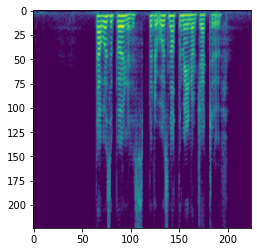

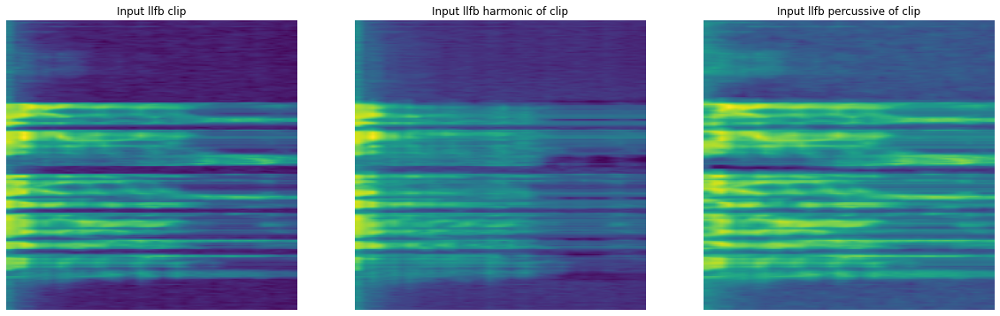

***** Successive Layers Activations *****


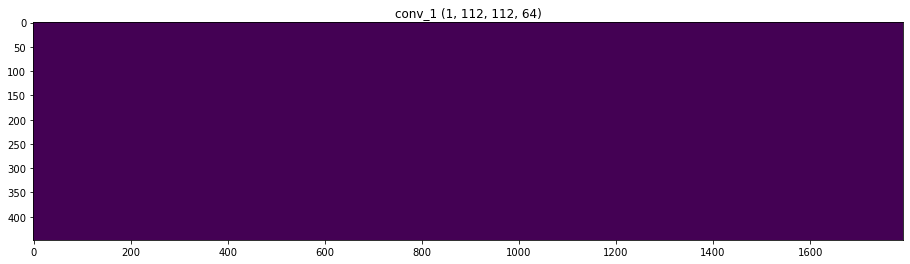

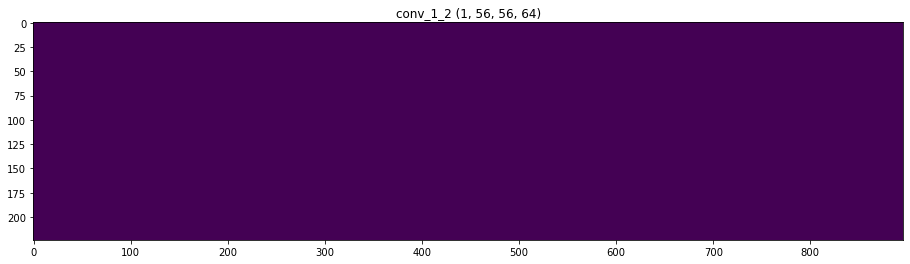

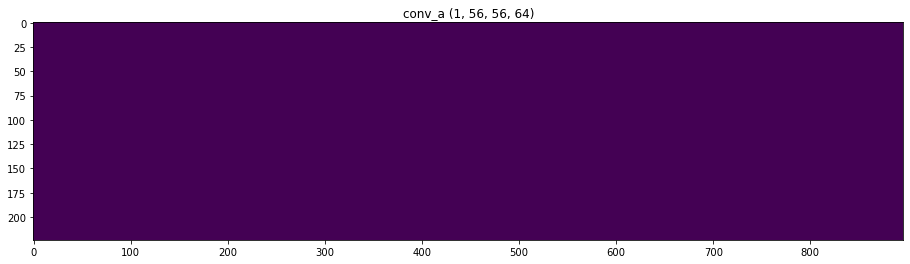

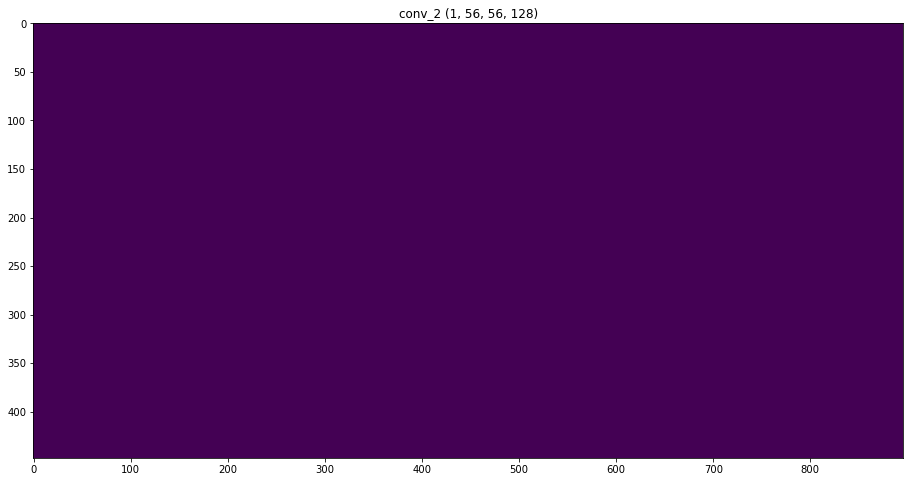

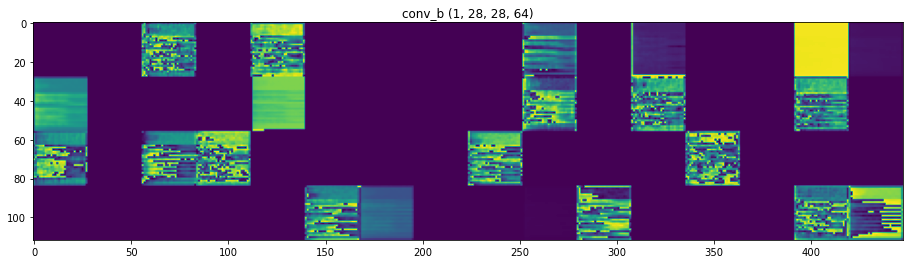

...

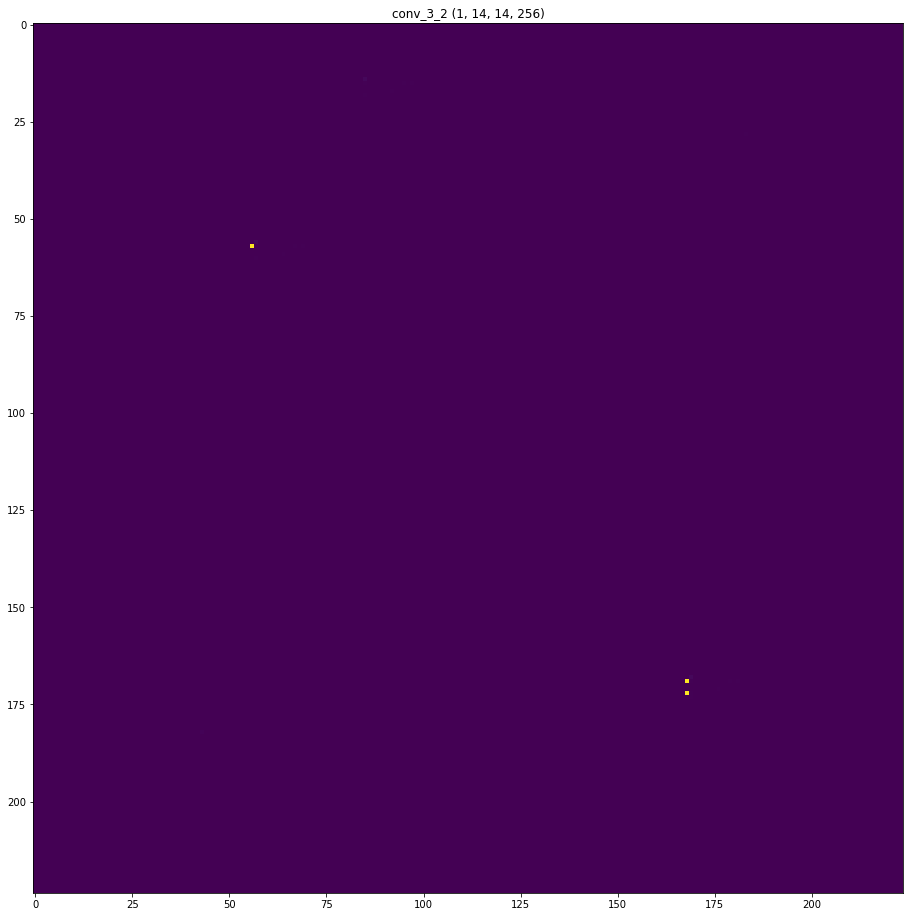

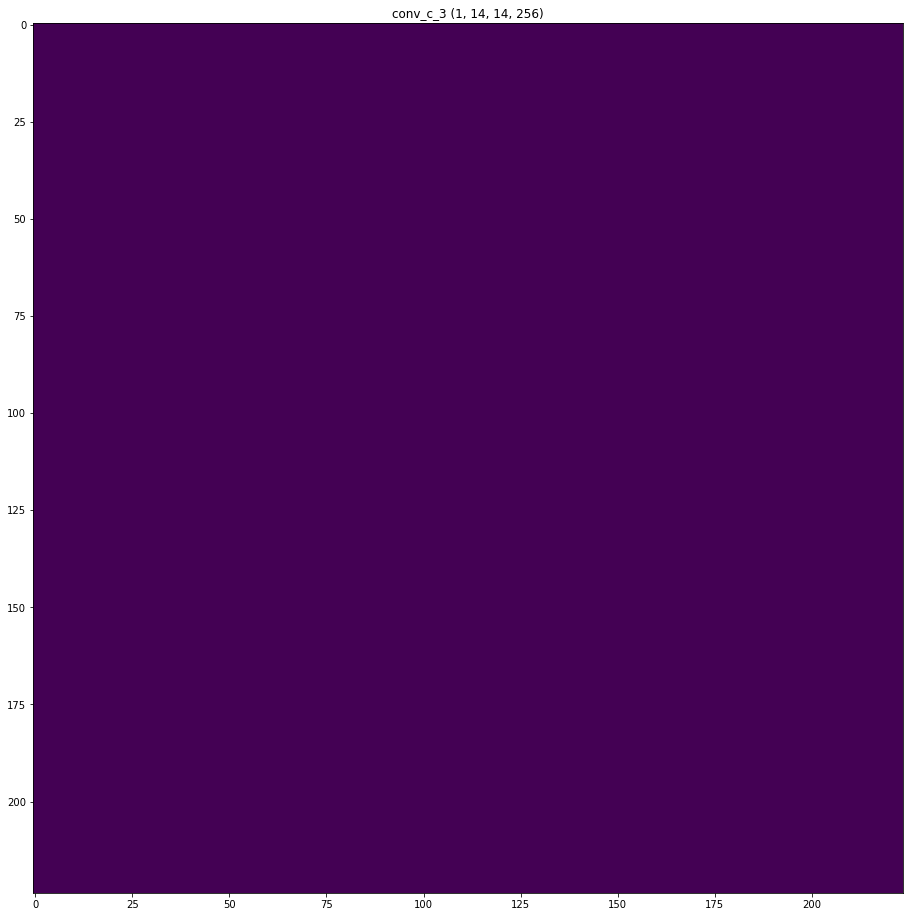

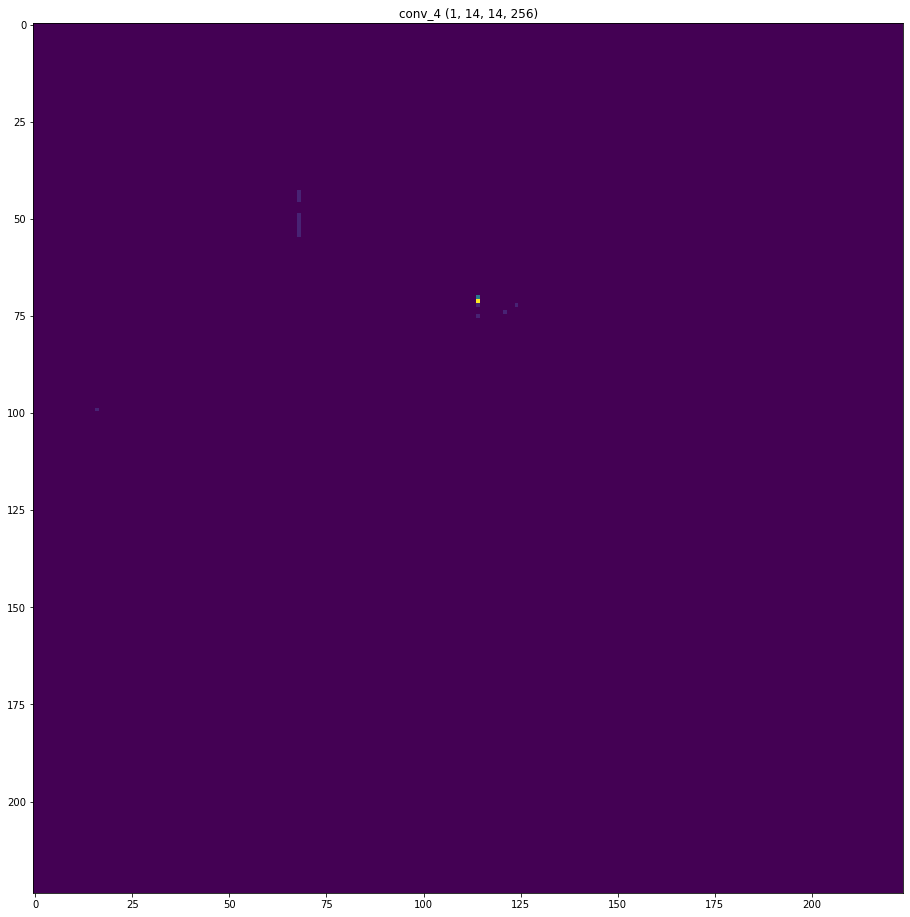

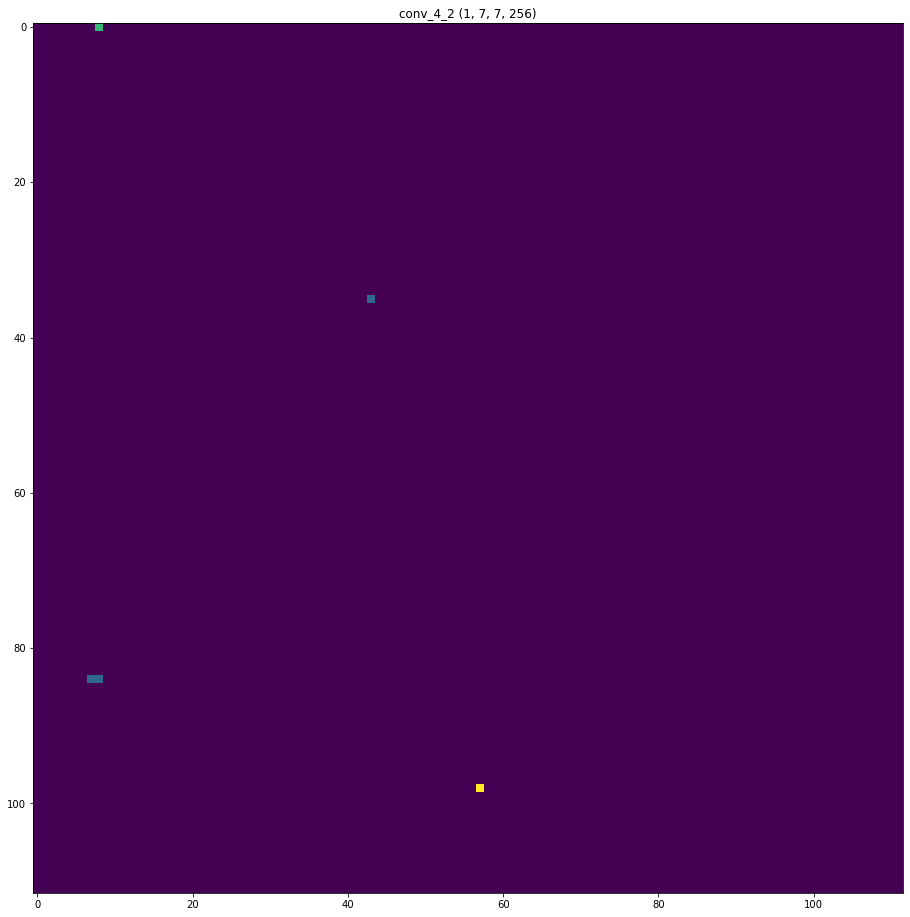

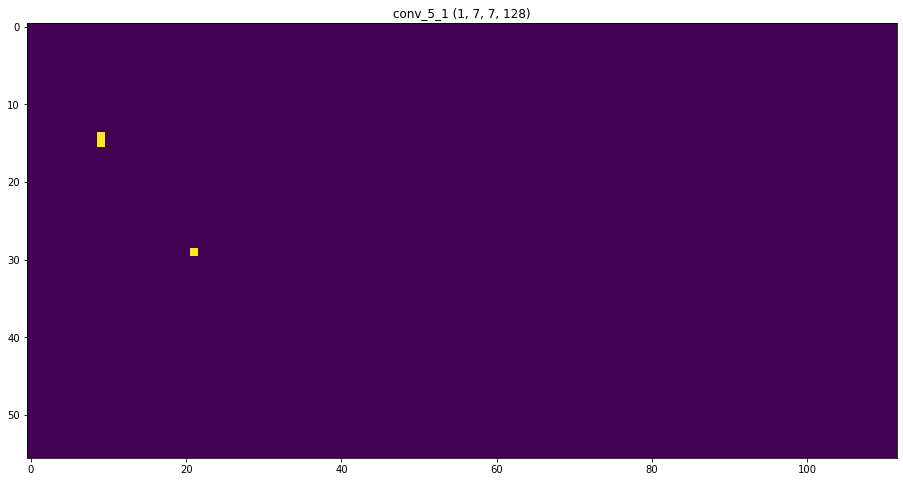

In [130]:
idx_file = 0
input_audio = list_files[[idx_file],:,:,:] #list_files[:1]
print("******** " + list_names[idx_file] + " ********")
plt.imshow(list_images[idx_file])
print("**********************************")
print_file_activations(input_audio)

******** smooth_spectrum_audio ********
**********************************
(1, 112, 112, 64)
***** Input features *****


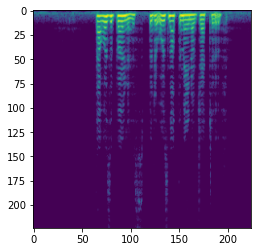

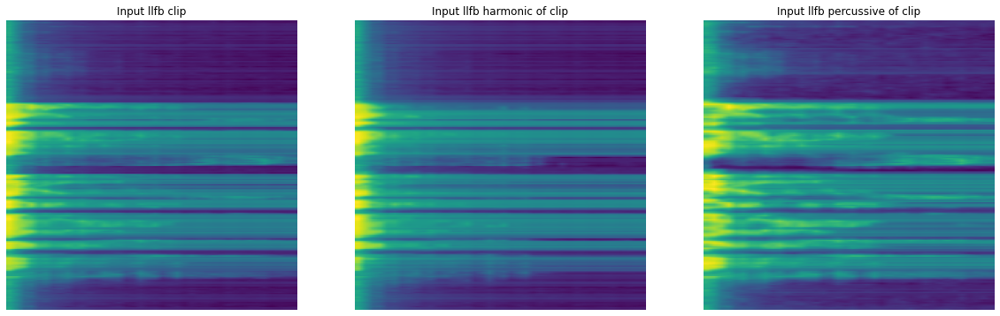

***** Successive Layers Activations *****


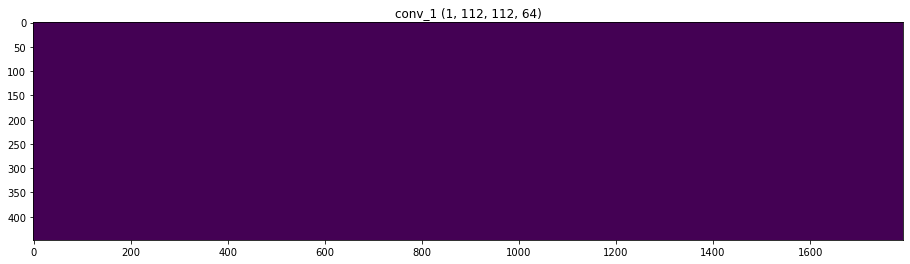

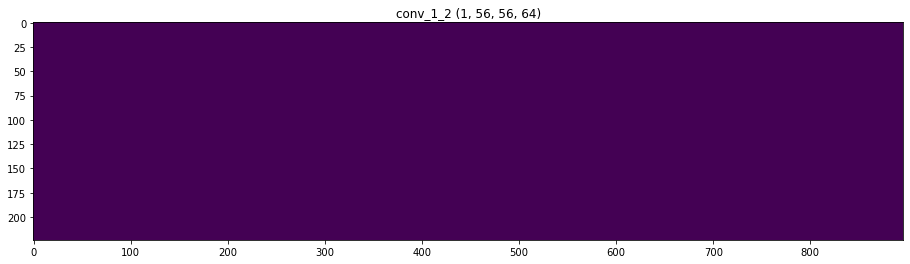

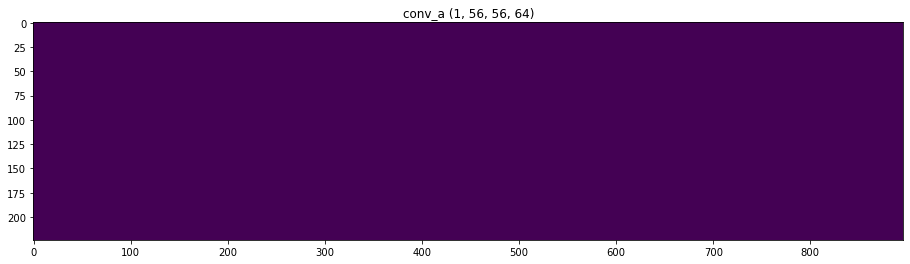

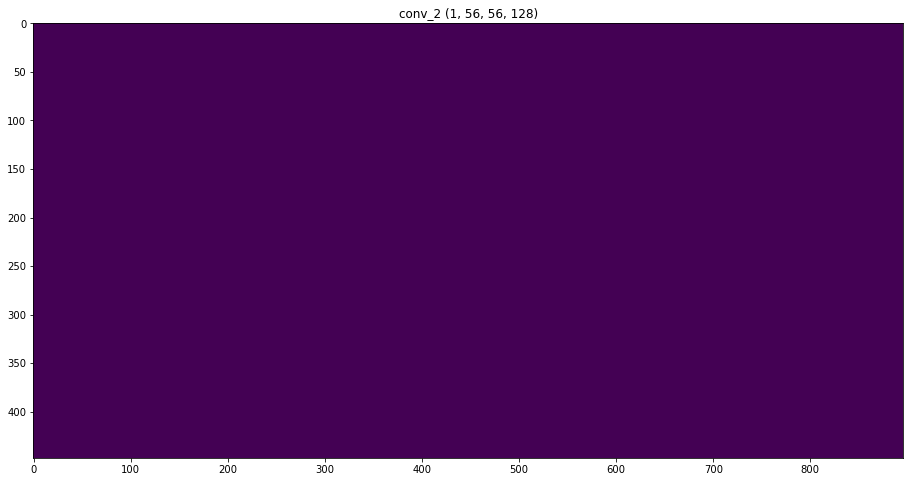

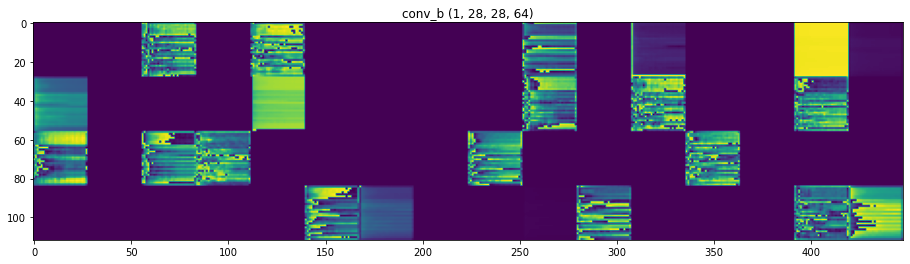

...

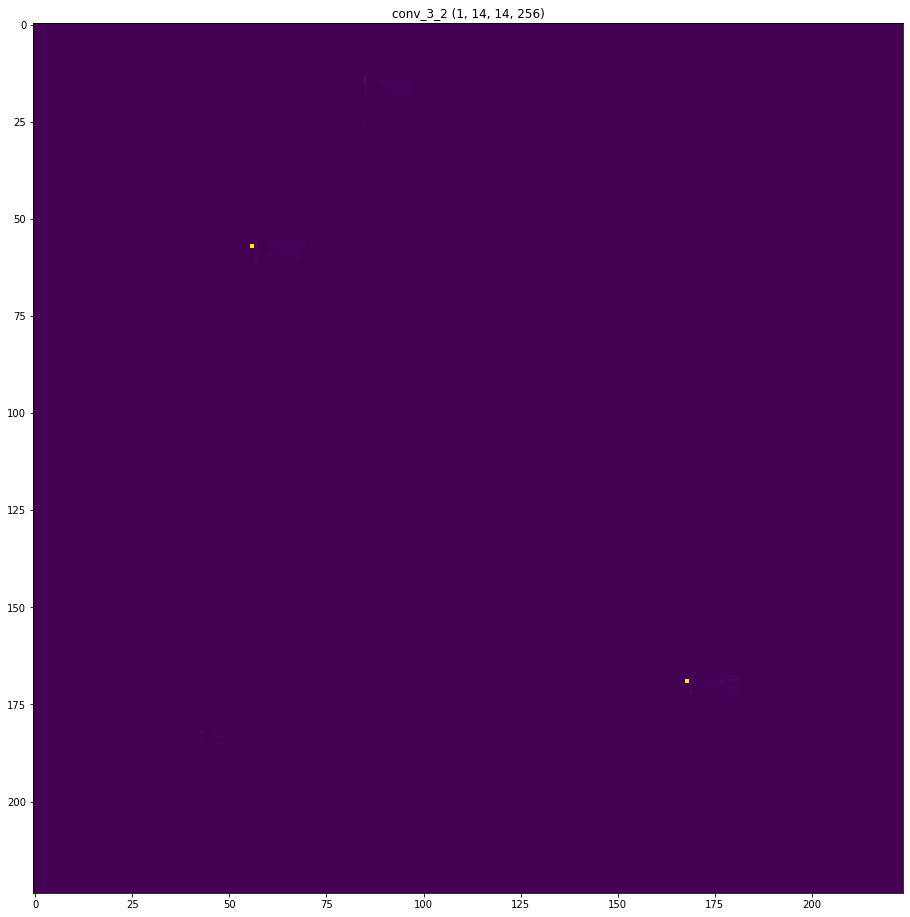

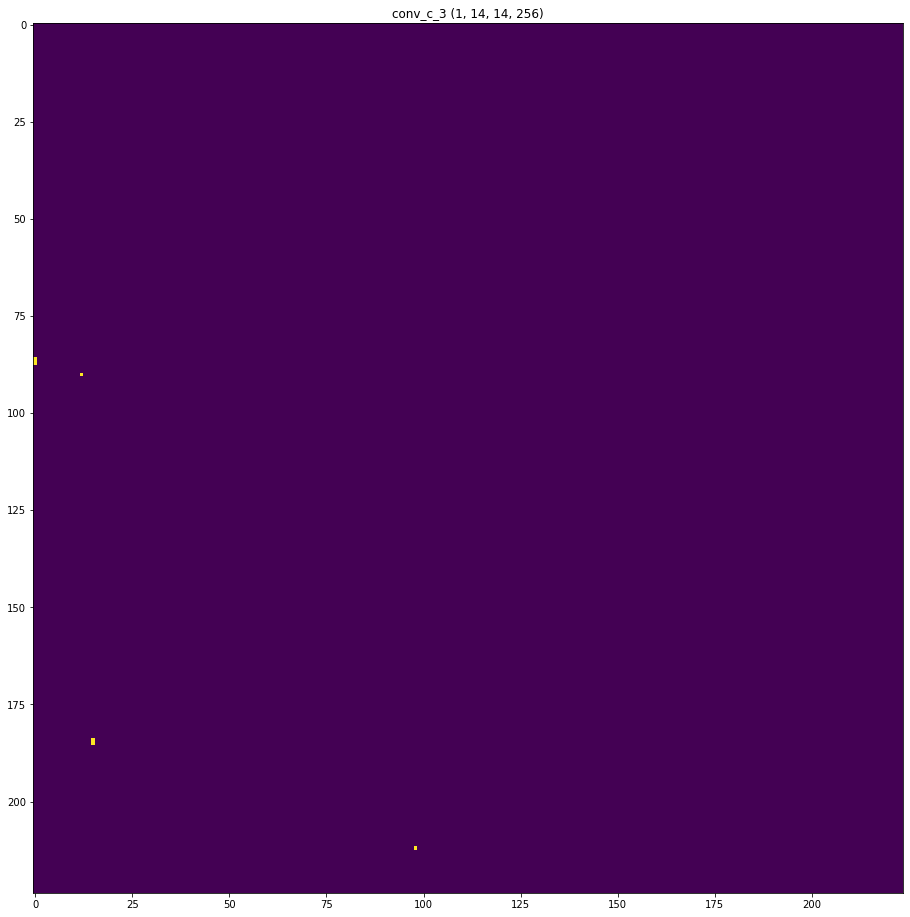

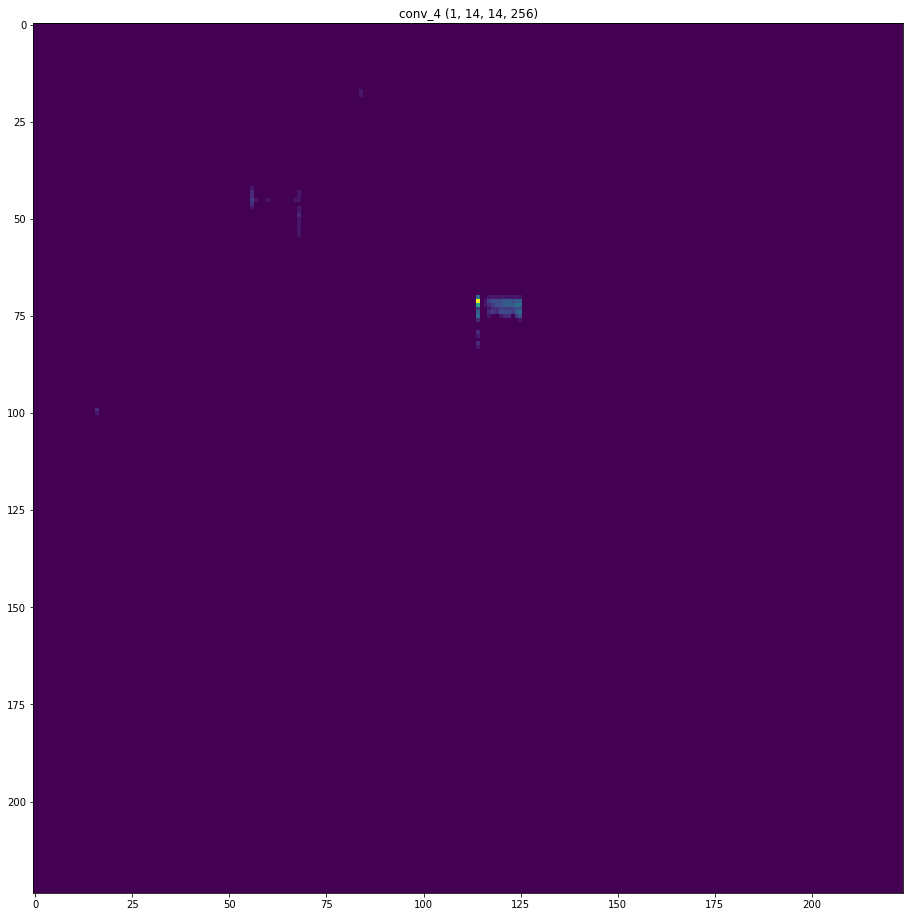

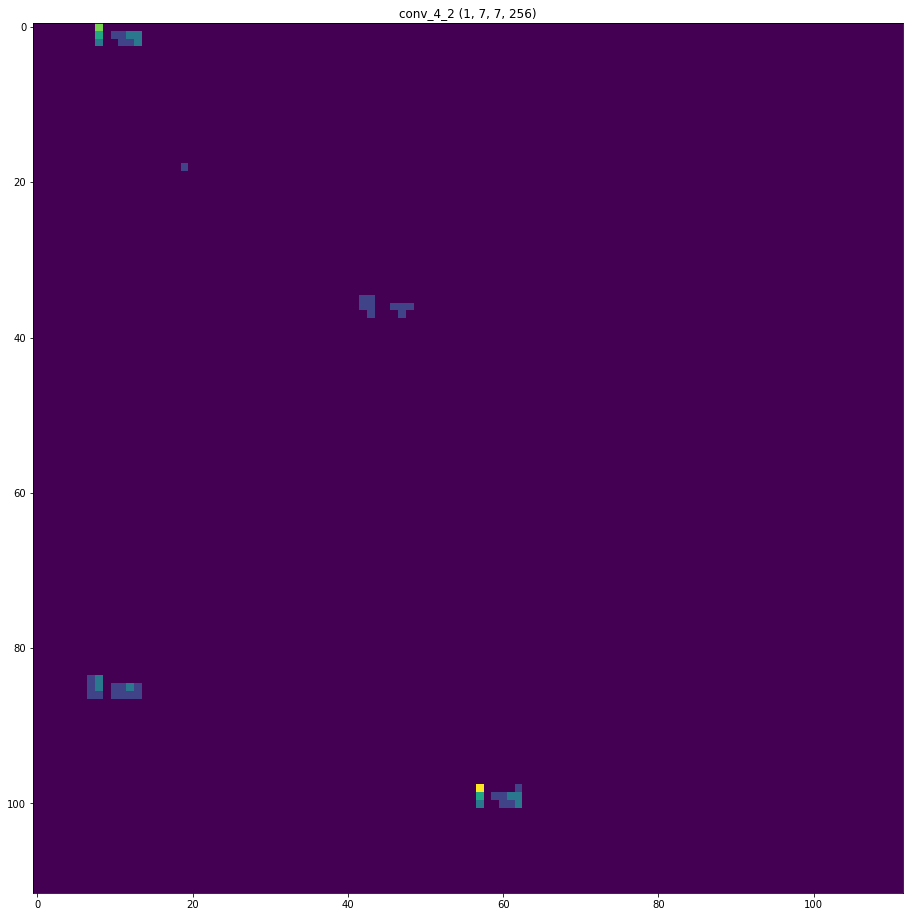

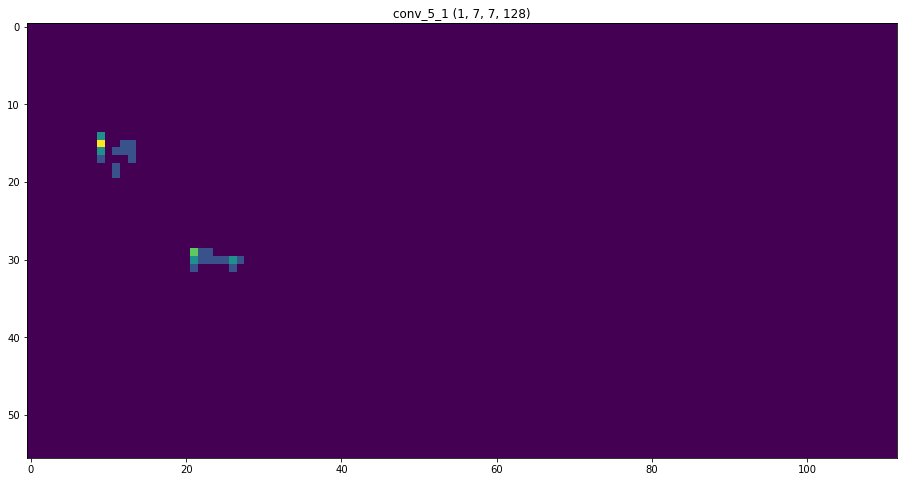

In [132]:
idx_file = 2
input_audio = list_files[[idx_file],:,:,:] #list_files[:1]
print("******** " + list_names[idx_file] + " ********")
plt.imshow(list_images[idx_file])
print("**********************************")
print_file_activations(input_audio)

### Misclassified samples

******** add_pinknoise ********
**********************************
(1, 112, 112, 64)
***** Input features *****


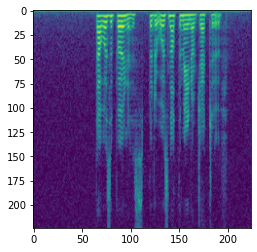

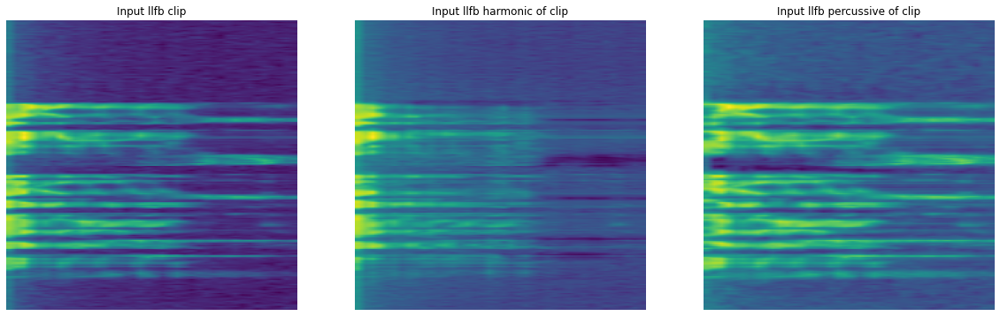

***** Successive Layers Activations *****


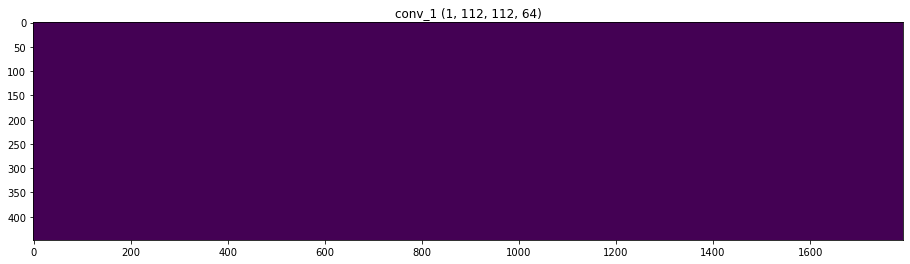

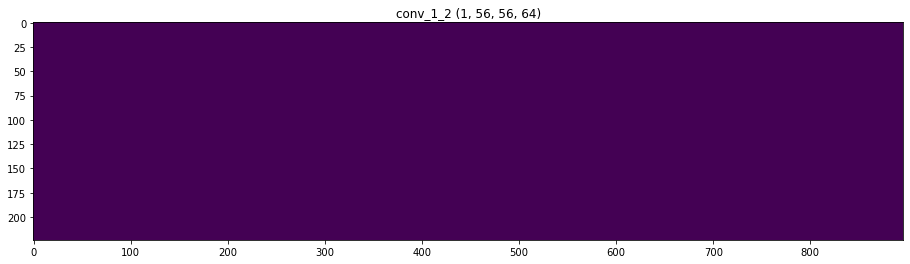

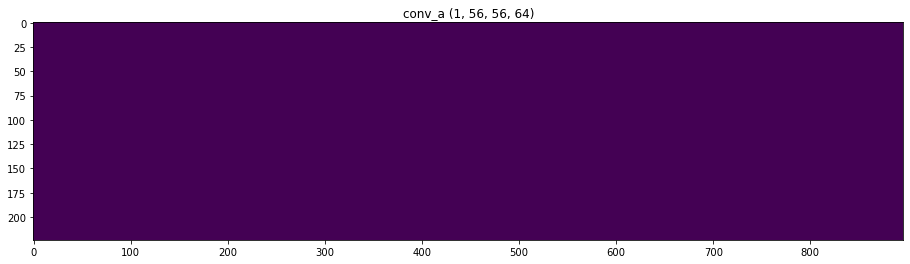

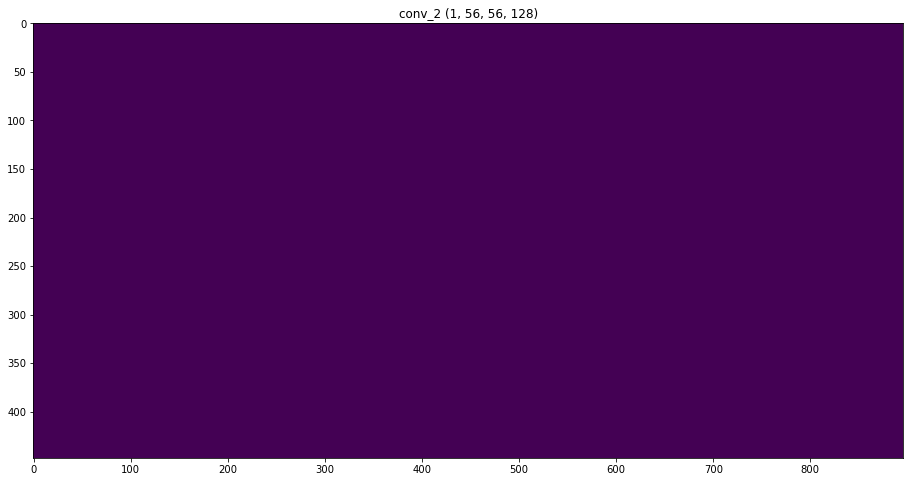

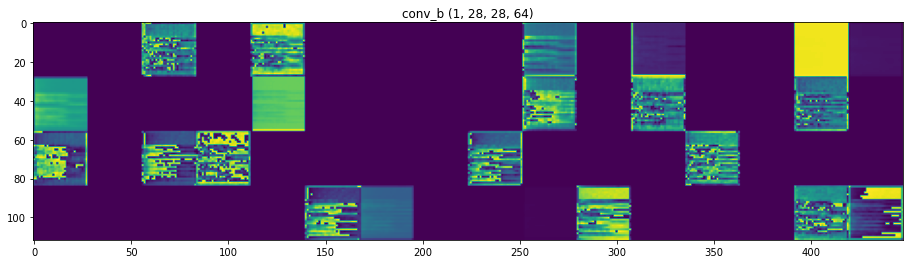

...

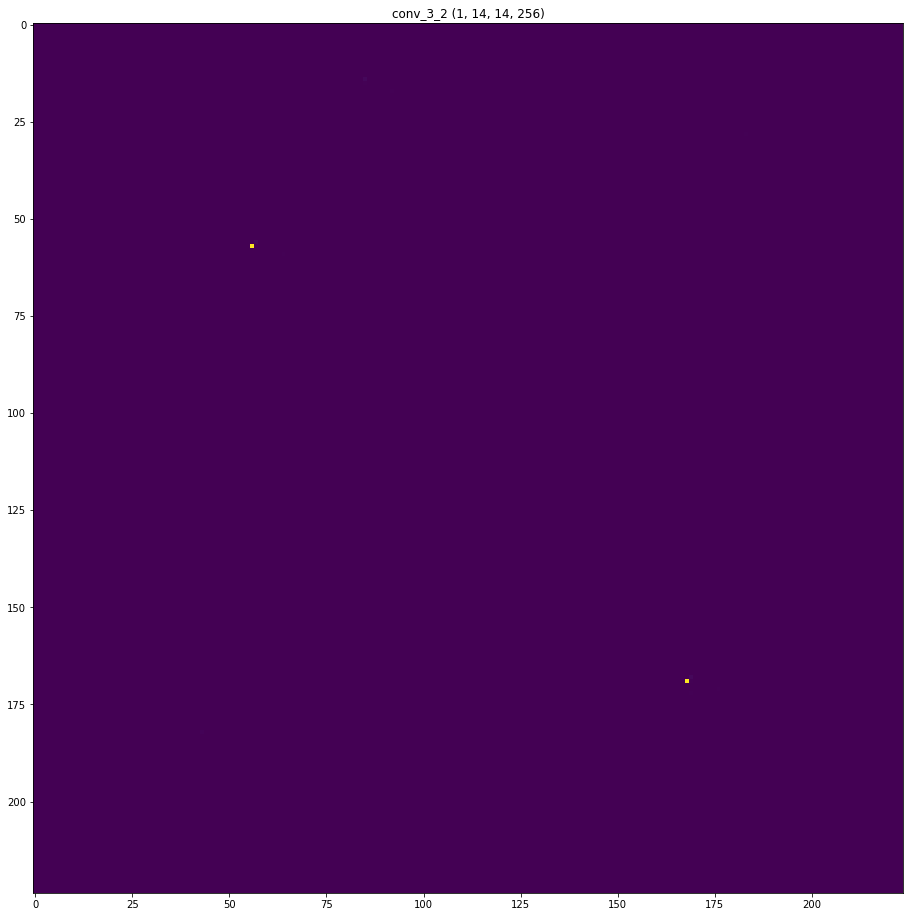

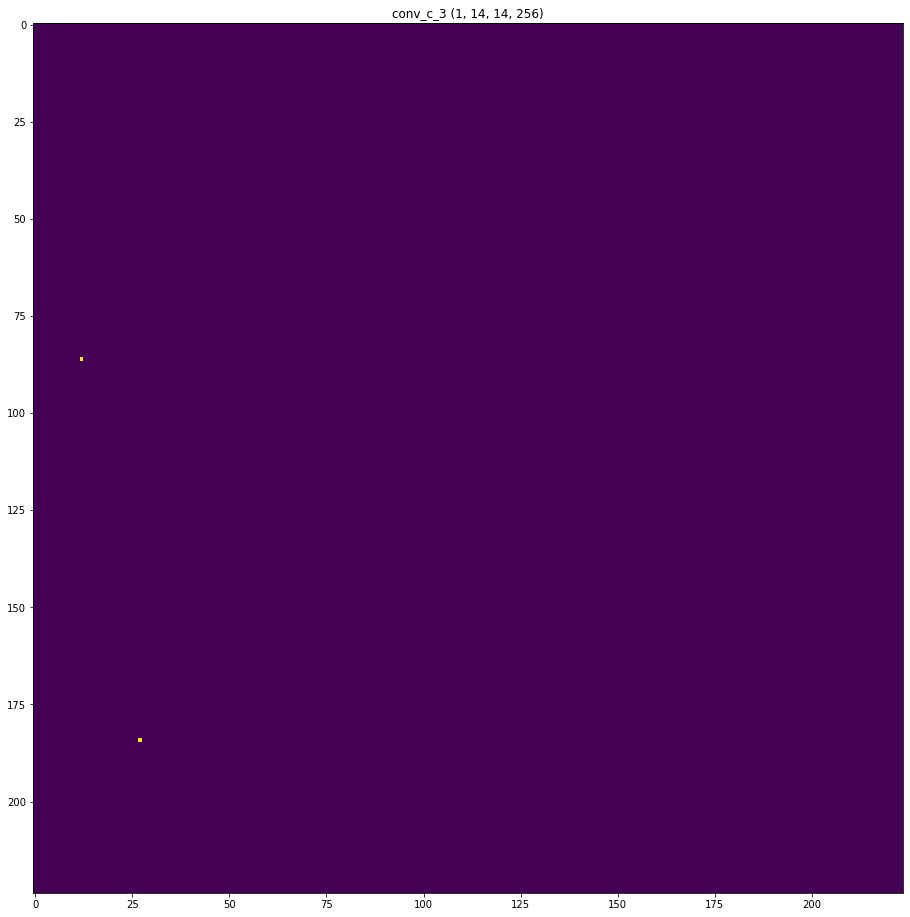

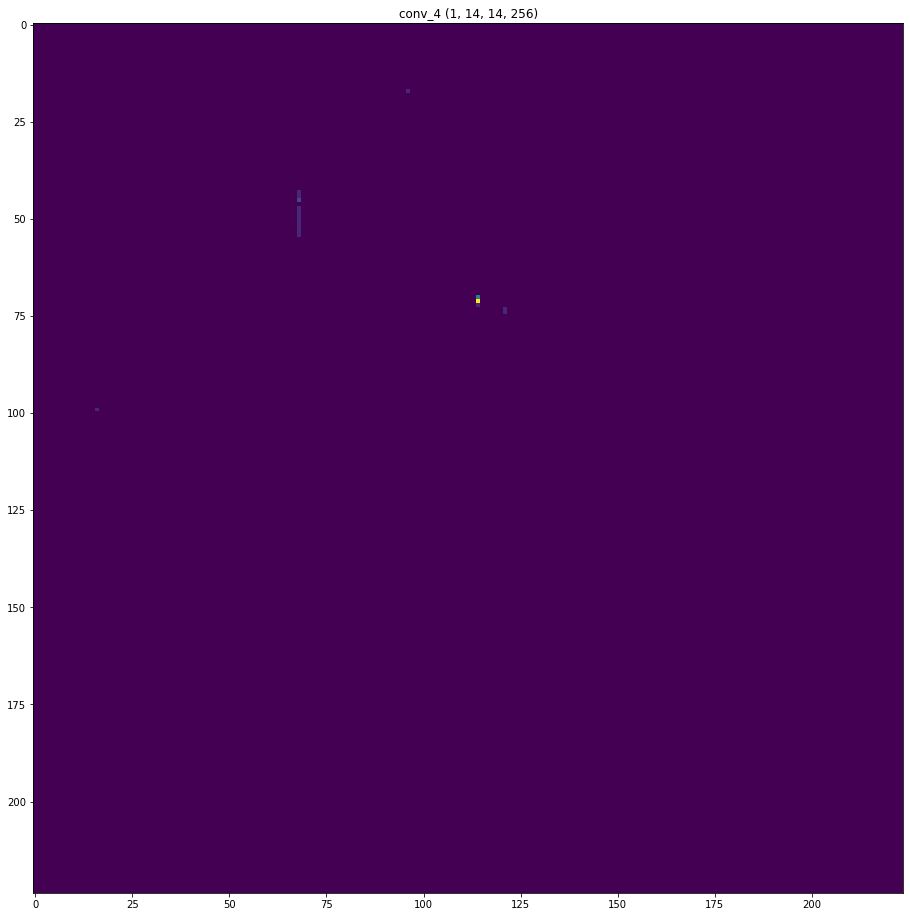

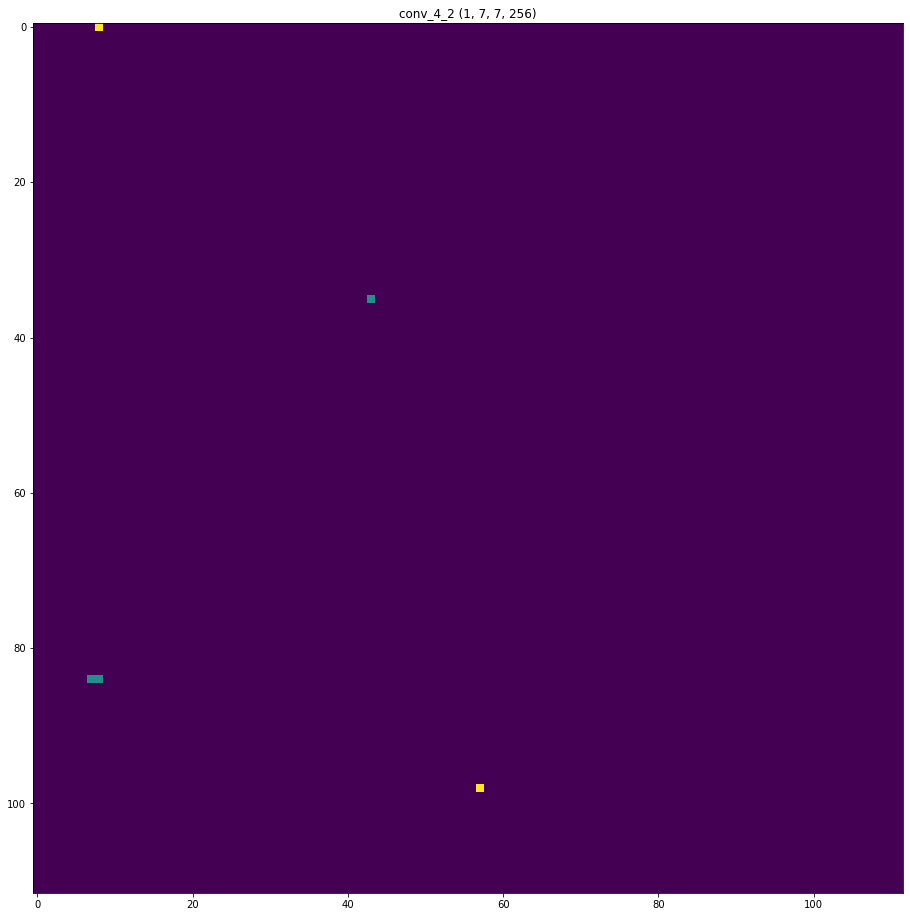

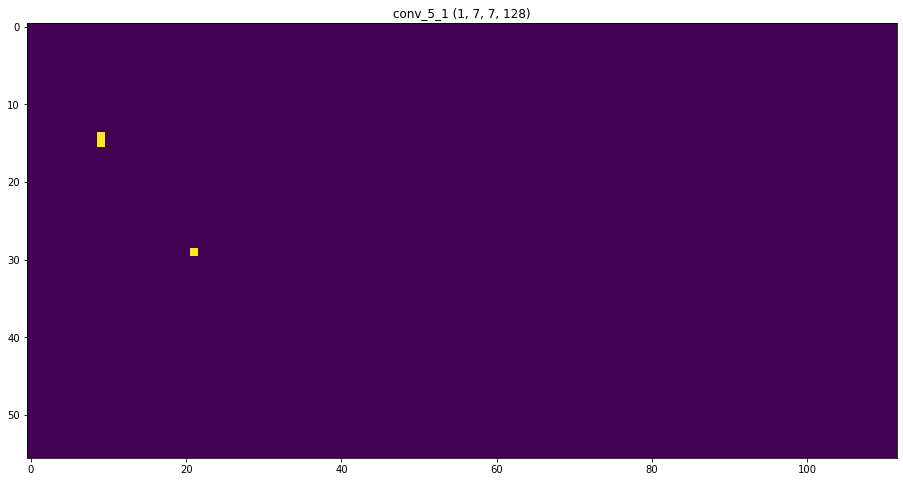

In [143]:
idx_file = 1
input_audio = list_files_misclassified[[idx_file],:,:,:] #list_files[:1]
print("******** " + list_names_misclassified[idx_file] + " ********")
plt.imshow(list_images_misclassified[idx_file])
print("**********************************")
print_file_activations(input_audio)

******** time_stretch_audio ********
**********************************
(1, 112, 112, 64)
***** Input features *****


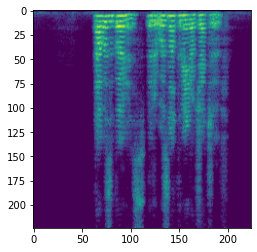

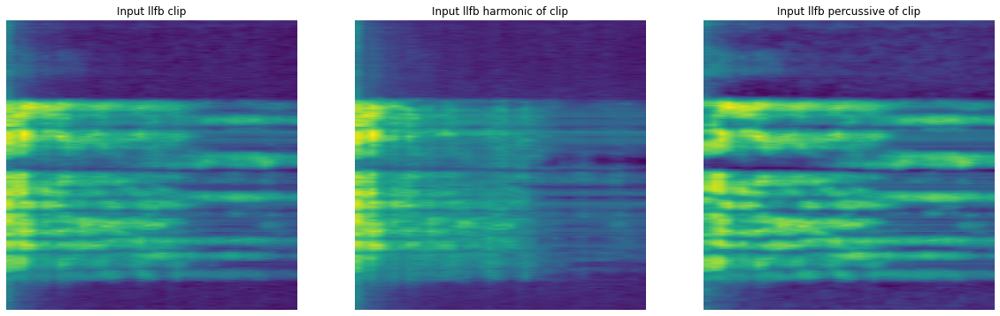

***** Successive Layers Activations *****


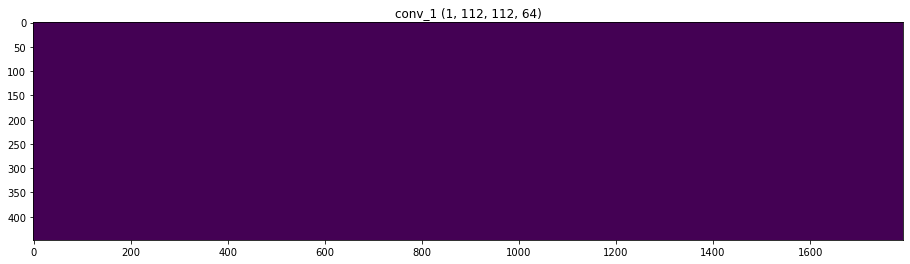

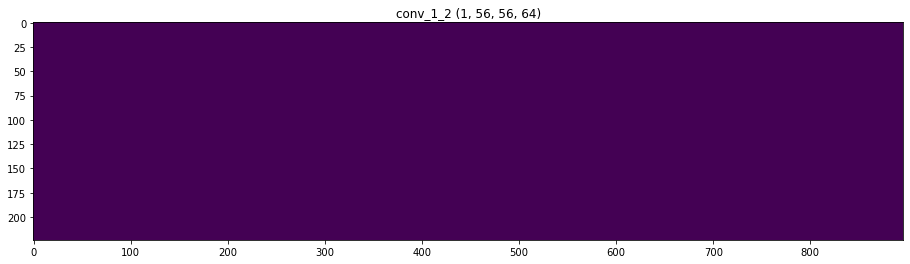

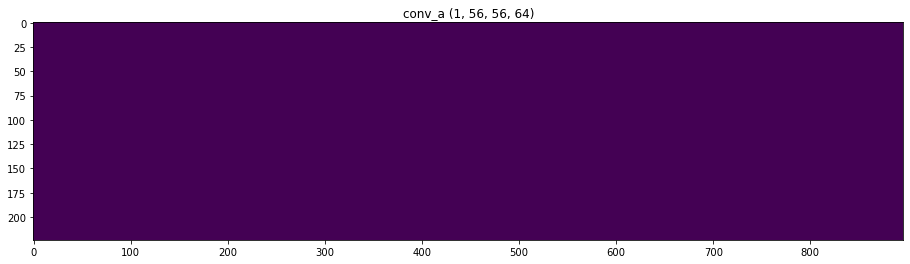

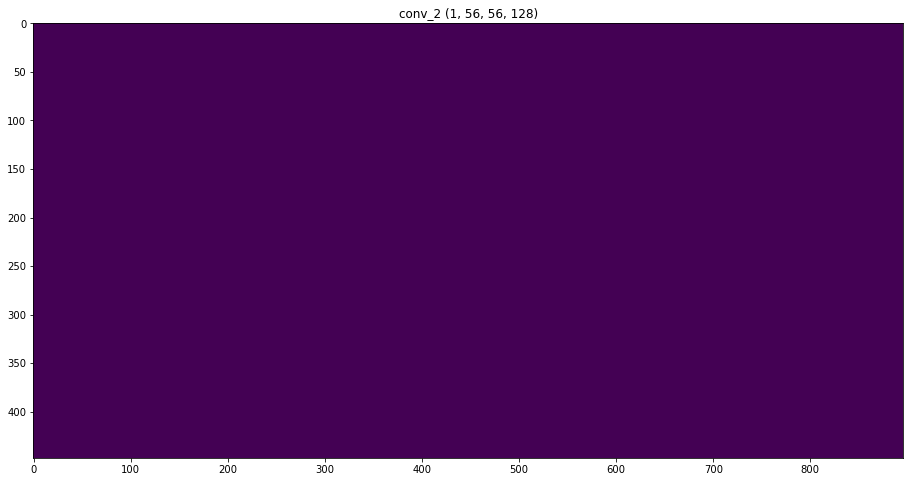

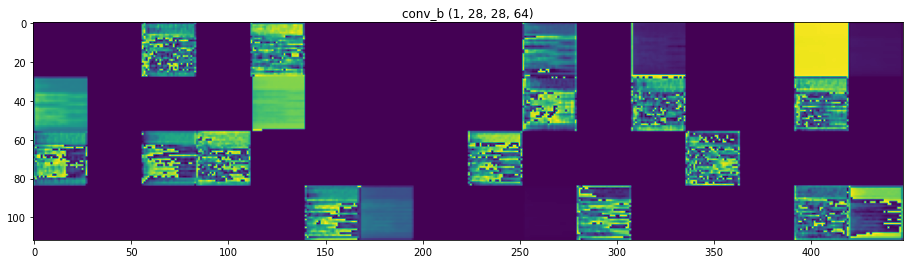

...

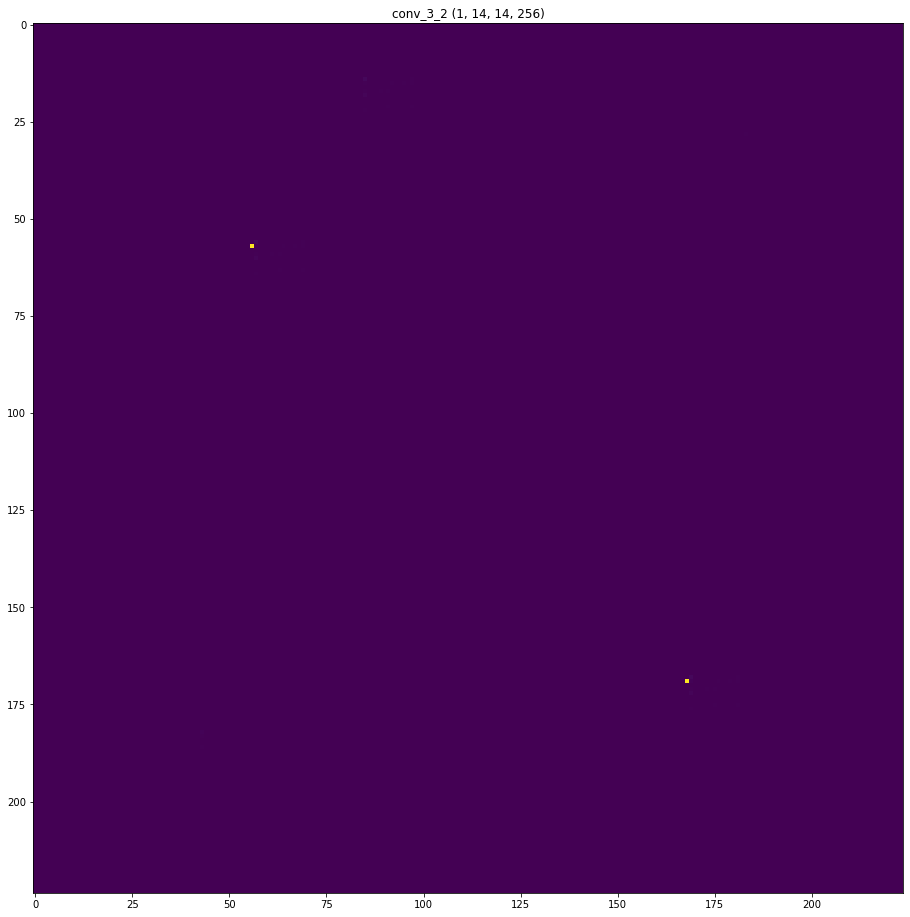

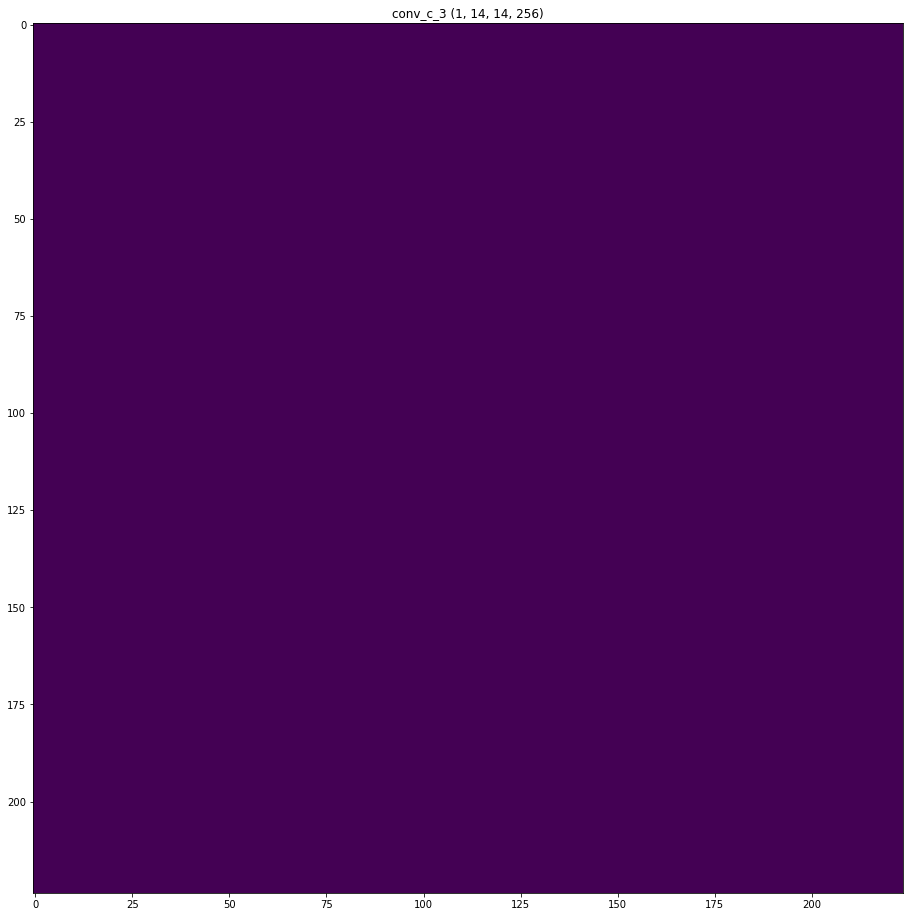

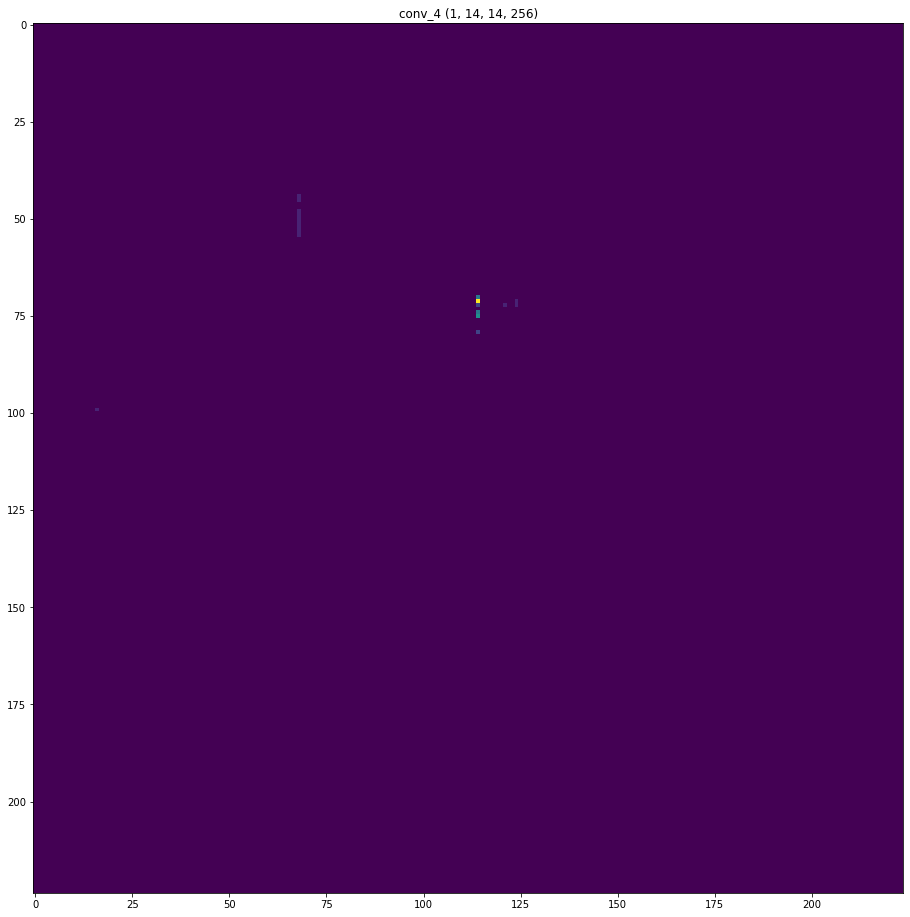

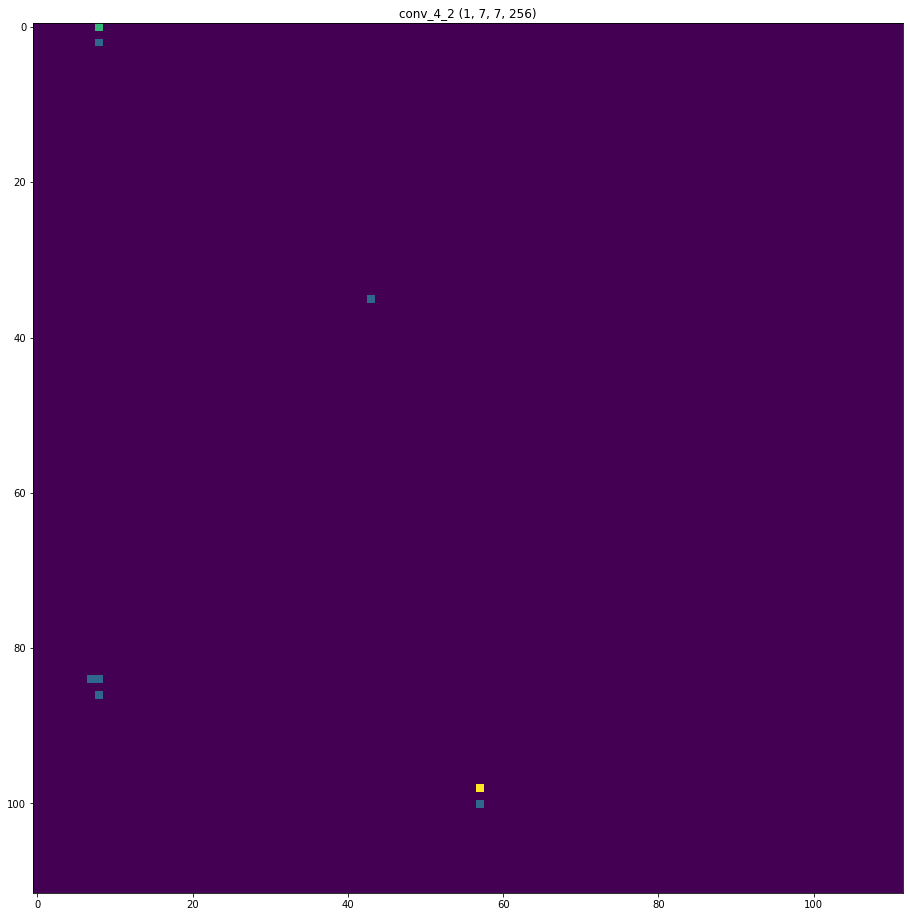

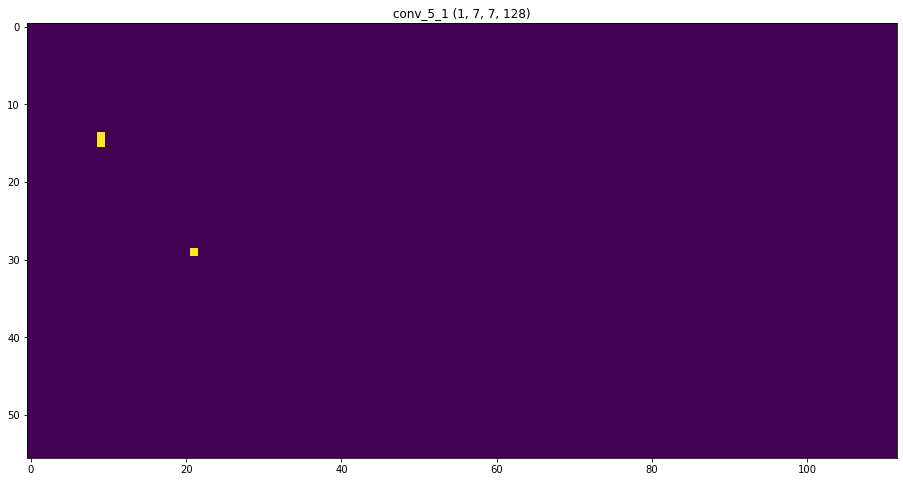

In [144]:
idx_file = 2
input_audio = list_files_misclassified[[idx_file],:,:,:] #list_files[:1]
print("******** " + list_names_misclassified[idx_file] + " ********")
plt.imshow(list_images_misclassified[idx_file])
print("**********************************")
print_file_activations(input_audio)